In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import warnings
import itertools
import matplotlib

import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt

from pylab import rcParams
from wordcloud import WordCloud

warnings.filterwarnings("ignore")

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
# Kenyan_Tweets = pd.read_csv('/content/drive/My Drive/Final/Edited Data/Key Data /KenyanTweets.csv', engine ='python')
# Kenyan_Tweets['number'] = 1
# Nigerian_Tweets = pd.read_csv('/content/drive/My Drive/Final/Edited Data/Key Data /NigerianTweets.csv', engine ='python')
# Nigerian_Tweets['number'] = 1
# South_African_Tweets = pd.read_csv('/content/drive/My Drive/Final/Edited Data/Key Data /SouthAfricanTweets.csv', engine ='python')
# South_African_Tweets['number'] = 1

Kenyan_Users = pd.read_csv('/content/drive/My Drive/Copy of Kenyan_User_Categories.csv', engine ='python')
Nigerian_Users = pd.read_csv('/content/drive/My Drive/Copy of Nigerian_User_Categories.csv', engine ='python')
South_African_Users = pd.read_csv('/content/drive/My Drive/Copy of South_African_User_Categories.csv', engine ='python')


In [ ]:
class Automation:
    """
    The PEP8 Standard AMAZING!!!
    """
    def __init__(self):
        print('Automation in Action...!!!')

    def Clean_Tweets(self, df):
        # drop na in clean tweets column
        a = df[df['retweet_count'] == 'retweet_count' ].index
        df.drop(a , inplace=True)
        # dropduplicates and drop duplicates in clean tweets
        df = df.drop_duplicates().drop_duplicates(subset='clean_text')
        # convert int column appropriately
        df = df[df['polarity'] != 'polarity']
        # convert the created_at column to a datetime object
        df['created_at'] = pd.to_datetime(df['created_at'], errors='coerce')
        df['created_at'] = df['created_at'].dt.strftime('%Y-%m-%d')
        df = df[df['created_at'] >= '2019-01-01' ]
        # convert int column appropriately
        df['polarity'] = pd.to_numeric(df['polarity'], errors='coerce')
        df['subjectivity'] = pd.to_numeric(df['subjectivity'], errors='coerce')
        df['retweet_count'] = pd.to_numeric(df['retweet_count'], errors='coerce')
        df['favorite_count'] = pd.to_numeric(df['favorite_count'], errors='coerce')
        df
        return df

    def Time_Trend(self, df, column):
        ax = df.groupby('created_at')[[column]].sum().plot(figsize=(10,8))
        plt.title(f'Trend of likes and retweets for {column}', size=20)
        plt.ylabel('Frequency', fontsize=14)
        plt.xlabel('Time', fontsize=14)
        plt.xticks(rotation=45)
        plt.show()
        
    def Draw_Wordcloud(self, tweets_series, country):
        # word cloud visualization
        allWords = ' '.join([twts for twts in tweets_series])
        wordCloud = WordCloud(width=500, height=300, random_state=21, max_font_size=150).generate(allWords)
        plt.figure(figsize=(12, 9))
        plt.imshow(wordCloud, interpolation="bilinear")
        plt.axis('off')
        plt.title(f'Most used words describing Food Quatity in {country}', size=20)
        plt.show()
        

In [ ]:
Auto = Automation()

Automation in Action...!!!


## **Overall Change Point Analysis**

In [ ]:
matplotlib.rcParams['axes.labelsize'] = 20
matplotlib.rcParams['xtick.labelsize'] = 18
matplotlib.rcParams['ytick.labelsize'] = 18
matplotlib.rcParams['text.color'] = 'k'

In [ ]:
Food_Keywords = ['food', 'foodstuffs', 'foodstuff', 'grocery','starvation', 'hungry', 'starving', 'hunger']
Covid_Keywords = ['covid','corona','pandemic']

## **Kenya**

In [ ]:
Kenyan_Tweets = Auto.Clean_Tweets(Kenyan_Tweets)
print(Kenyan_Tweets.shape)

# Filter Based on Food Keywords

Kenyan_Food_Tweets = Kenyan_Tweets[Kenyan_Tweets['original_text'].str.lower().str.contains('|'.join(Food_Keywords))]

Kenyan_Food_Tweets.shape


(400213, 18)


(15047, 18)

### **Let us first take note of the trend before Covid in Kenya**

We forecast the trend using Autoregressive Integrated Moving Average

In [ ]:
Pre_Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

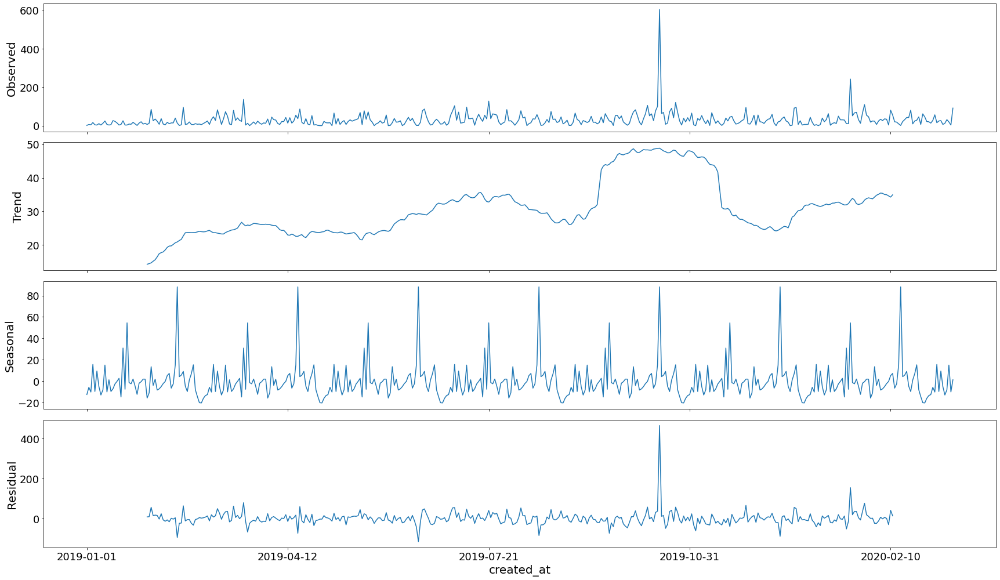

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4571.645285580174
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4402.13018322828
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4521.01348332057
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4176.621644180586
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4389.398892810106
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4294.29191643752
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4333.077464031304
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4178.352614732525
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4491.730794823886
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4351.873747316782
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4503.864731558908
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4156.453837769603
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4359.541733280456
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4275.197228781876
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4317.207494341594
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4158.3210331415885
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4566.299118128486
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4451.912289907782
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2287      0.038      6.043      0.000       0.155       0.303
ma.L1         -1.0000     12.037     -0.083      0.934     -24.591      22.591
ar.S.L12      -0.4552      0.013    -36.410      0.000      -0.480      -0.431
sigma2      2264.6823   2.73e+04      0.083      0.934   -5.12e+04    5.57e+04


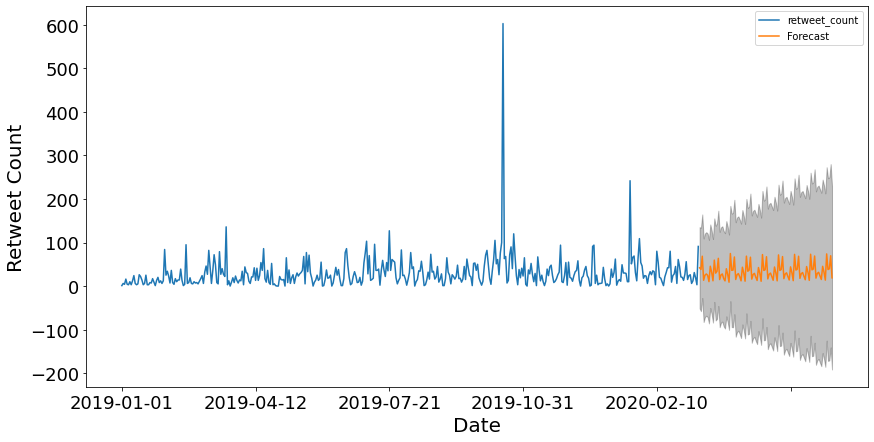

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

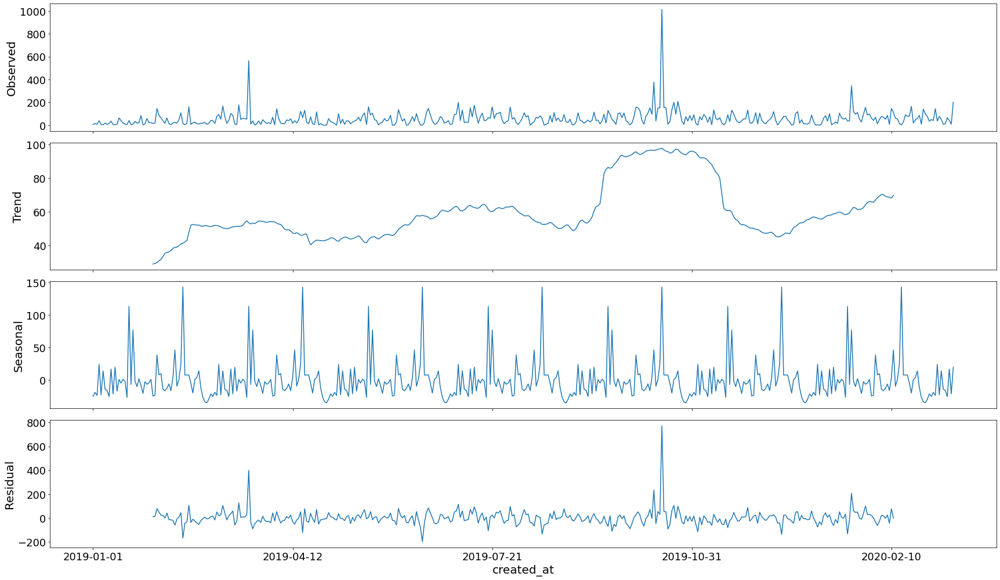

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5122.0689988227905
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4926.239549621549
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5027.767128850044
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4681.673117852892
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4909.675857796305
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4815.356060404217
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4833.8195885040295
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4682.428088491757
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5042.980296457279
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4878.92097001147
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5012.224185004192
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4662.716609579394
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4885.879664212627
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4797.737269556899
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4823.136820700551
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4663.966950653512
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5109.276133377087
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4978.939784744897
ARIMA(0, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1977      0.050      3.943      0.000       0.099       0.296
ma.L1         -1.0000     13.490     -0.074      0.941     -27.440      25.440
ar.S.L12      -0.4333      0.015    -28.053      0.000      -0.464      -0.403
sigma2      7816.0160   1.06e+05      0.074      0.941   -1.99e+05    2.15e+05


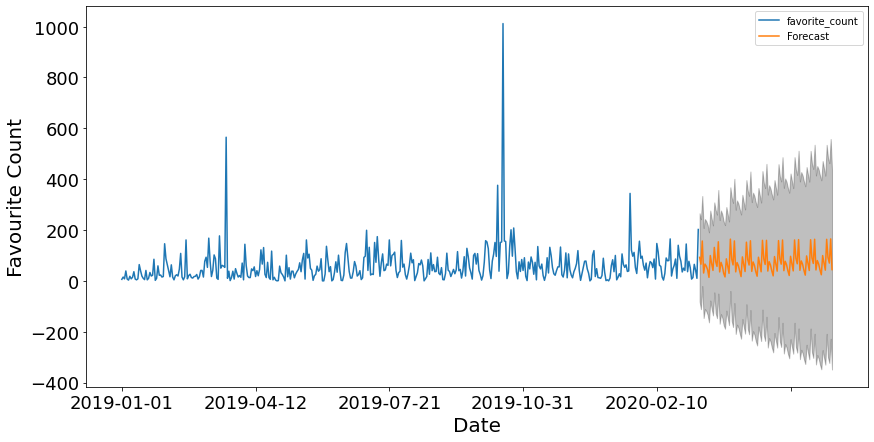

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

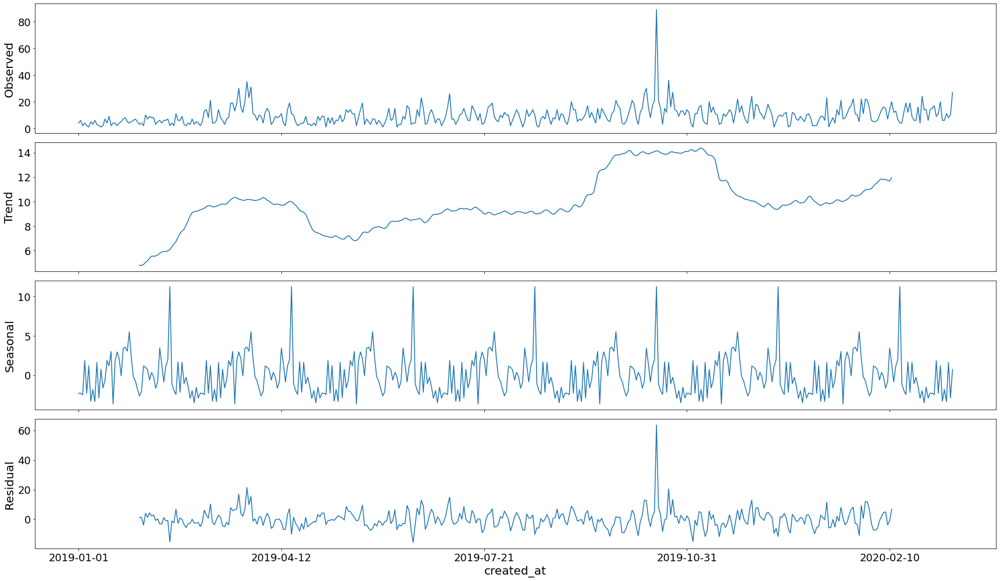

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3370.4626210762244
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3132.21586270978
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:3083.2252197529015
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2809.458298658522
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:3027.6899309622477
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2876.3057062023977
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2954.4198847577168
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2810.82631635333
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3167.3623441311374
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:3020.2968998442357
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:3049.746045250451
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2759.0962590142653
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2974.741012976846
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2829.700606788024
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2904.866282122548
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2761.0805347305495
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:3000.6966615518418
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2928.7809705367195
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3923      0.036     10.933      0.000       0.322       0.463
ma.L1         -1.0000     14.137     -0.071      0.944     -28.709      26.709
ar.S.L12      -0.4641      0.018    -25.482      0.000      -0.500      -0.428
sigma2        69.5567    984.064      0.071      0.944   -1859.173    1998.287


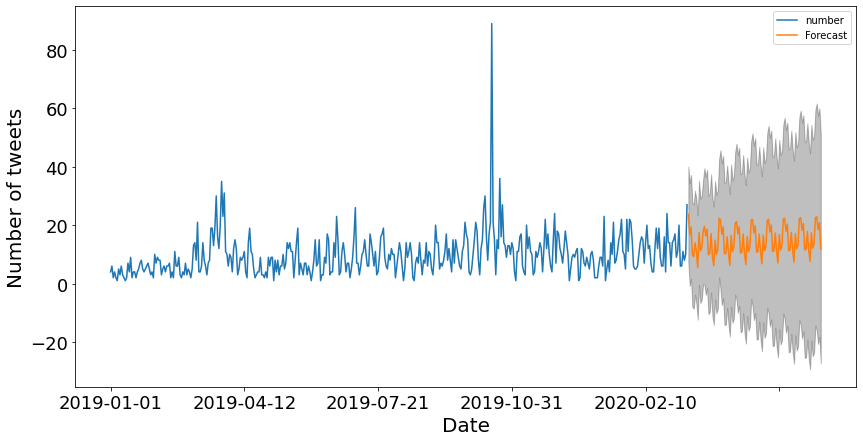

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## **What happened?**

In [ ]:
Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

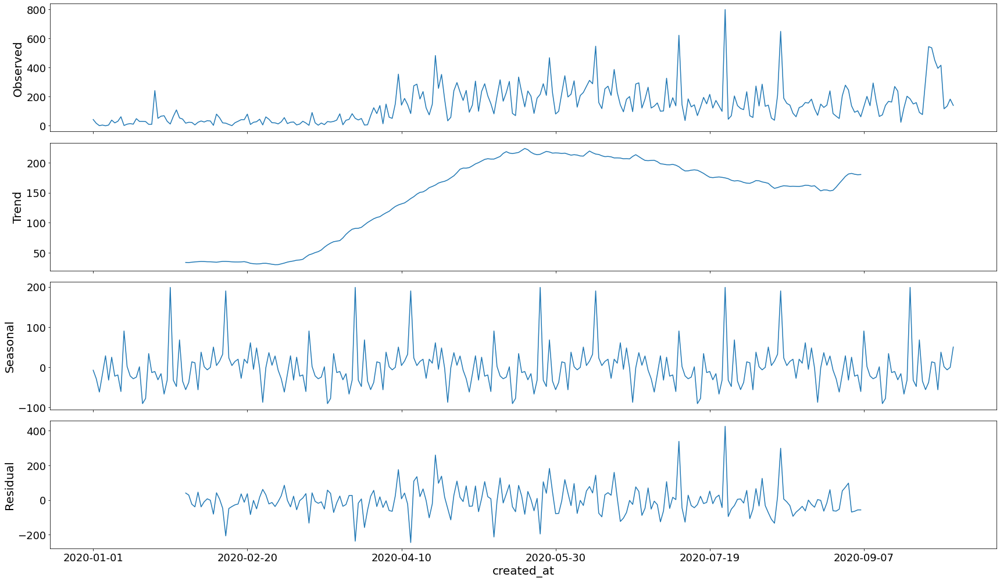

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

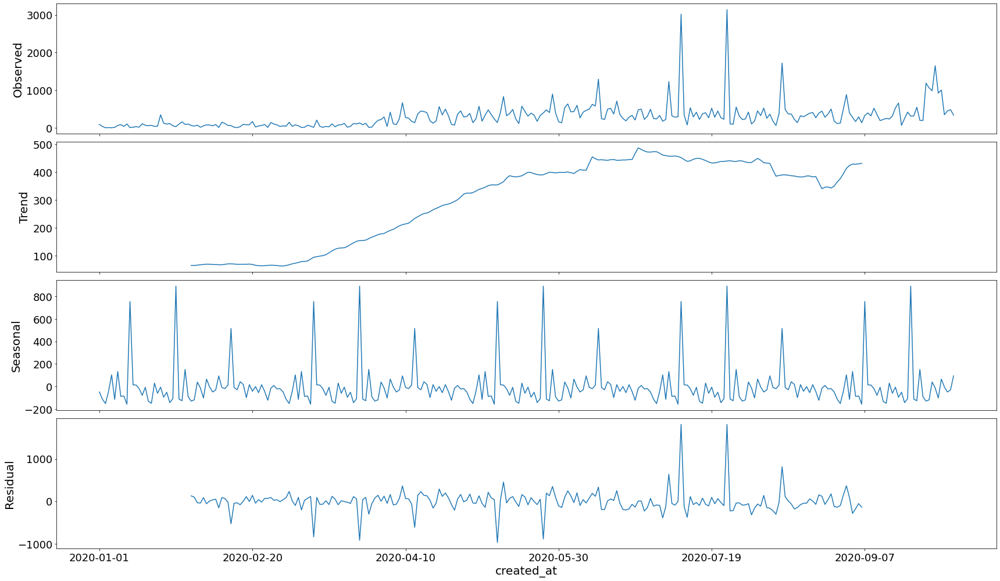

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

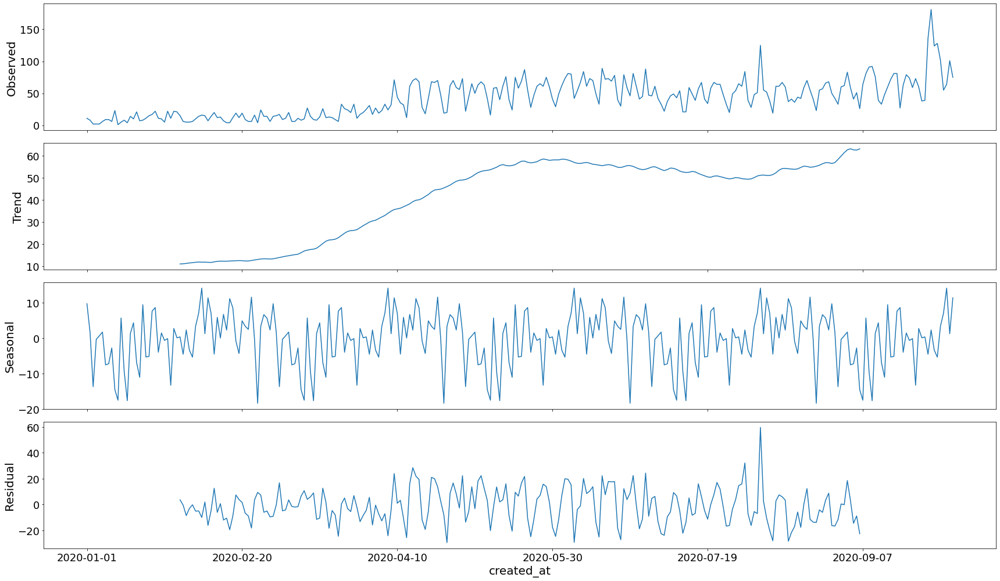

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

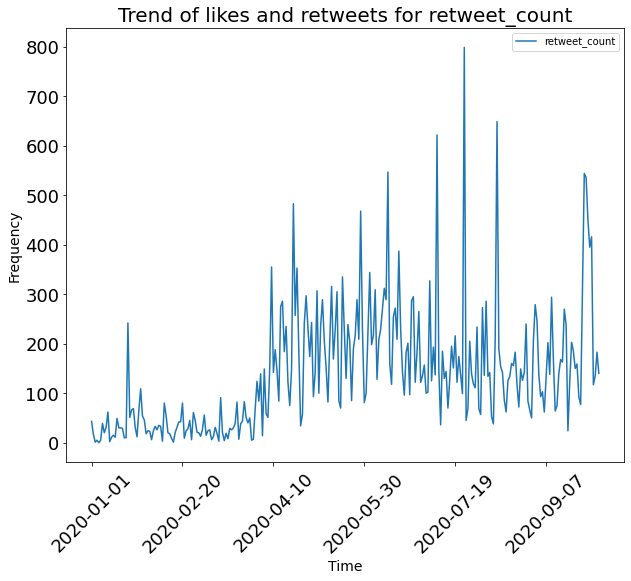

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'retweet_count')

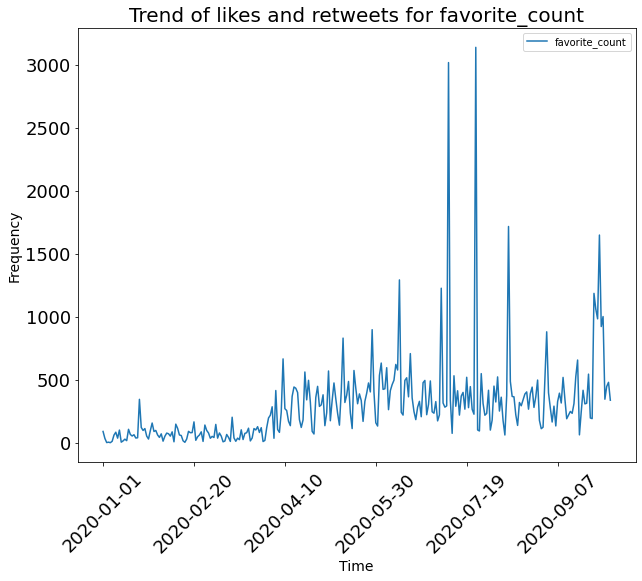

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'favorite_count')

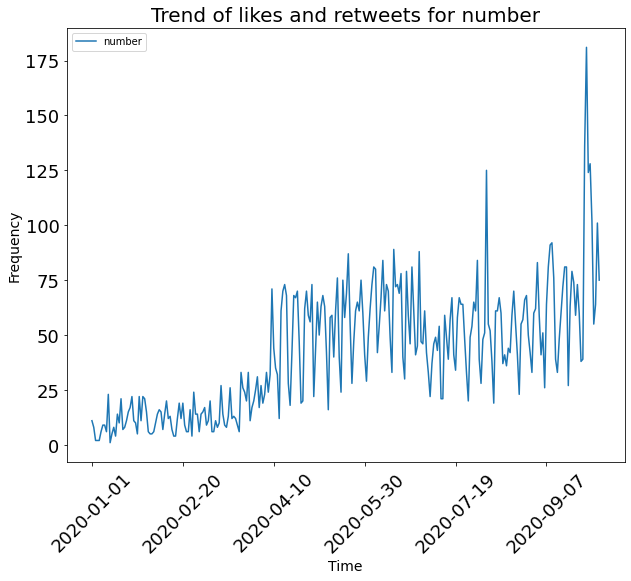

In [ ]:
Auto.Time_Trend(Covid_Number_Kenyan_Food_Tweets_Trend, 'number')

## **Nigeria**

In [ ]:
Nigerian_Tweets = Auto.Clean_Tweets(Nigerian_Tweets)
print(Nigerian_Tweets.shape)

# Filter Based on Food Keywords
Food_Keywords = ['food', 'foodstuffs', 'foodstuff', 'grocery','starvation', 'hungry', 'starving', 'hunger']

Nigerian_Food_Tweets = Nigerian_Tweets[Nigerian_Tweets['original_text'].str.lower().str.contains('|'.join(Food_Keywords))]
Nigerian_Food_Tweets.shape

(891599, 18)


(16156, 18)

## Trend before covid in nigeria

In [ ]:
Pre_Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

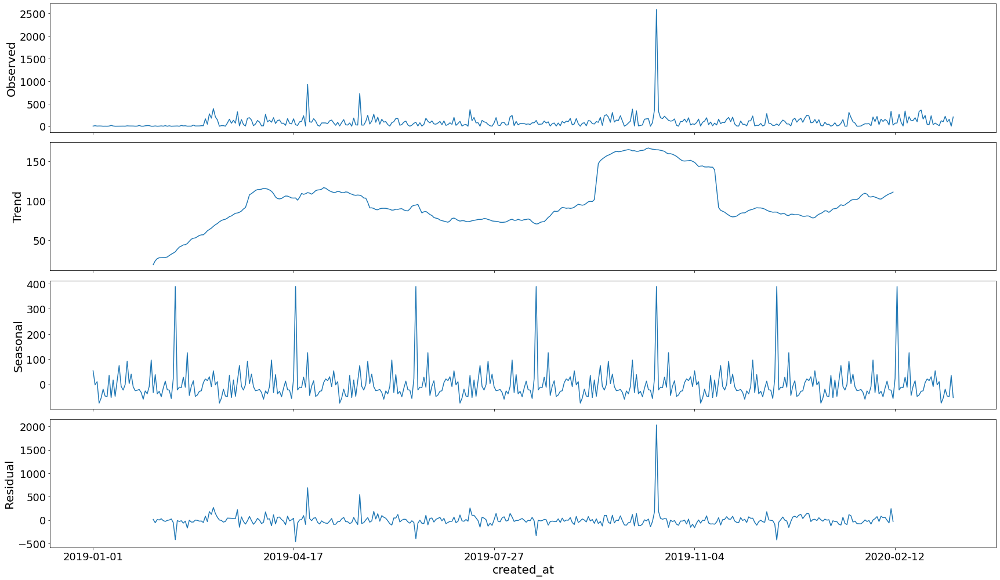

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5675.256135891653
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:5490.256999516585
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5628.8474990274735
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5270.540553505933
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:5484.96199039265
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:5422.776825275524
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:5398.5585750054615
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5271.111377619949
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5617.009443700032
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:5444.629639607583
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5606.372594907508
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5249.504111629978
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:5459.201610254934
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:5401.779050555615
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:5392.446490993771
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5249.895023351433
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5745.315392655524
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:5591.2781341905775
ARIMA(0,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1453      0.078      1.868      0.062      -0.007       0.298
ma.L1         -1.0000      0.018    -55.074      0.000      -1.036      -0.964
ar.S.L12      -0.4515      0.009    -52.588      0.000      -0.468      -0.435
sigma2      3.395e+04   5.34e-07   6.36e+10      0.000     3.4e+04     3.4e+04


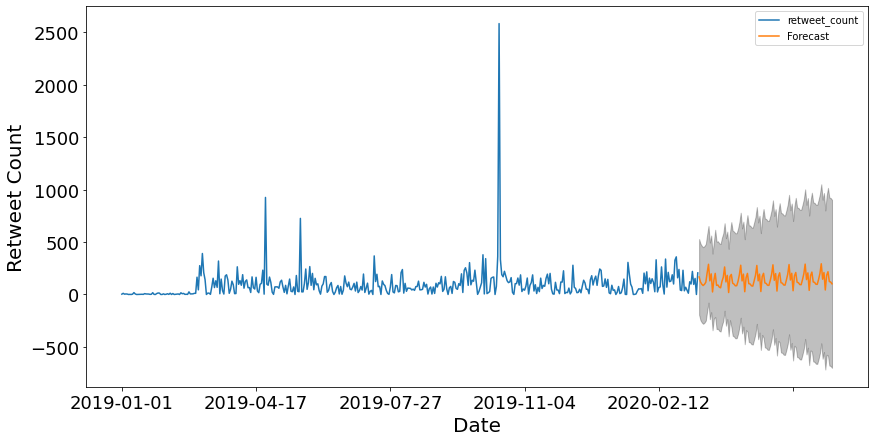

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

This is our forecast of what should happen without covid

## Favourites


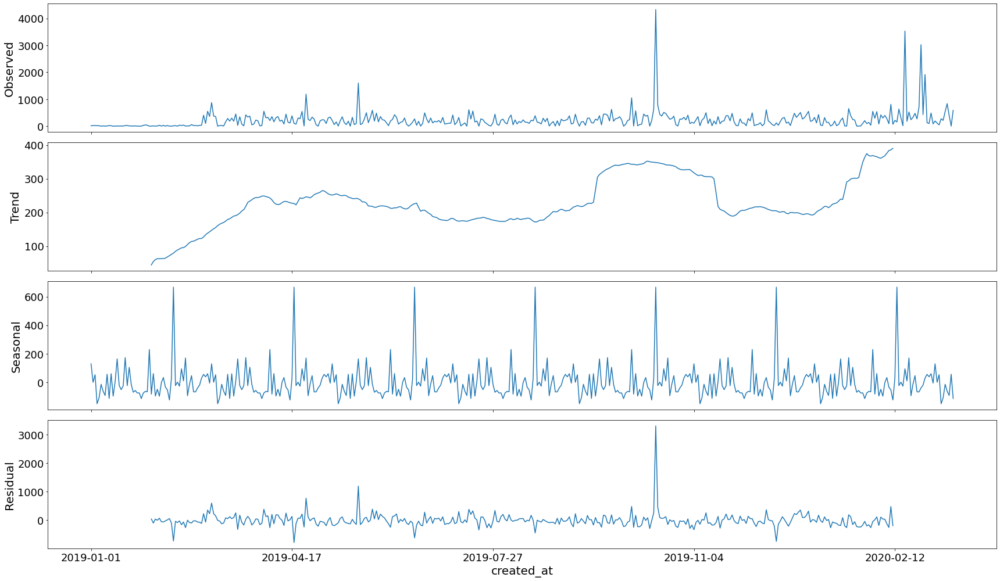

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:6413.89368862538
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:6201.948281900139
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:6324.375702242275
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5937.26162097943
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:6193.490036046263
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:6107.39557189243
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:6055.6379996715805
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5939.252352061809
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:6359.074795082574
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:6164.1512390005755
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:6309.415006634745
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5919.564900493446
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:6178.419054116324
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:6086.778062358402
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:6054.0607022988825
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5921.562354605568
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:6481.704470709523
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:6311.00499193377
ARIMA(0, 1,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1033      0.061      1.695      0.090      -0.016       0.223
ma.L1         -1.0000      0.019    -53.217      0.000      -1.037      -0.963
ar.S.L12      -0.5290      0.012    -43.009      0.000      -0.553      -0.505
sigma2      1.729e+05   1.09e-07   1.59e+12      0.000    1.73e+05    1.73e+05


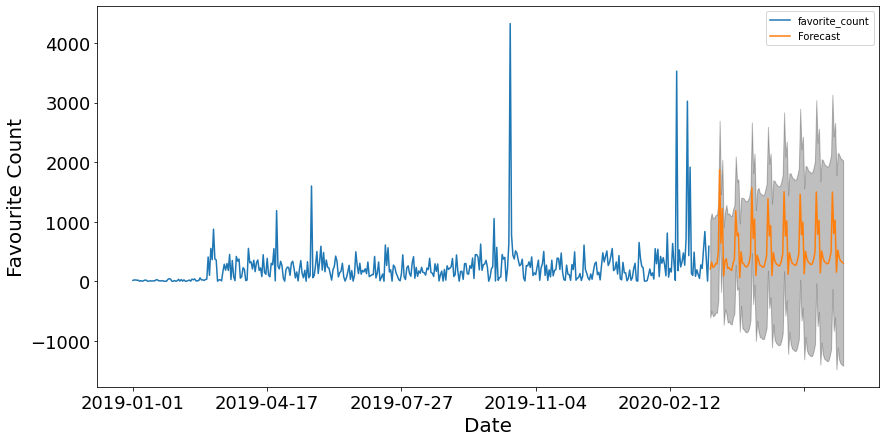

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets


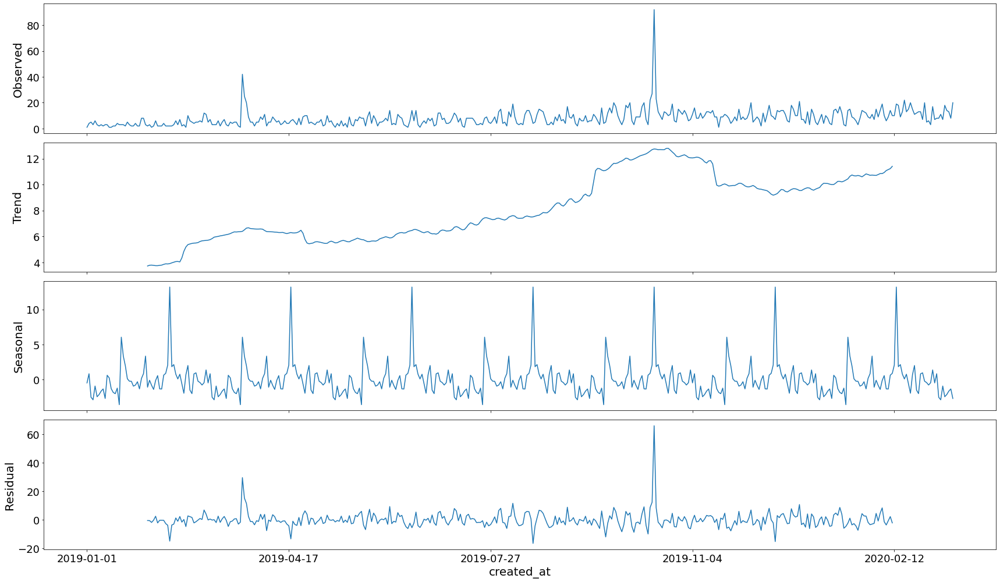

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3232.587609114499
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3026.0893681173948
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2977.0156679682
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2691.525565695346
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2916.2091892482595
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2746.6915996828734
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2813.6632725912973
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2693.5255610147465
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3031.869043959783
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2897.017382810178
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2935.9037446078473
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2640.404194711695
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2852.9775997098614
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2700.5103534925493
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2770.6001749419056
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2642.403556854868
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2897.3492608738047
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2829.3877565874755
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3415      0.035      9.726      0.000       0.273       0.410
ma.L1         -1.0000     12.671     -0.079      0.937     -25.836      23.836
ar.S.L12      -0.4924      0.013    -36.534      0.000      -0.519      -0.466
sigma2        52.6042    667.118      0.079      0.937   -1254.923    1360.131


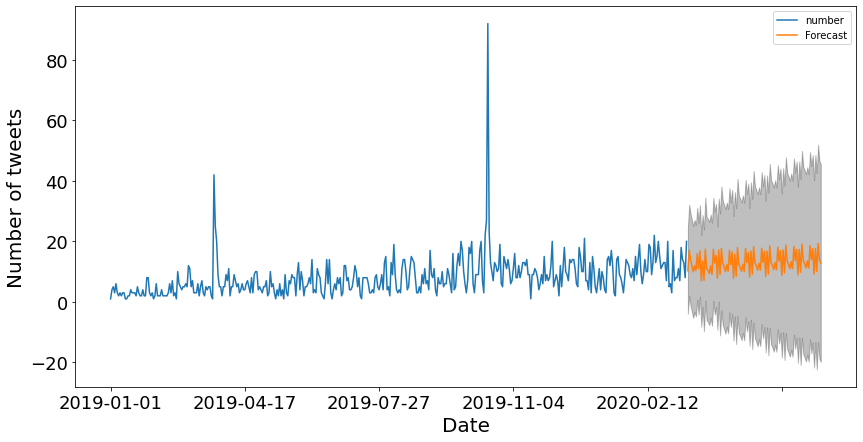

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## What happened?

In [ ]:
Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

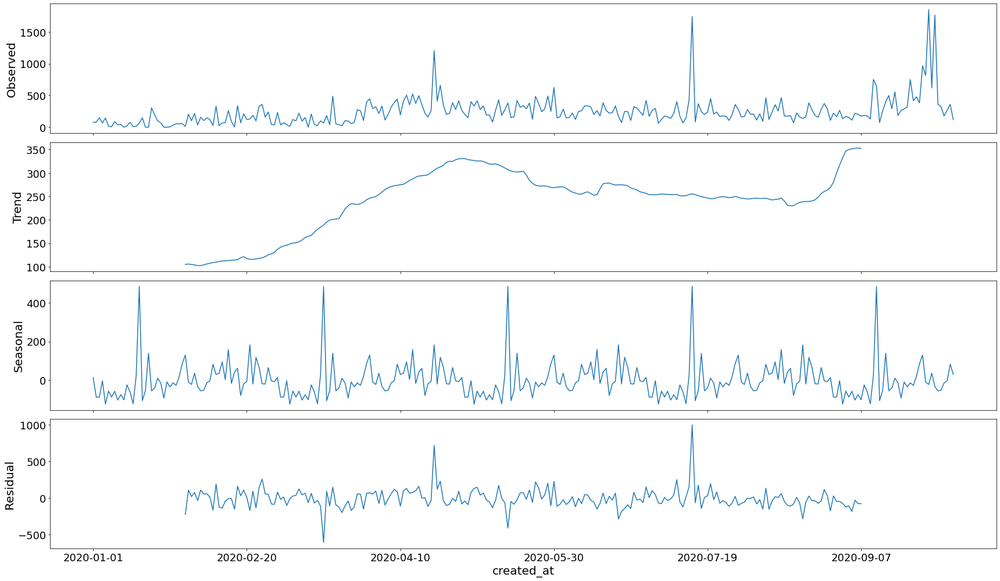

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


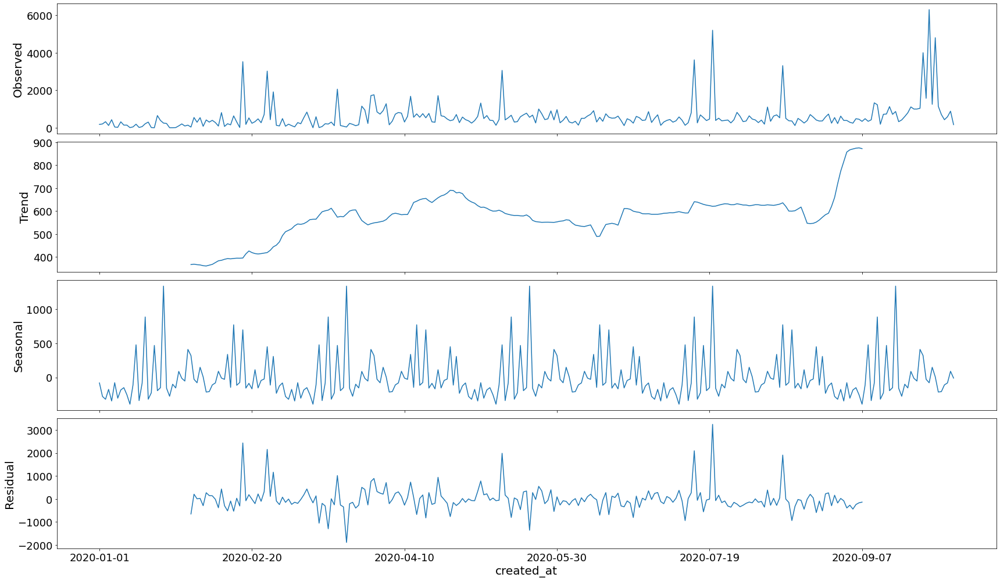

In [ ]:
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of Tweets


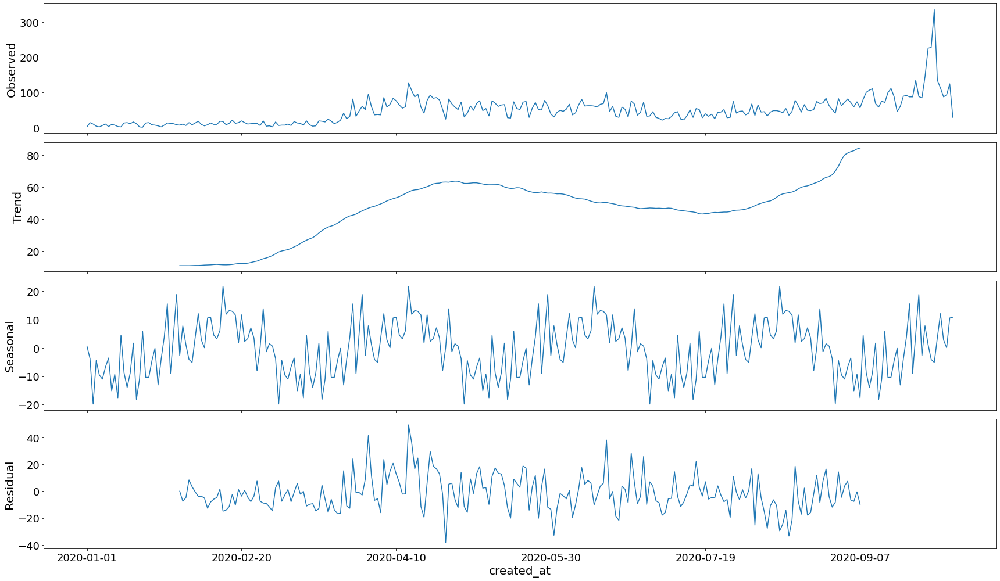

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

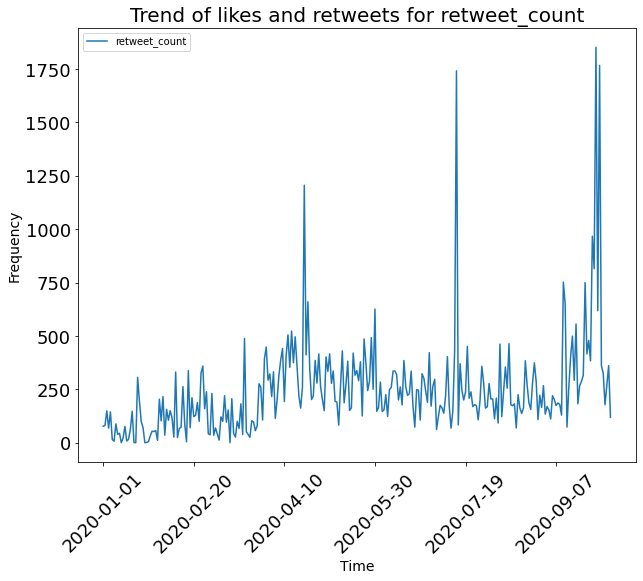

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'retweet_count')

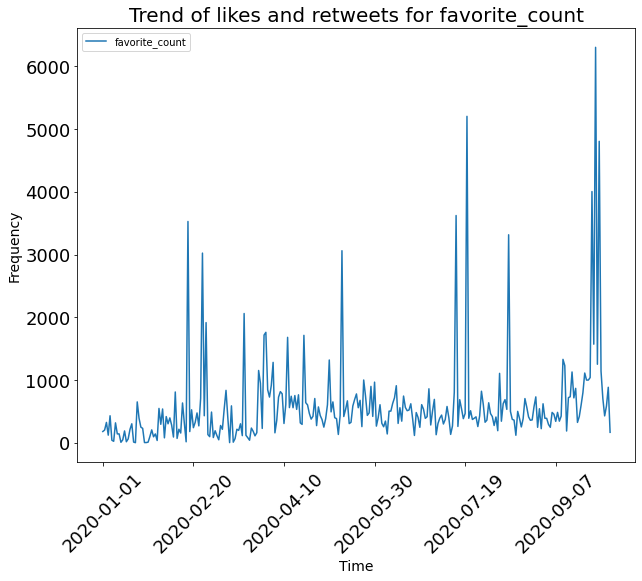

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'favorite_count')

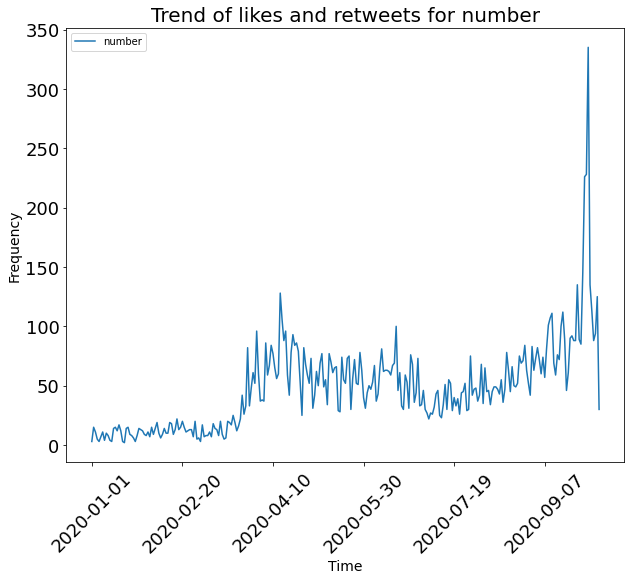

In [ ]:
Auto.Time_Trend(Covid_Number_Nigerian_Food_Tweets_Trend, 'number')

##**South Africa**


In [ ]:
South_Tweets = Auto.Clean_Tweets(South_African_Tweets)
print(Kenyan_Tweets.shape)

# Filter Based on Food Keywords

South_Food_Tweets = South_Tweets[South_Tweets['original_text'].str.lower().str.contains('|'.join(Food_Keywords))]
South_Food_Tweets.shape

(400213, 18)


(12439, 18)

In [ ]:
South_Food_Tweets.to_csv('south food tweets.csv')

## Trend before Covid


In [ ]:
Pre_Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_South_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## retweets

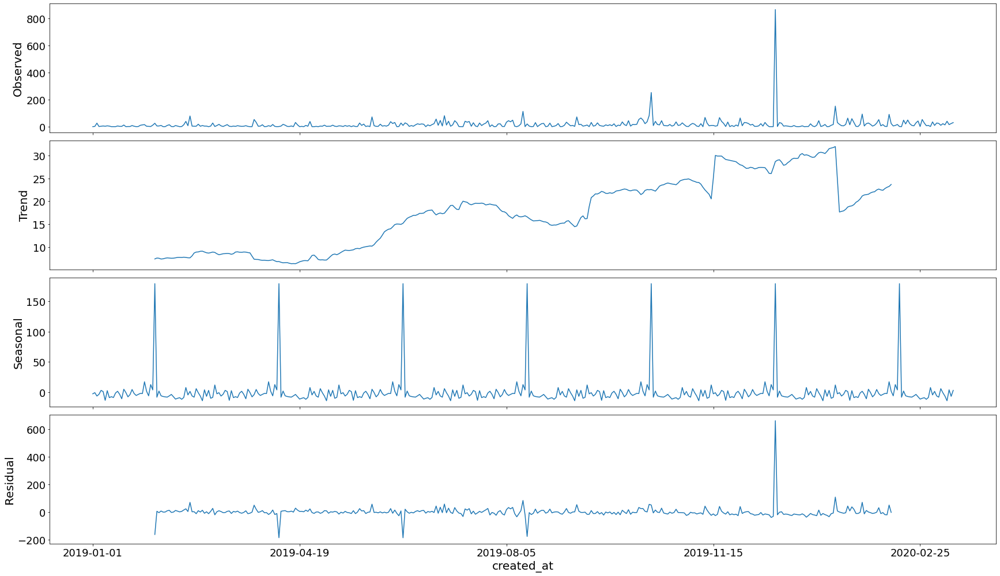

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_South_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4439.804404430596
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4321.610320694489
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4557.7962169447
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4182.126056729081
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4330.597481183428
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4306.821491053336
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4335.38920859188
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4183.707981256526
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4427.494903183039
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4310.558801183247
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4549.514086963411
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4174.409420603185
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4329.475069875314
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4299.185532910629
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4337.370648359914
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4175.951620068847
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4665.71072978095
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4544.271721793793
ARIMA(0, 1, 0)

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0081      0.092      0.088      0.930      -0.173       0.189
ma.L1         -1.0000     19.181     -0.052      0.958     -38.595      36.595
ar.S.L12      -0.4966      0.011    -46.604      0.000      -0.518      -0.476
sigma2      3598.7457   6.91e+04      0.052      0.958   -1.32e+05    1.39e+05


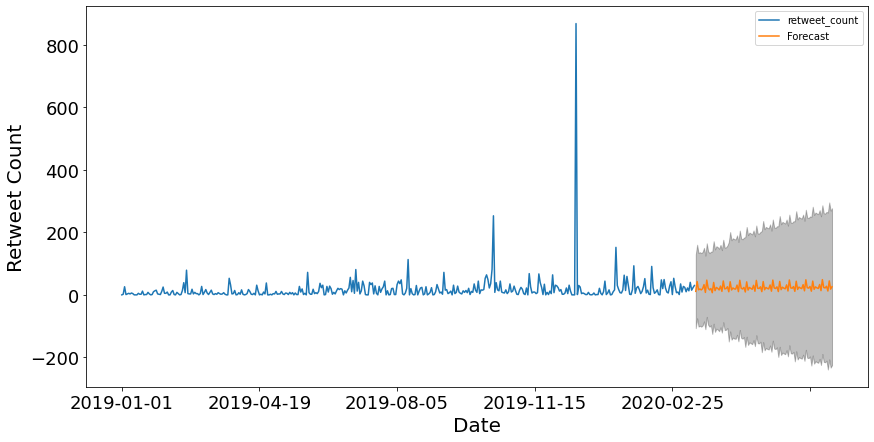

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

## Favorites

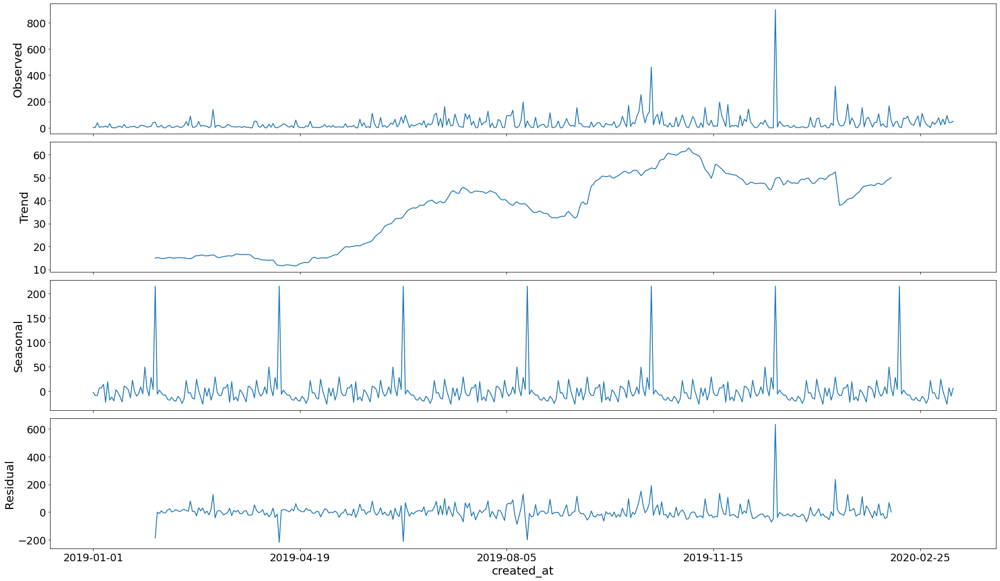

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4740.82215263666
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4597.859866946124
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4777.017896991392
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4405.285336068621
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4601.854347816103
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4534.485897423601
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4558.943134987072
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4406.79869081618
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4710.073378453183
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4577.376969173958
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4767.871436022384
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4396.774679798291
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4595.103262455968
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4526.152133359183
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4560.927070577987
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4398.229229962419
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4884.321094616542
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4754.697258962988
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0074      0.052      0.143      0.886      -0.094       0.109
ma.L1         -1.0000     19.033     -0.053      0.958     -38.304      36.304
ar.S.L12      -0.4766      0.012    -39.630      0.000      -0.500      -0.453
sigma2      6354.9269   1.21e+05      0.053      0.958   -2.31e+05    2.43e+05


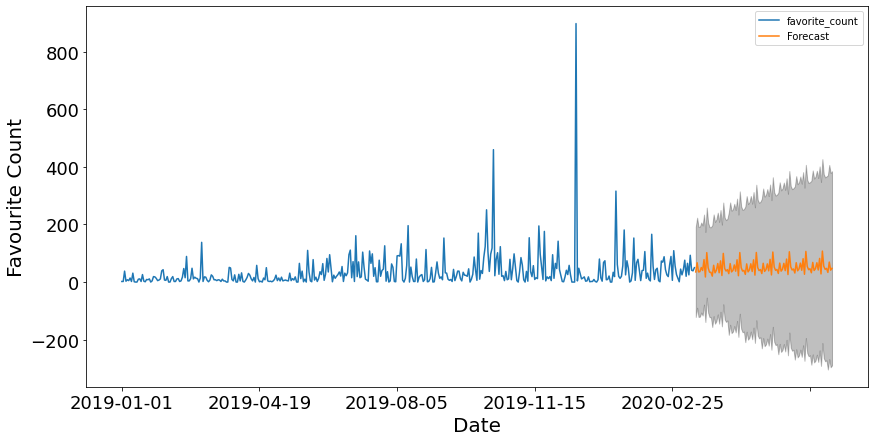

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets

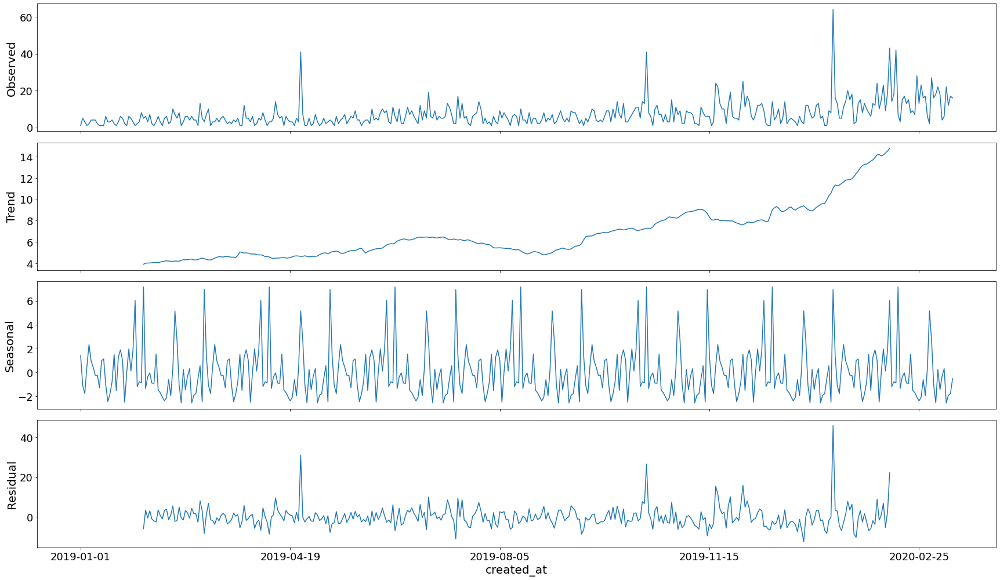

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3079.6138569882946
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:2886.59752948852
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2851.0897968911095
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2601.4076324366515
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2795.702967617962
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2657.996182236874
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2696.813044272002
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2603.407632808029
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2929.3822262557487
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2803.228919805516
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2841.0343868370946
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2583.3288666578346
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2770.463510812965
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2645.5003978751447
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2686.372337169759
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2585.3284982947944
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2881.976997668902
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2811.61984426517
ARIM

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1807      0.047      3.873      0.000       0.089       0.272
ma.L1         -1.0000      6.485     -0.154      0.877     -13.711      11.711
ar.S.L12      -0.4849      0.025    -19.763      0.000      -0.533      -0.437
sigma2        53.6239    347.973      0.154      0.878    -628.391     735.638


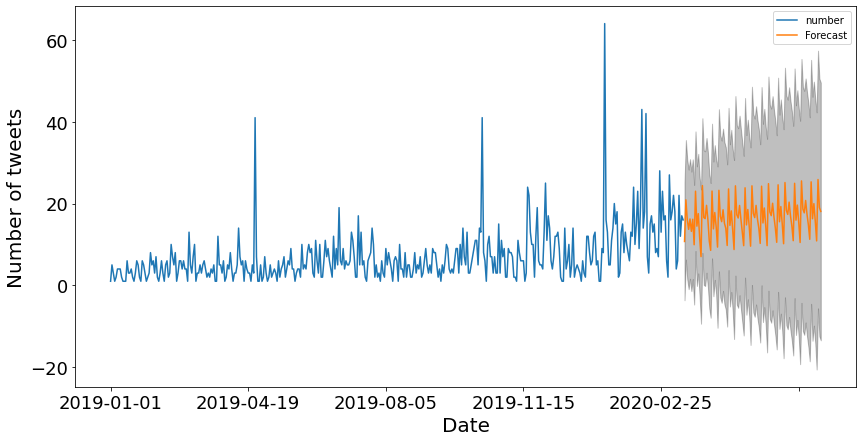

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## what happened

In [ ]:
Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_South_Food_Tweets_Trend['number'] = 1

Covid_Retweet_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

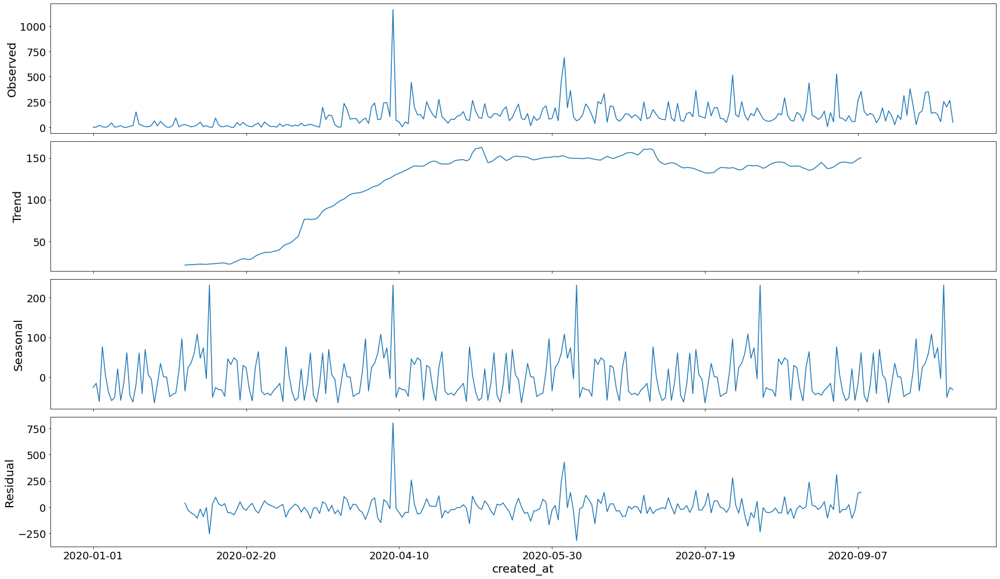

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


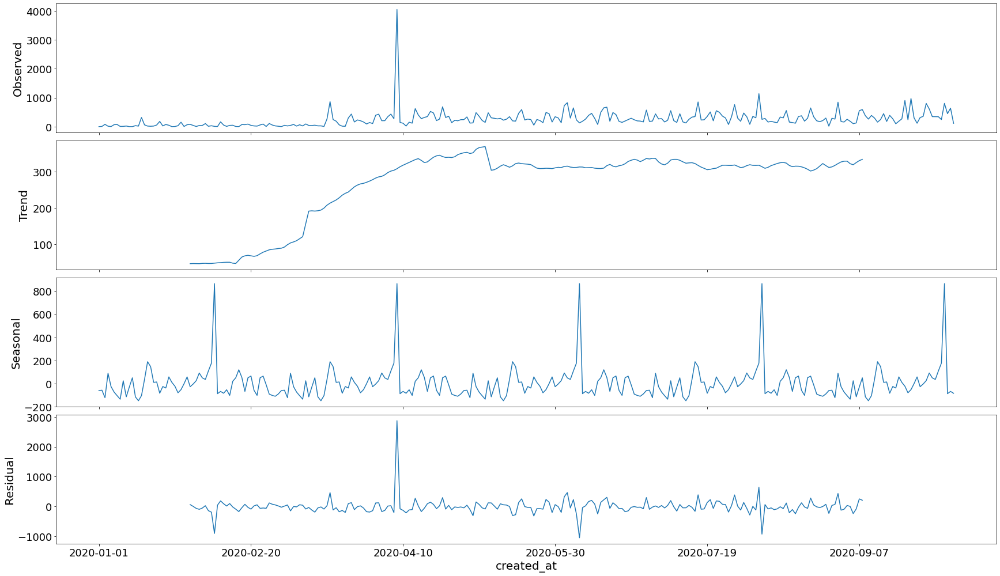

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of tweets

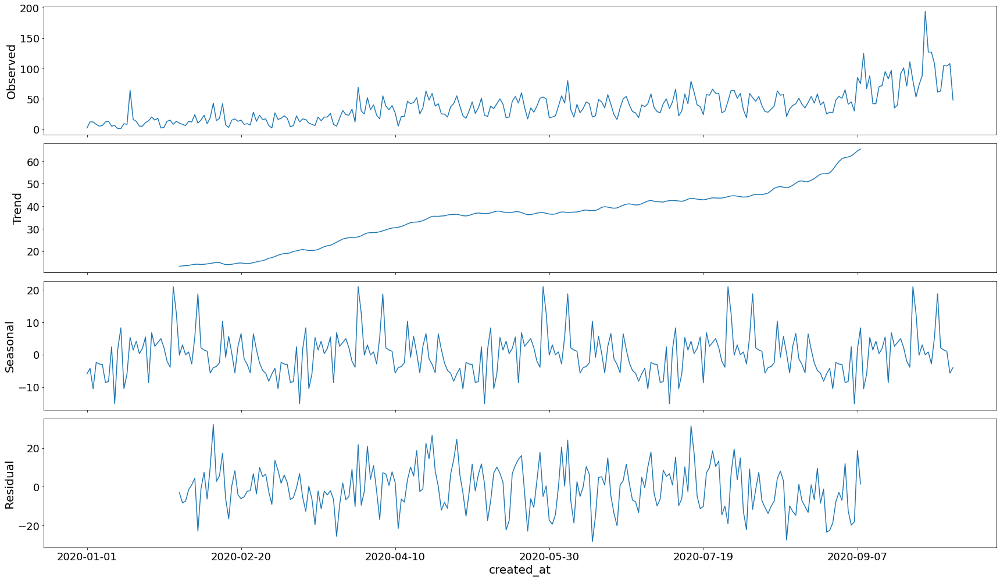

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

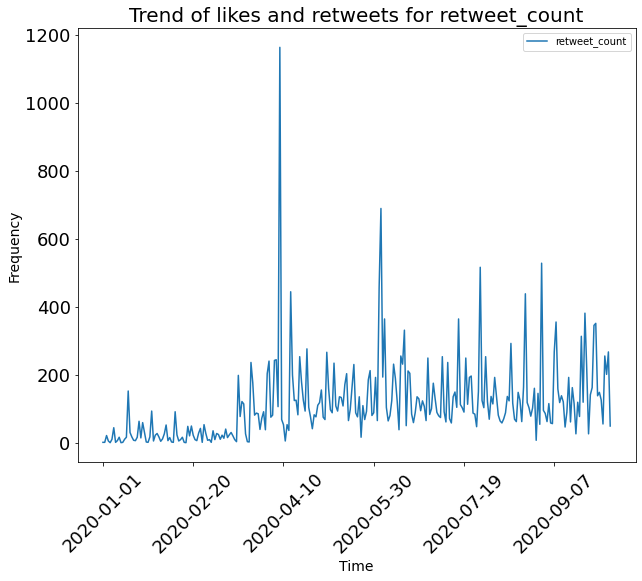

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'retweet_count')

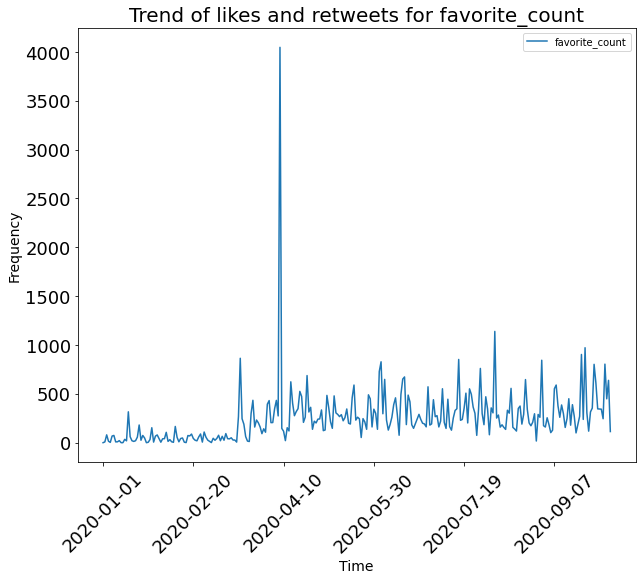

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'favorite_count')

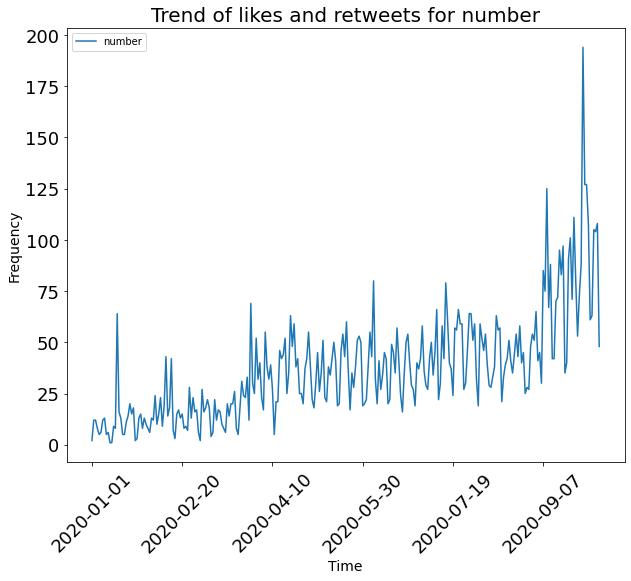

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'number')

## **Change Point Analysis by User Category**


In [ ]:
Kenyan_Category_Users= pd.merge(left=Kenyan_Food_Tweets, right=Kenyan_Users[['original_author','group']], how='left', left_on='original_author', right_on='original_author')
Nigerian_Category_Users= pd.merge(left=Nigerian_Food_Tweets, right=Nigerian_Users[['original_author','group']], how='left', left_on='original_author', right_on='original_author')
South_African_Category_Users= pd.merge(left=South_Food_Tweets, right=South_African_Users[['original_author','group']], how='left', left_on='original_author', right_on='original_author')

## **Kenya**

### **General**

In [ ]:
Kenyan_Food_Tweets = Kenyan_Category_Users[Kenyan_Category_Users['group'] >= 'general' ]

### **Let us first take note of the trend before Covid in Kenya**

We forecast the trend using Autoregressive Integrated Moving Average

In [ ]:
Pre_Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

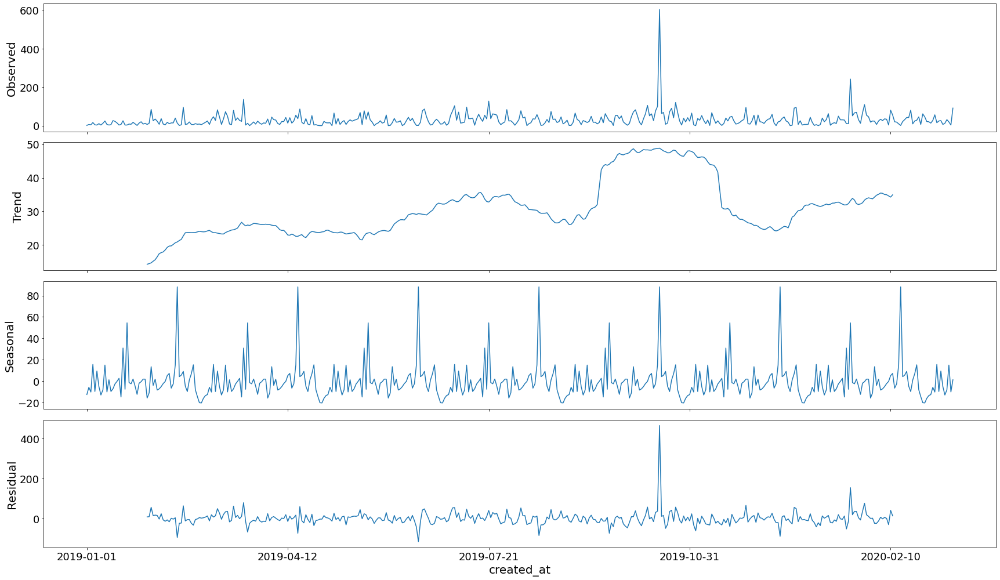

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4571.645285580174
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4402.13018322828
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4521.01348332057
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4176.621644180586
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4389.398892810106
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4294.29191643752
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4333.077464031304
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4178.352614732525
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4491.730794823886
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4351.873747316782
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4503.864731558908
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4156.453837769603
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4359.541733280456
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4275.197228781876
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4317.207494341594
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4158.3210331415885
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4566.299118128486
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4451.912289907782
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2287      0.038      6.043      0.000       0.155       0.303
ma.L1         -1.0000     12.037     -0.083      0.934     -24.591      22.591
ar.S.L12      -0.4552      0.013    -36.410      0.000      -0.480      -0.431
sigma2      2264.6823   2.73e+04      0.083      0.934   -5.12e+04    5.57e+04


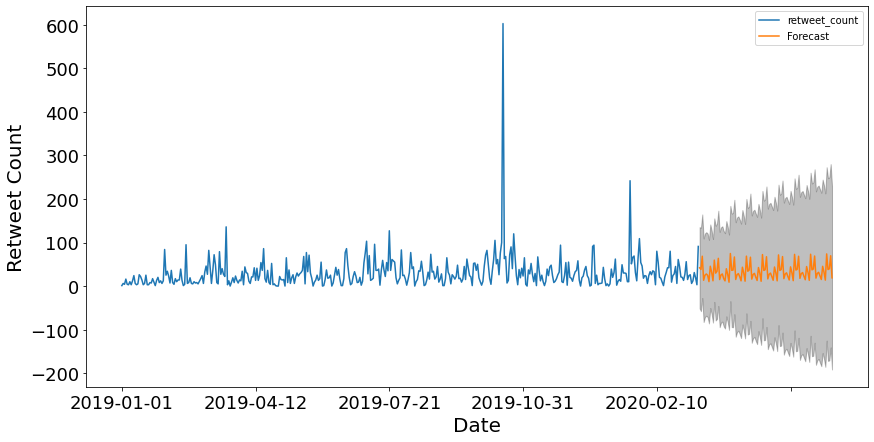

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

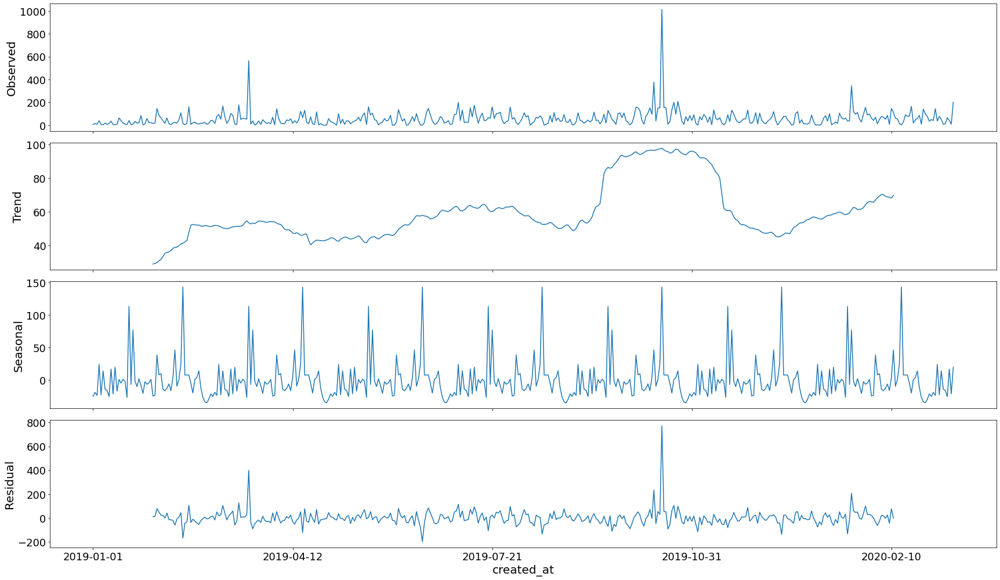

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5122.0689988227905
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4926.239549621549
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5027.767128850044
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4681.673117852892
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4909.675857796305
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4815.356060404217
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4833.8195885040295
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4682.428088491757
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5042.980296457279
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4878.92097001147
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5012.224185004192
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4662.716609579394
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4885.879664212627
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4797.737269556899
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4823.136820700551
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4663.966950653512
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5109.276133377087
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4978.939784744897
ARIMA(0, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1977      0.050      3.943      0.000       0.099       0.296
ma.L1         -1.0000     13.490     -0.074      0.941     -27.440      25.440
ar.S.L12      -0.4333      0.015    -28.053      0.000      -0.464      -0.403
sigma2      7816.0160   1.06e+05      0.074      0.941   -1.99e+05    2.15e+05


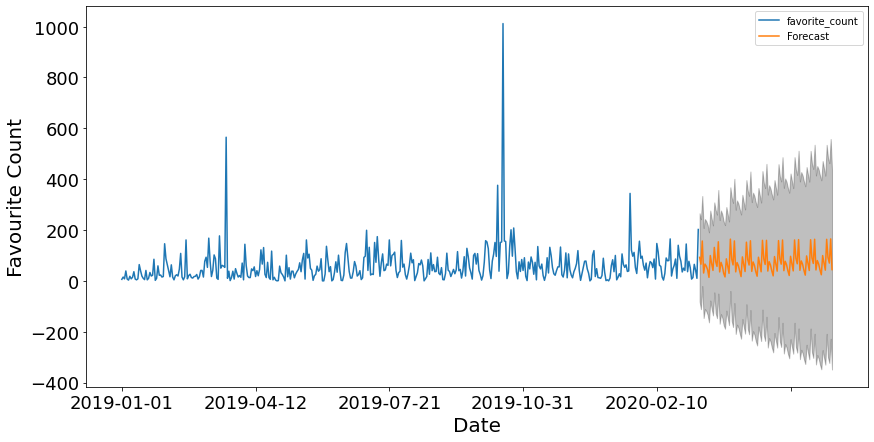

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

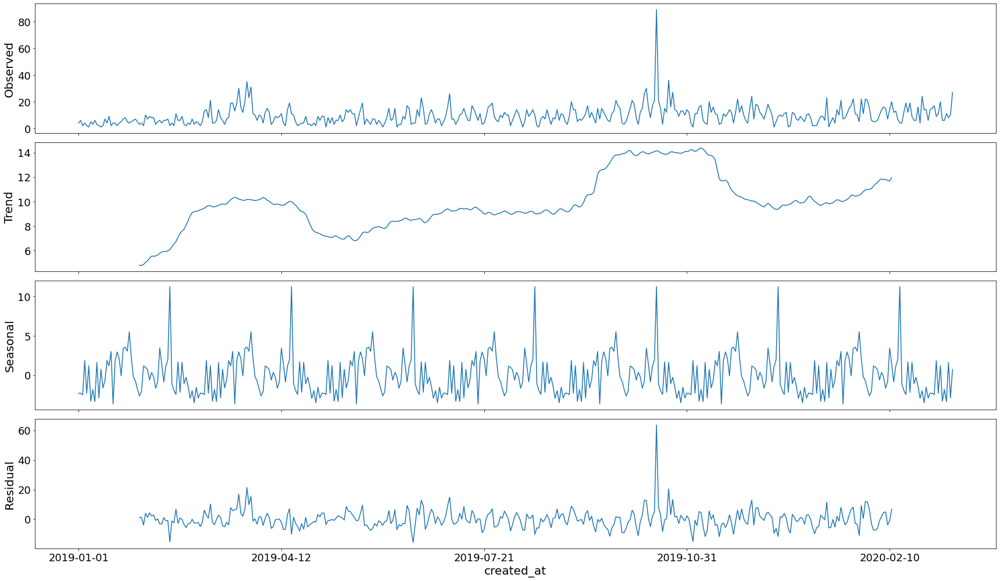

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3370.4626210762244
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3132.21586270978
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:3083.2252197529015
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2809.458298658522
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:3027.6899309622477
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2876.3057062023977
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2954.4198847577168
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2810.82631635333
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3167.3623441311374
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:3020.2968998442357
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:3049.746045250451
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2759.0962590142653
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2974.741012976846
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2829.700606788024
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2904.866282122548
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2761.0805347305495
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:3000.6966615518418
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2928.7809705367195
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3923      0.036     10.933      0.000       0.322       0.463
ma.L1         -1.0000     14.137     -0.071      0.944     -28.709      26.709
ar.S.L12      -0.4641      0.018    -25.482      0.000      -0.500      -0.428
sigma2        69.5567    984.064      0.071      0.944   -1859.173    1998.287


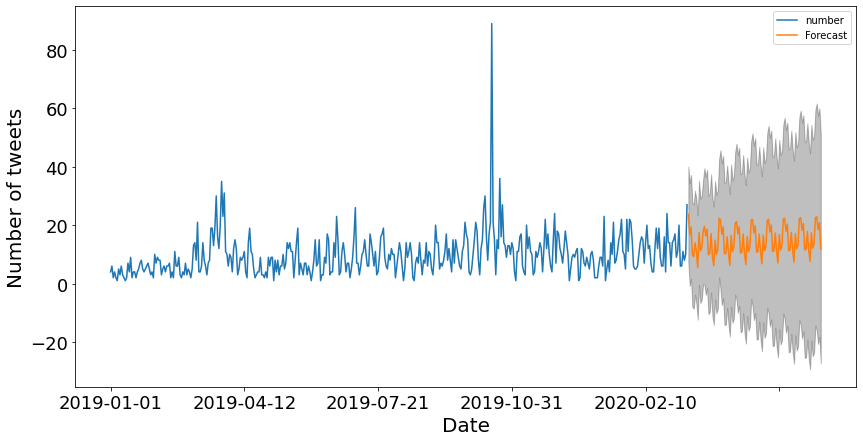

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## **What happened?**

In [ ]:
Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

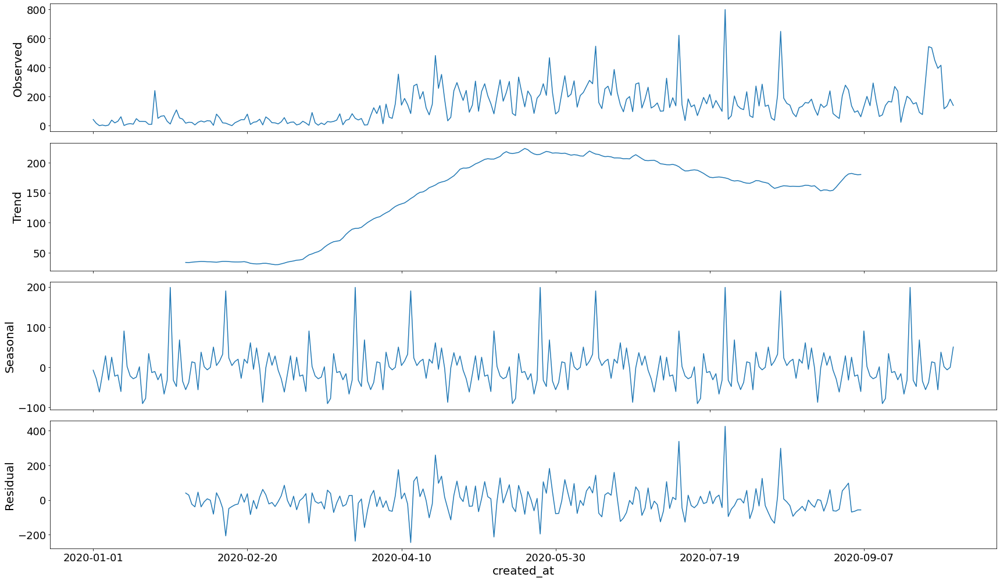

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

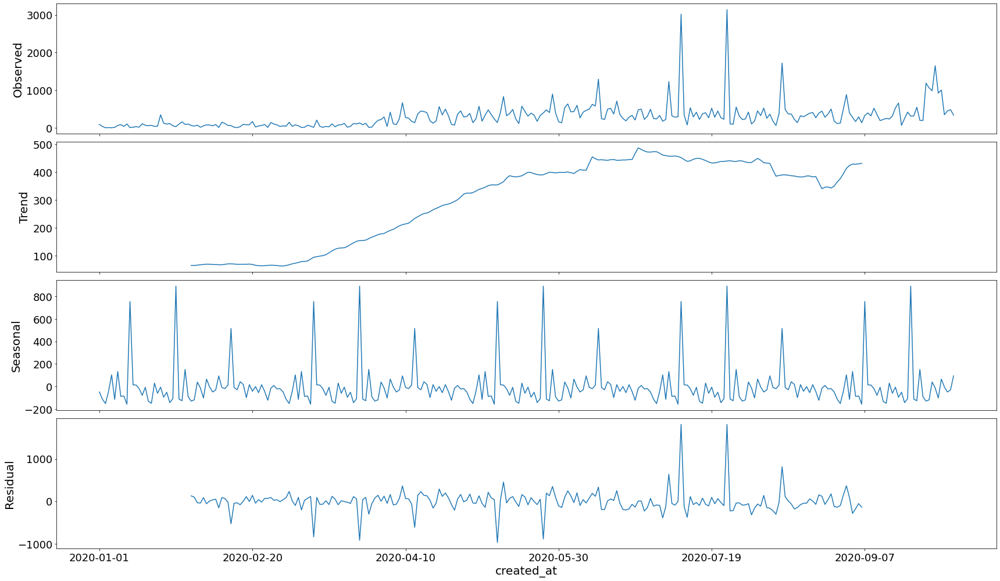

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

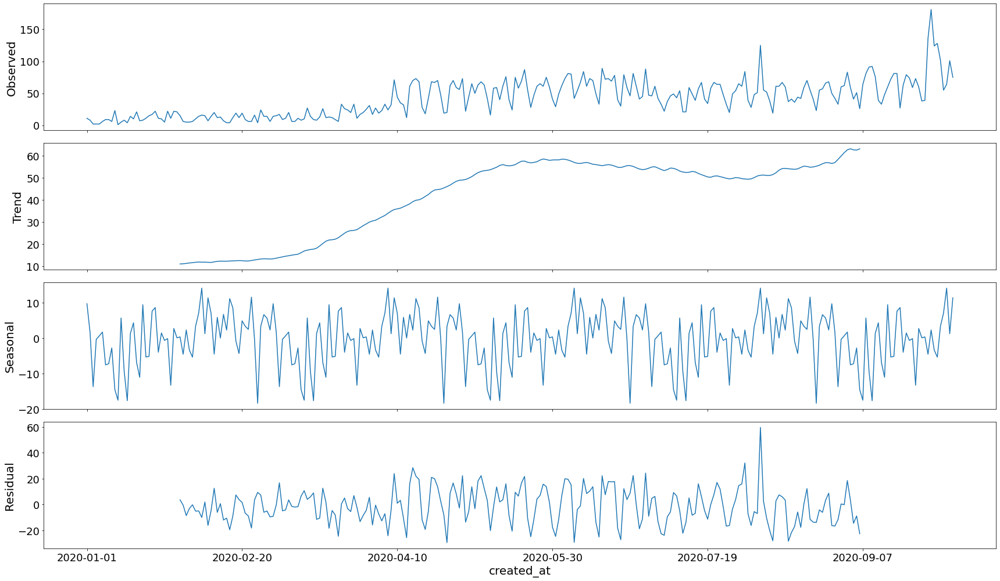

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

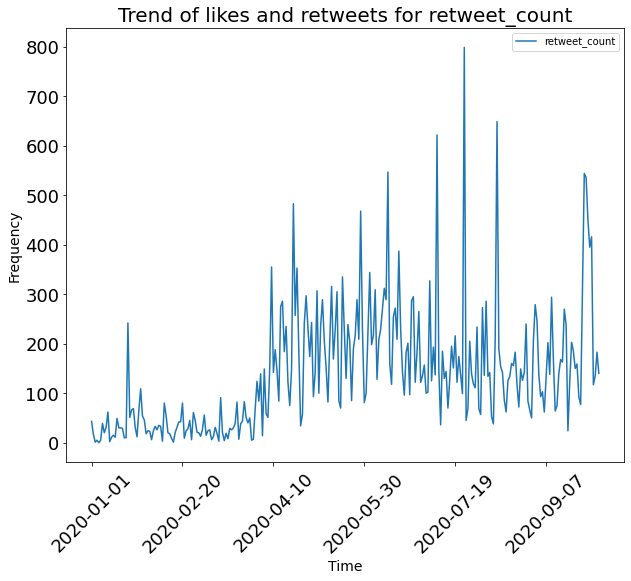

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'retweet_count')

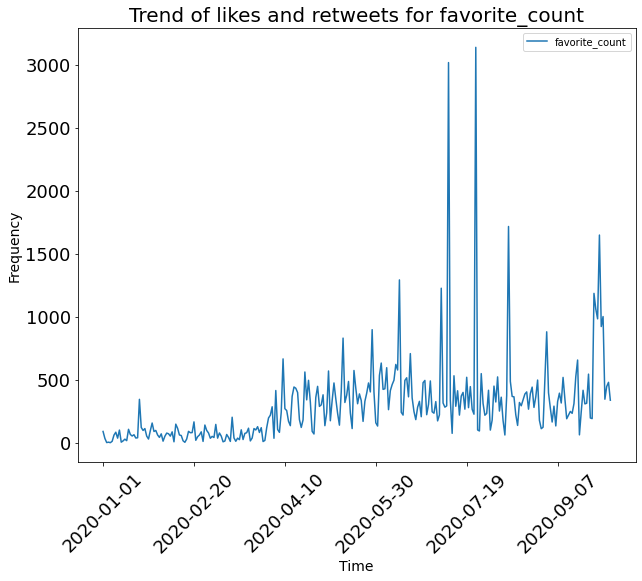

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'favorite_count')

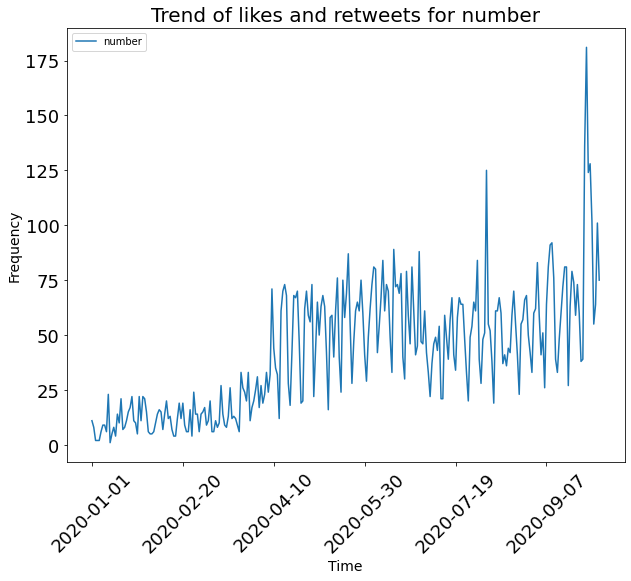

In [ ]:
Auto.Time_Trend(Covid_Number_Kenyan_Food_Tweets_Trend, 'number')

### **Private**

In [ ]:
Kenyan_Food_Tweets = Kenyan_Category_Users[Kenyan_Category_Users['group'] >= 'private' ]

### **Let us first take note of the trend before Covid in Kenya**

We forecast the trend using Autoregressive Integrated Moving Average

In [ ]:
Pre_Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

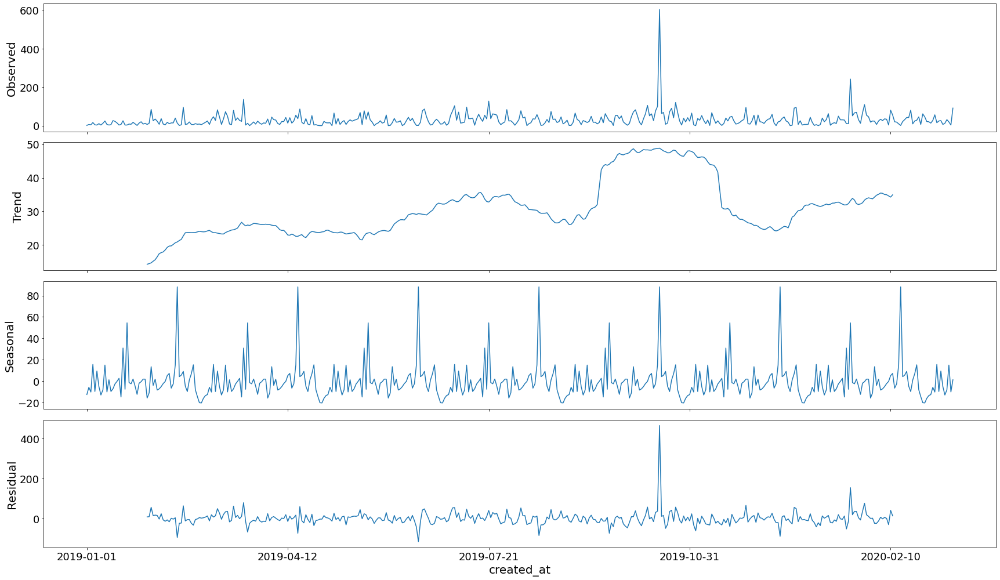

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4571.645285580174
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4402.13018322828
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4521.01348332057
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4176.621644180586
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4389.398892810106
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4294.29191643752
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4333.077464031304
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4178.352614732525
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4491.730794823886
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4351.873747316782
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4503.864731558908
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4156.453837769603
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4359.541733280456
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4275.197228781876
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4317.207494341594
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4158.3210331415885
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4566.299118128486
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4451.912289907782
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2287      0.038      6.043      0.000       0.155       0.303
ma.L1         -1.0000     12.037     -0.083      0.934     -24.591      22.591
ar.S.L12      -0.4552      0.013    -36.410      0.000      -0.480      -0.431
sigma2      2264.6823   2.73e+04      0.083      0.934   -5.12e+04    5.57e+04


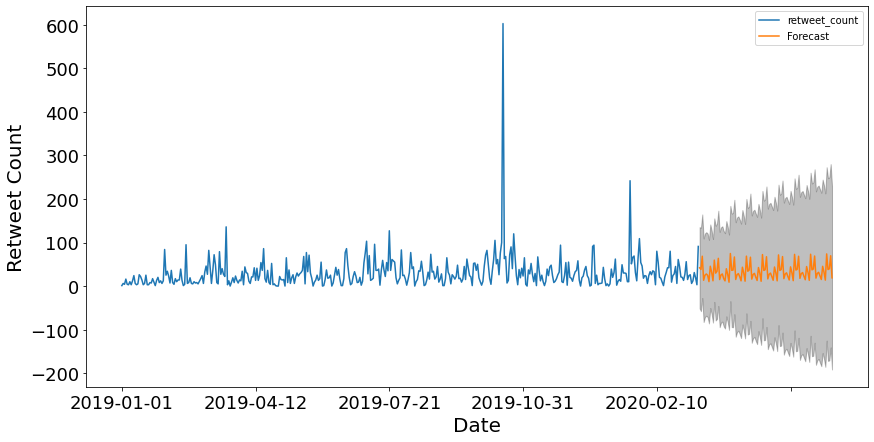

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

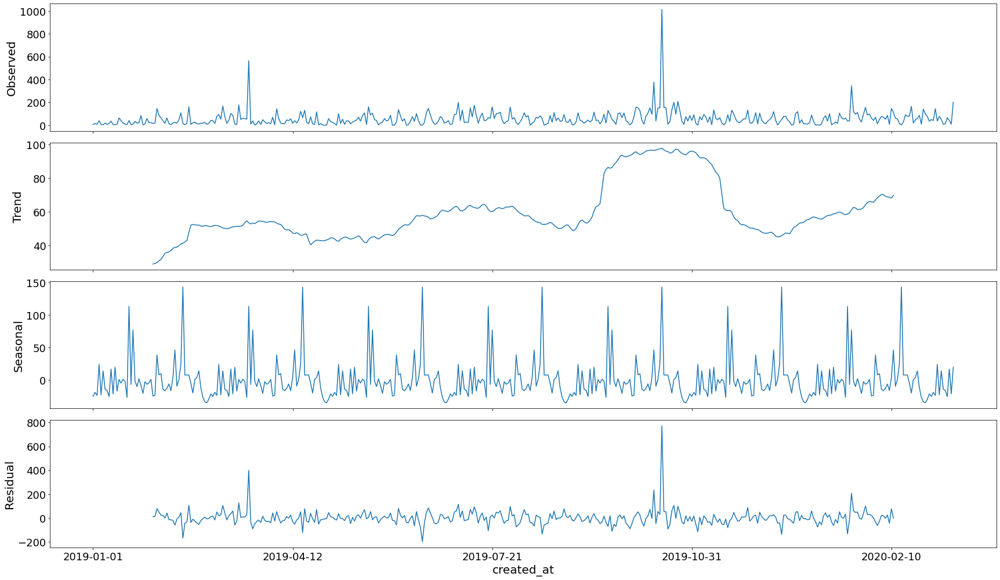

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5122.0689988227905
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4926.239549621549
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5027.767128850044
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4681.673117852892
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4909.675857796305
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4815.356060404217
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4833.8195885040295
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4682.428088491757
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5042.980296457279
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4878.92097001147
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5012.224185004192
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4662.716609579394
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4885.879664212627
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4797.737269556899
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4823.136820700551
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4663.966950653512
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5109.276133377087
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4978.939784744897
ARIMA(0, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1977      0.050      3.943      0.000       0.099       0.296
ma.L1         -1.0000     13.490     -0.074      0.941     -27.440      25.440
ar.S.L12      -0.4333      0.015    -28.053      0.000      -0.464      -0.403
sigma2      7816.0160   1.06e+05      0.074      0.941   -1.99e+05    2.15e+05


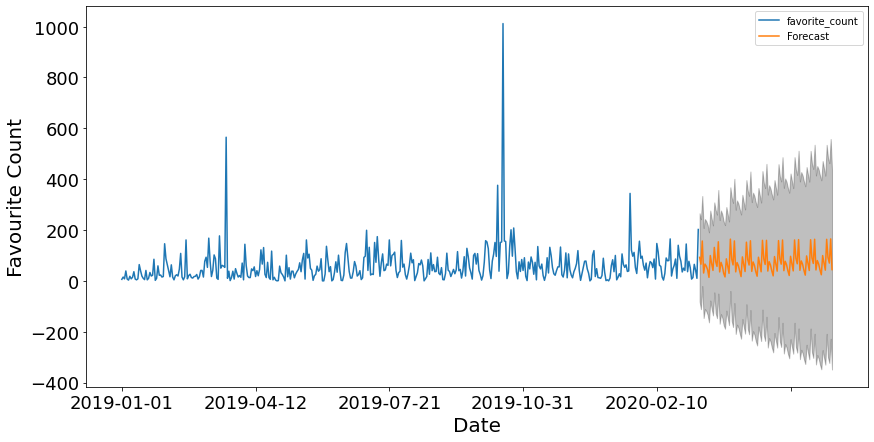

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

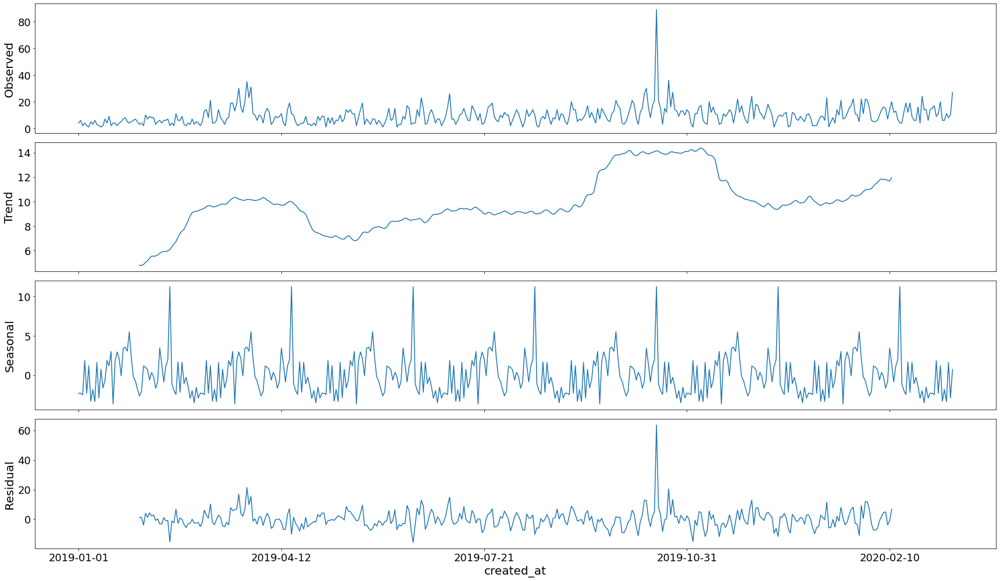

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3370.4626210762244
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3132.21586270978
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:3083.2252197529015
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2809.458298658522
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:3027.6899309622477
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2876.3057062023977
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2954.4198847577168
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2810.82631635333
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3167.3623441311374
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:3020.2968998442357
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:3049.746045250451
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2759.0962590142653
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2974.741012976846
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2829.700606788024
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2904.866282122548
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2761.0805347305495
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:3000.6966615518418
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2928.7809705367195
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3923      0.036     10.933      0.000       0.322       0.463
ma.L1         -1.0000     14.137     -0.071      0.944     -28.709      26.709
ar.S.L12      -0.4641      0.018    -25.482      0.000      -0.500      -0.428
sigma2        69.5567    984.064      0.071      0.944   -1859.173    1998.287


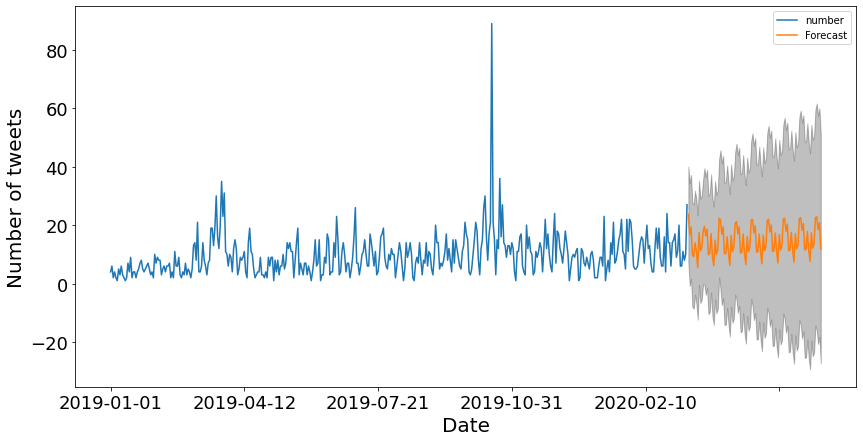

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## **What happened?**

In [ ]:
Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

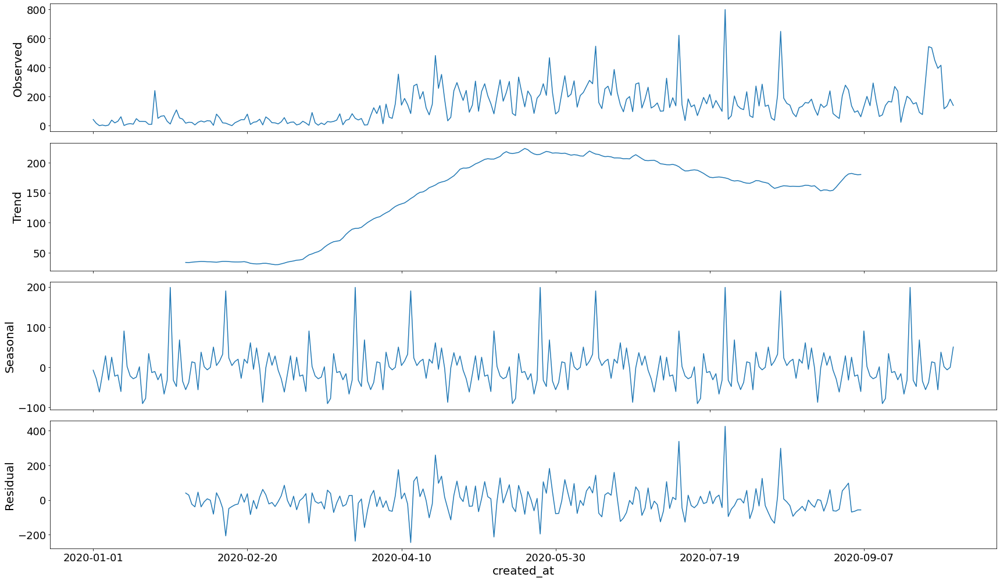

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

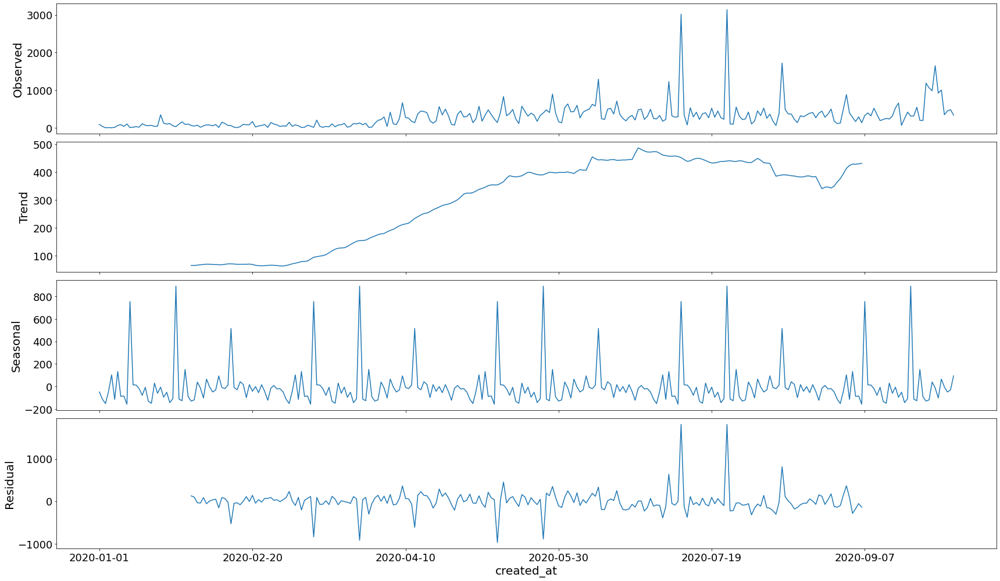

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

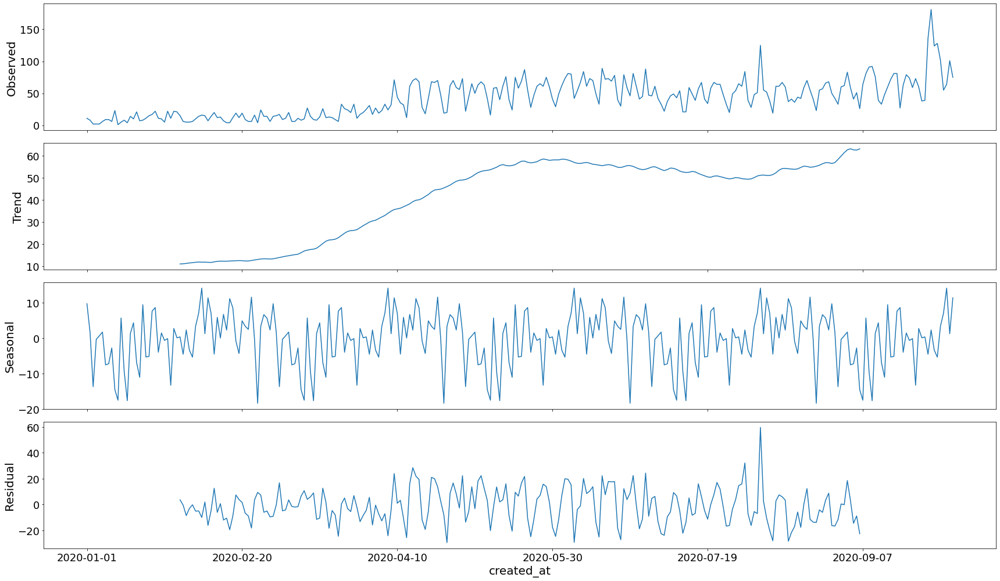

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

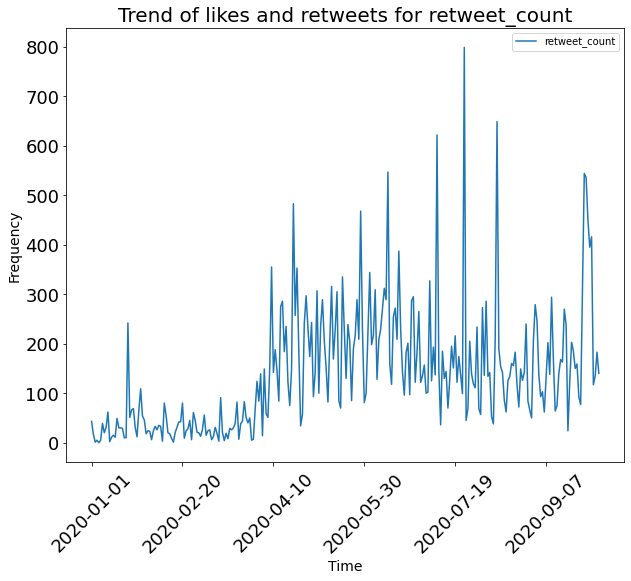

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'retweet_count')

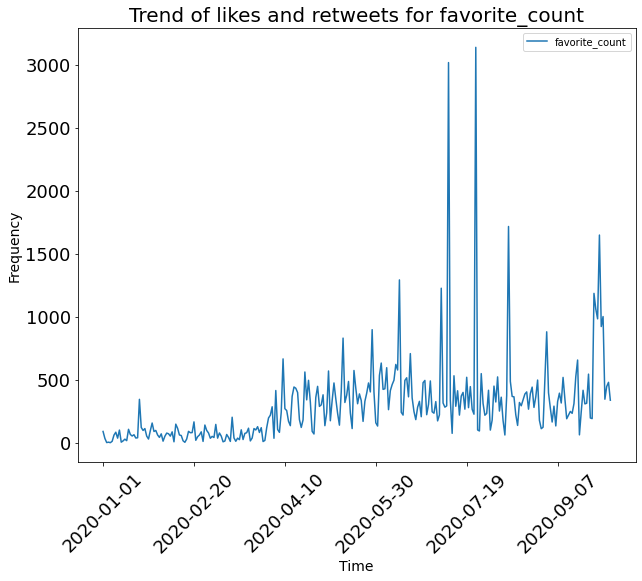

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'favorite_count')

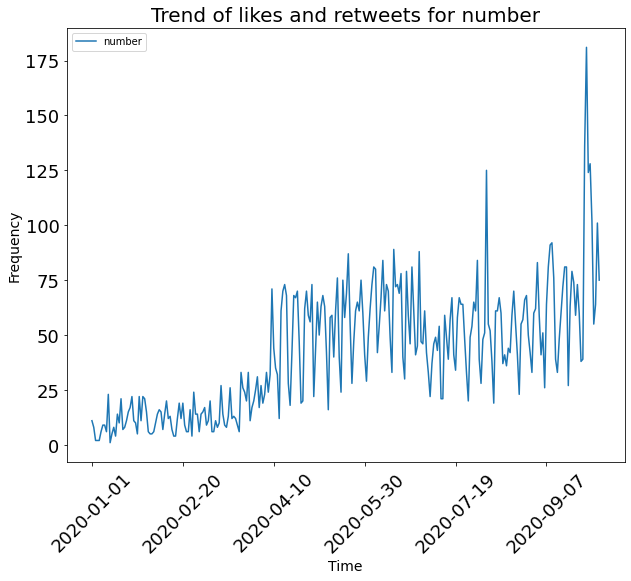

In [ ]:
Auto.Time_Trend(Covid_Number_Kenyan_Food_Tweets_Trend, 'number')

### **NGOs**

In [ ]:
Kenyan_Food_Tweets = Kenyan_Category_Users[Kenyan_Category_Users['group'] >= 'NGO' ]

### **Let us first take note of the trend before Covid in Kenya**

We forecast the trend using Autoregressive Integrated Moving Average

In [ ]:
Pre_Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

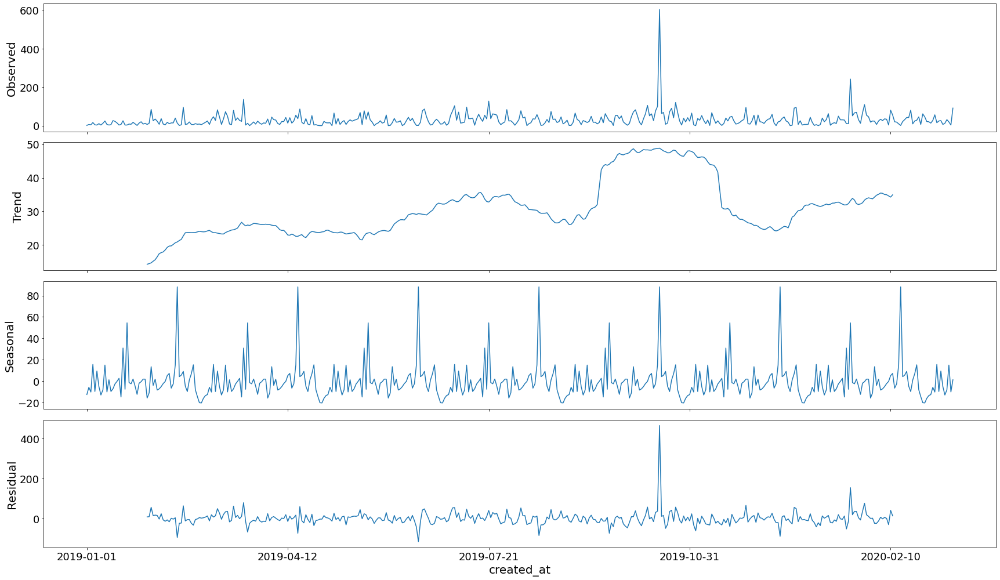

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4571.645285580174
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4402.13018322828
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4521.01348332057
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4176.621644180586
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4389.398892810106
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4294.29191643752
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4333.077464031304
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4178.352614732525
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4491.730794823886
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4351.873747316782
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4503.864731558908
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4156.453837769603
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4359.541733280456
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4275.197228781876
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4317.207494341594
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4158.3210331415885
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4566.299118128486
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4451.912289907782
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2287      0.038      6.043      0.000       0.155       0.303
ma.L1         -1.0000     12.037     -0.083      0.934     -24.591      22.591
ar.S.L12      -0.4552      0.013    -36.410      0.000      -0.480      -0.431
sigma2      2264.6823   2.73e+04      0.083      0.934   -5.12e+04    5.57e+04


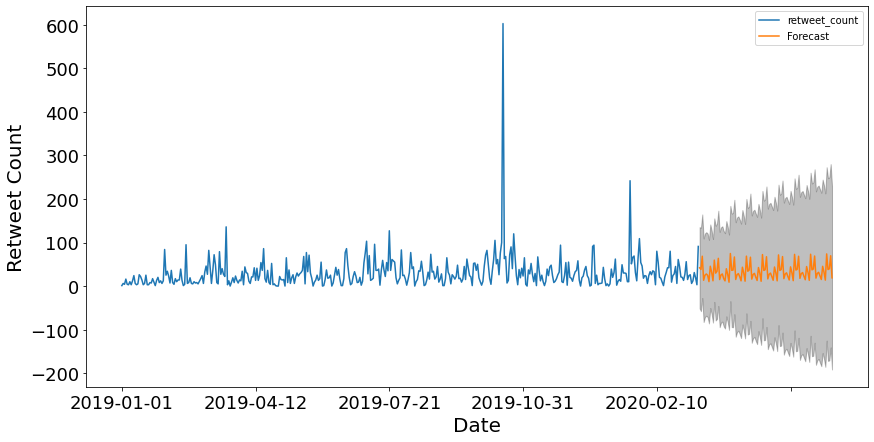

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

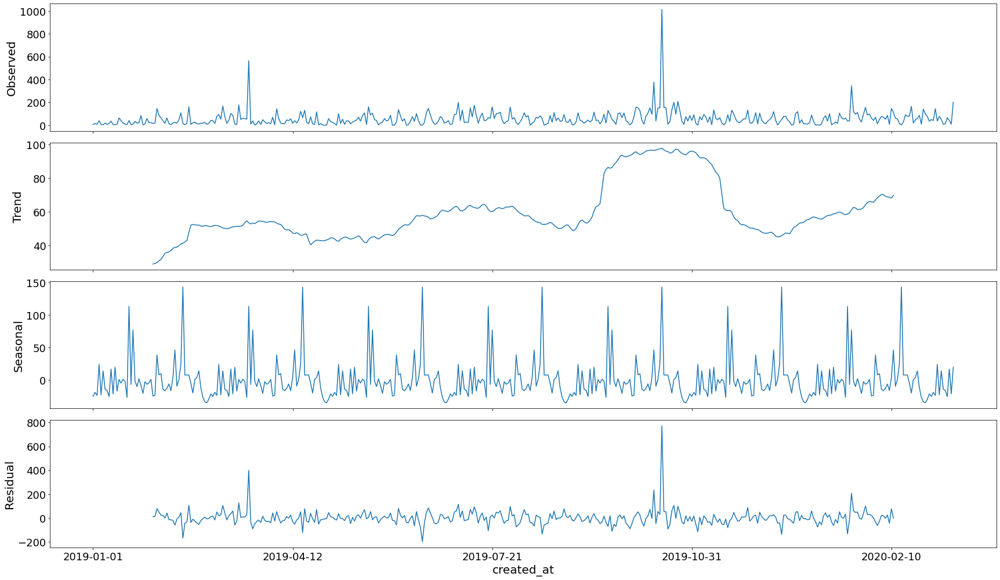

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5122.0689988227905
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4926.239549621549
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5027.767128850044
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4681.673117852892
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4909.675857796305
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4815.356060404217
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4833.8195885040295
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4682.428088491757
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5042.980296457279
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4878.92097001147
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5012.224185004192
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4662.716609579394
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4885.879664212627
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4797.737269556899
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4823.136820700551
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4663.966950653512
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5109.276133377087
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4978.939784744897
ARIMA(0, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1977      0.050      3.943      0.000       0.099       0.296
ma.L1         -1.0000     13.490     -0.074      0.941     -27.440      25.440
ar.S.L12      -0.4333      0.015    -28.053      0.000      -0.464      -0.403
sigma2      7816.0160   1.06e+05      0.074      0.941   -1.99e+05    2.15e+05


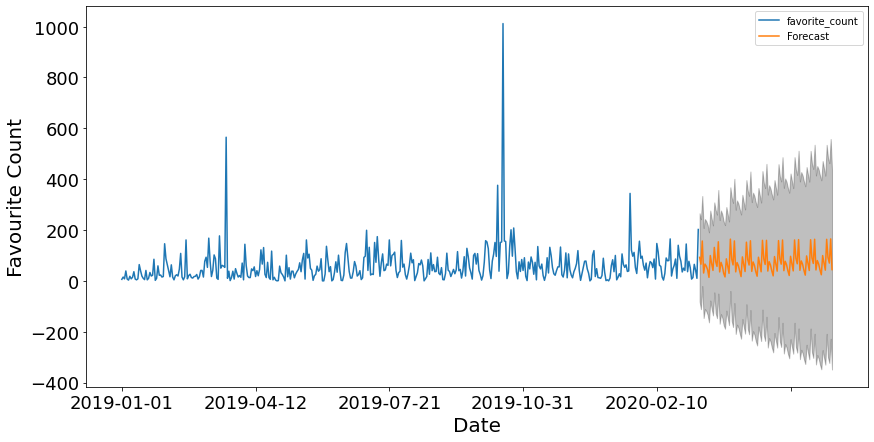

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

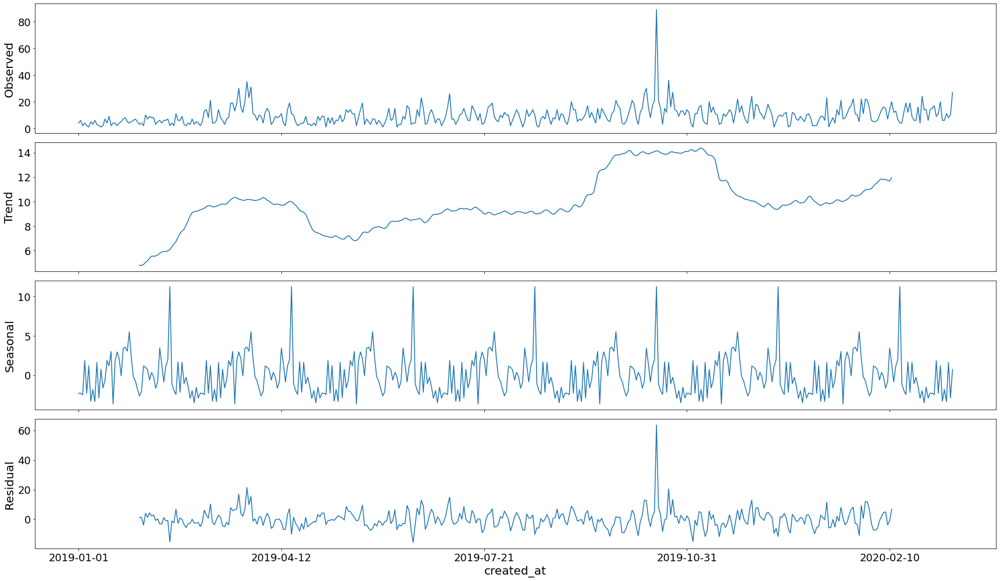

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3370.4626210762244
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3132.21586270978
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:3083.2252197529015
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2809.458298658522
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:3027.6899309622477
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2876.3057062023977
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2954.4198847577168
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2810.82631635333
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3167.3623441311374
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:3020.2968998442357
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:3049.746045250451
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2759.0962590142653
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2974.741012976846
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2829.700606788024
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2904.866282122548
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2761.0805347305495
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:3000.6966615518418
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2928.7809705367195
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3923      0.036     10.933      0.000       0.322       0.463
ma.L1         -1.0000     14.137     -0.071      0.944     -28.709      26.709
ar.S.L12      -0.4641      0.018    -25.482      0.000      -0.500      -0.428
sigma2        69.5567    984.064      0.071      0.944   -1859.173    1998.287


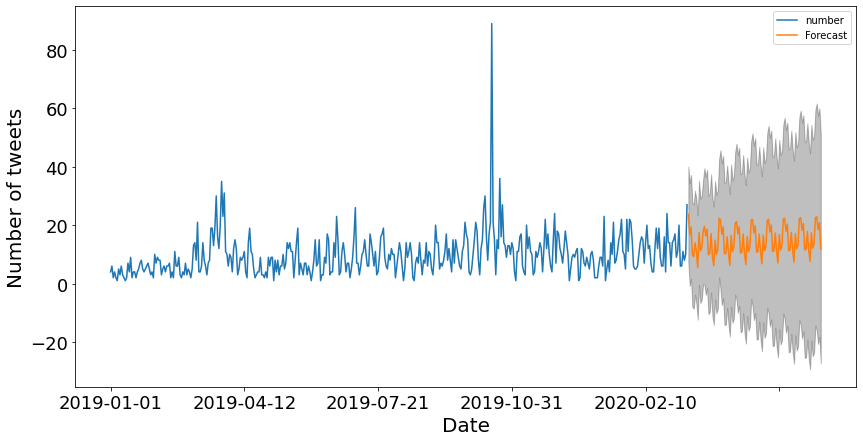

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## **What happened?**

In [ ]:
Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

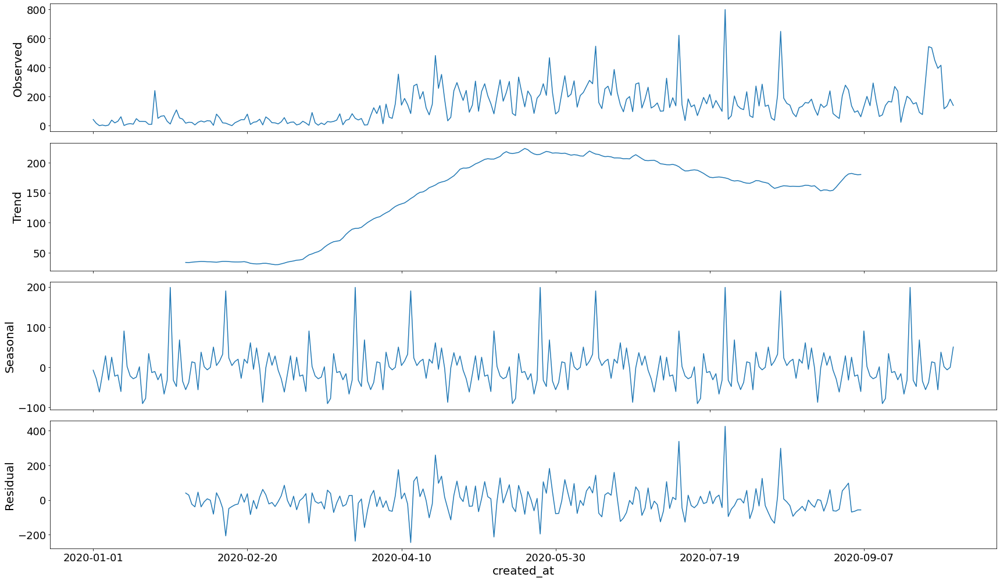

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

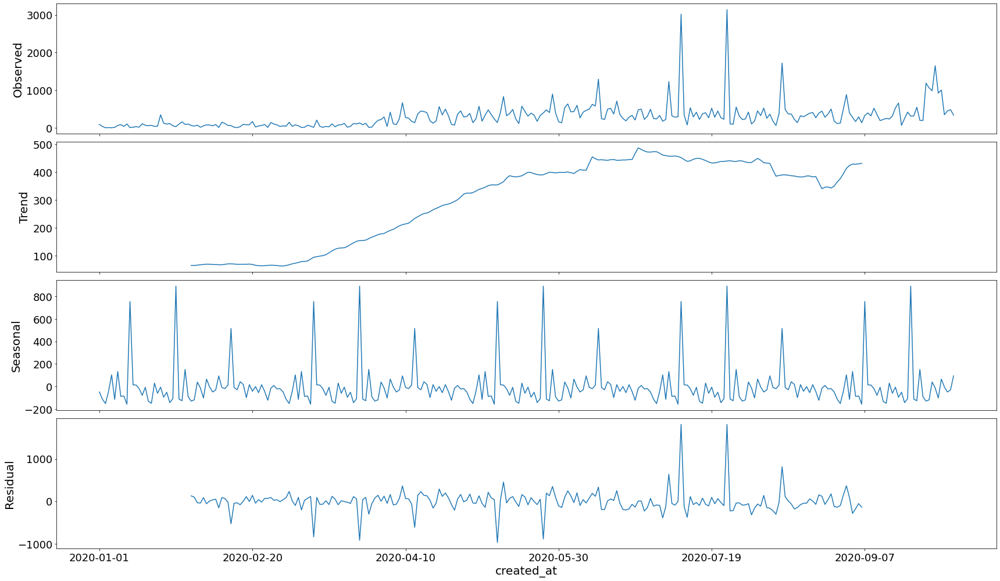

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

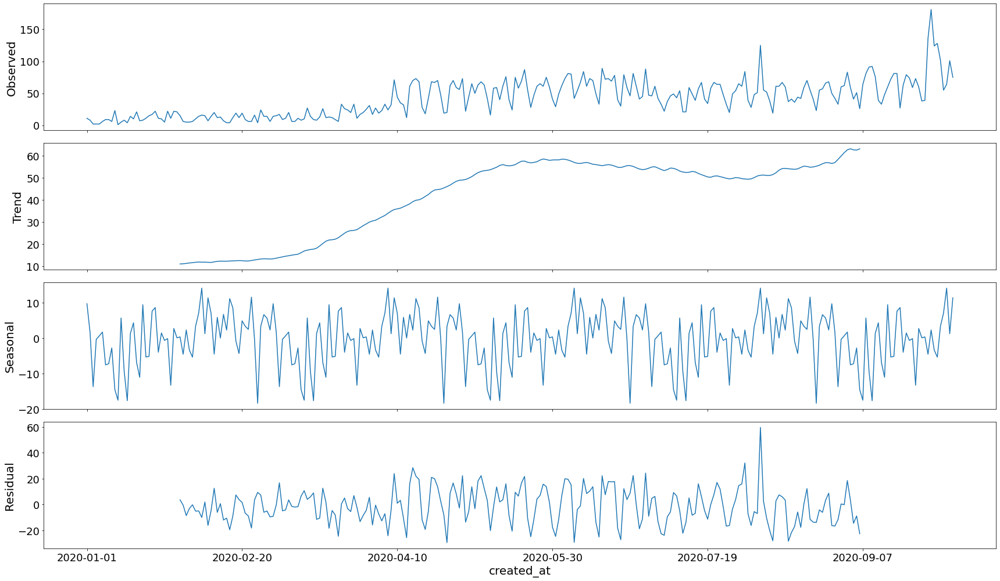

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

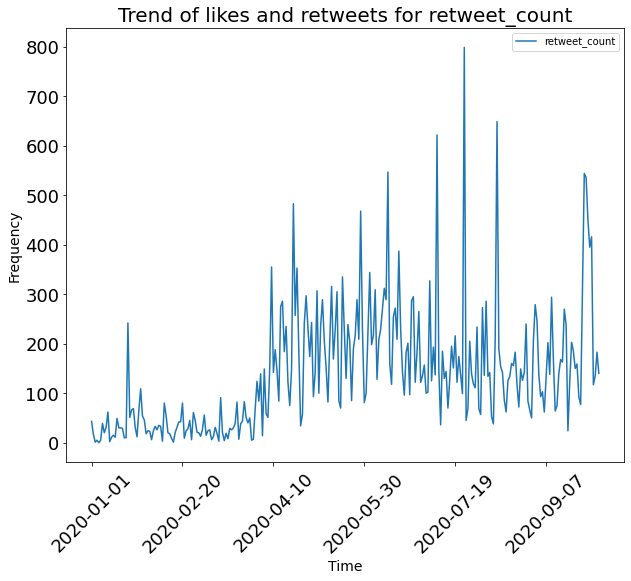

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'retweet_count')

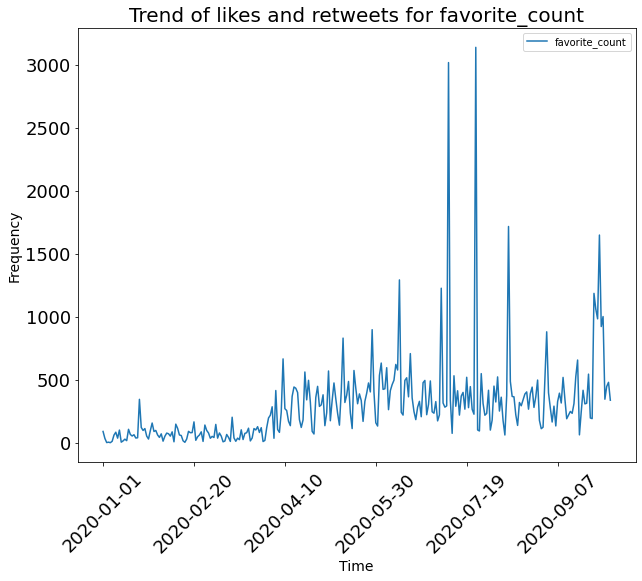

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'favorite_count')

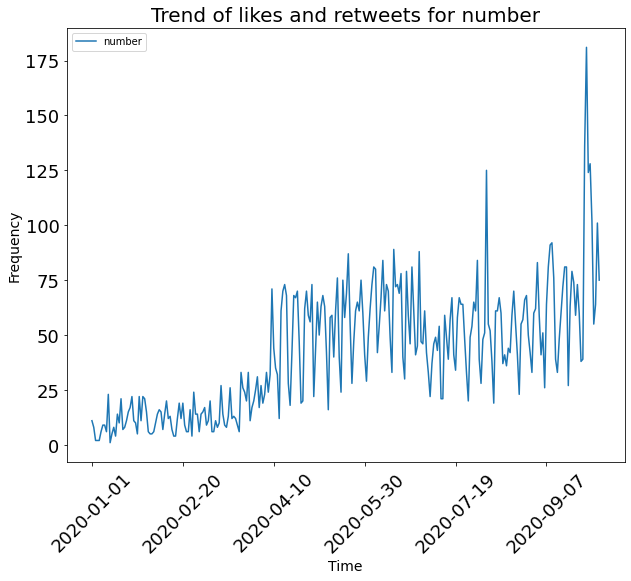

In [ ]:
Auto.Time_Trend(Covid_Number_Kenyan_Food_Tweets_Trend, 'number')

### **Government**

In [ ]:
Kenyan_Food_Tweets = Kenyan_Category_Users[Kenyan_Category_Users['group'] >= 'government' ]

### **Let us first take note of the trend before Covid in Kenya**

We forecast the trend using Autoregressive Integrated Moving Average

In [ ]:
Pre_Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Kenyan_Food_Tweets_Trend = Pre_Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

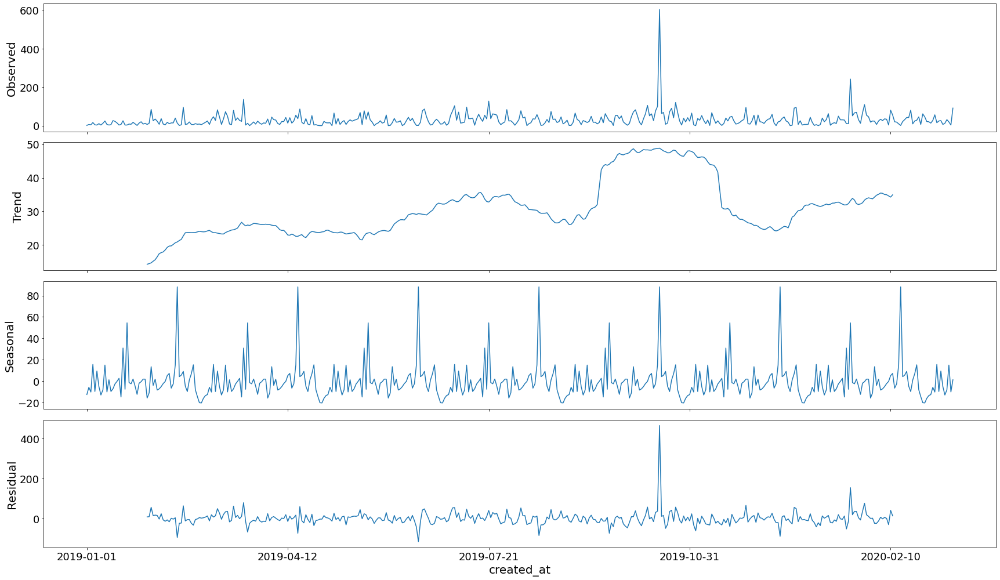

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4571.645285580174
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4402.13018322828
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4521.01348332057
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4176.621644180586
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4389.398892810106
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4294.29191643752
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4333.077464031304
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4178.352614732525
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4491.730794823886
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4351.873747316782
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4503.864731558908
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4156.453837769603
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4359.541733280456
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4275.197228781876
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4317.207494341594
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4158.3210331415885
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4566.299118128486
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4451.912289907782
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2287      0.038      6.043      0.000       0.155       0.303
ma.L1         -1.0000     12.037     -0.083      0.934     -24.591      22.591
ar.S.L12      -0.4552      0.013    -36.410      0.000      -0.480      -0.431
sigma2      2264.6823   2.73e+04      0.083      0.934   -5.12e+04    5.57e+04


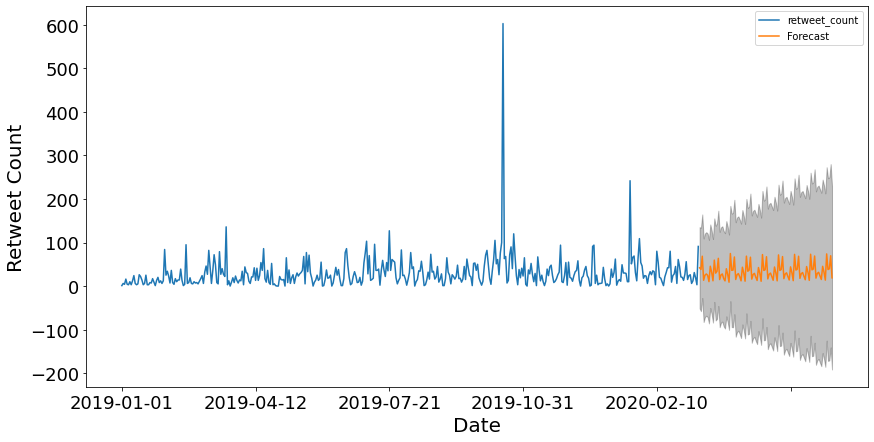

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

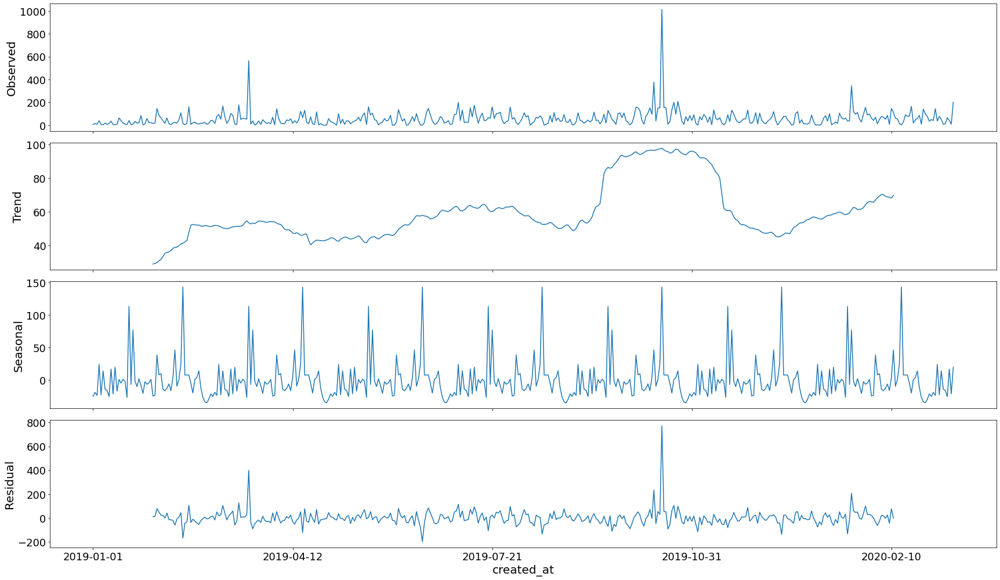

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5122.0689988227905
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4926.239549621549
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5027.767128850044
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4681.673117852892
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4909.675857796305
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4815.356060404217
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4833.8195885040295
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4682.428088491757
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5042.980296457279
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4878.92097001147
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5012.224185004192
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4662.716609579394
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4885.879664212627
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4797.737269556899
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4823.136820700551
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4663.966950653512
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5109.276133377087
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4978.939784744897
ARIMA(0, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1977      0.050      3.943      0.000       0.099       0.296
ma.L1         -1.0000     13.490     -0.074      0.941     -27.440      25.440
ar.S.L12      -0.4333      0.015    -28.053      0.000      -0.464      -0.403
sigma2      7816.0160   1.06e+05      0.074      0.941   -1.99e+05    2.15e+05


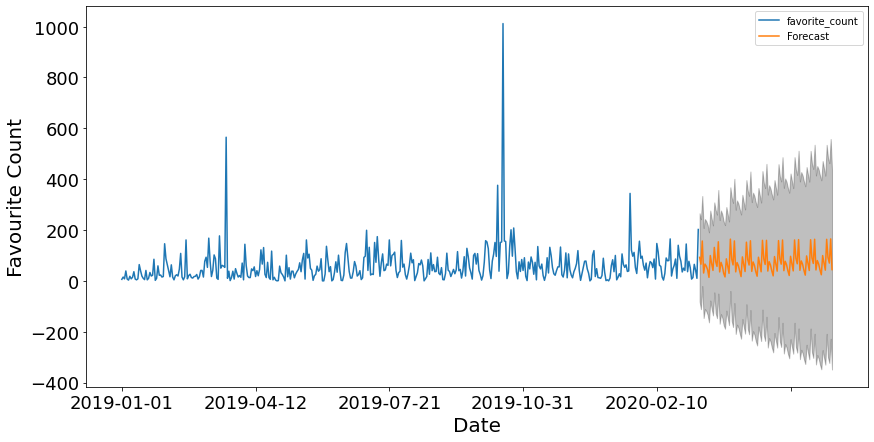

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

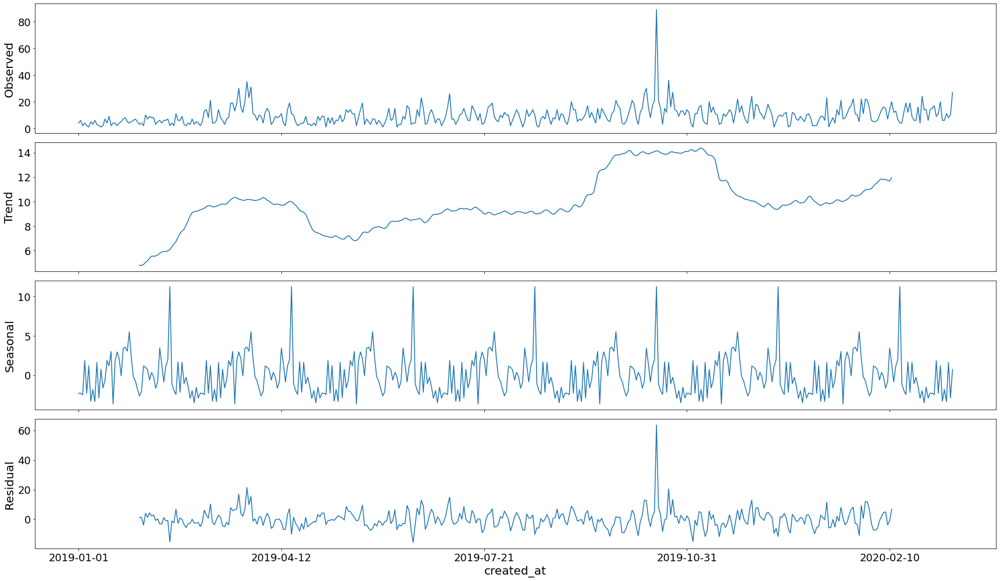

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3370.4626210762244
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3132.21586270978
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:3083.2252197529015
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2809.458298658522
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:3027.6899309622477
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2876.3057062023977
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2954.4198847577168
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2810.82631635333
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3167.3623441311374
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:3020.2968998442357
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:3049.746045250451
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2759.0962590142653
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2974.741012976846
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2829.700606788024
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2904.866282122548
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2761.0805347305495
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:3000.6966615518418
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2928.7809705367195
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Kenyan_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3923      0.036     10.933      0.000       0.322       0.463
ma.L1         -1.0000     14.137     -0.071      0.944     -28.709      26.709
ar.S.L12      -0.4641      0.018    -25.482      0.000      -0.500      -0.428
sigma2        69.5567    984.064      0.071      0.944   -1859.173    1998.287


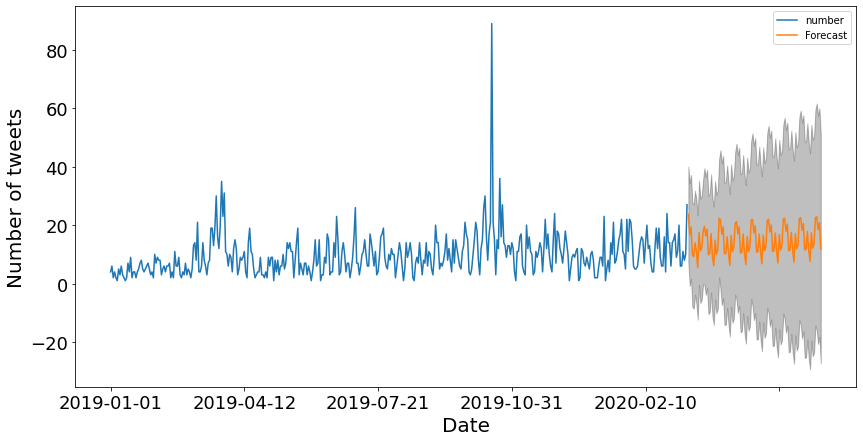

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Kenyan_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## **What happened?**

In [ ]:
Covid_Kenyan_Food_Tweets_Trend = Kenyan_Food_Tweets[Kenyan_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Kenyan_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Kenyan_Food_Tweets_Trend = Covid_Kenyan_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

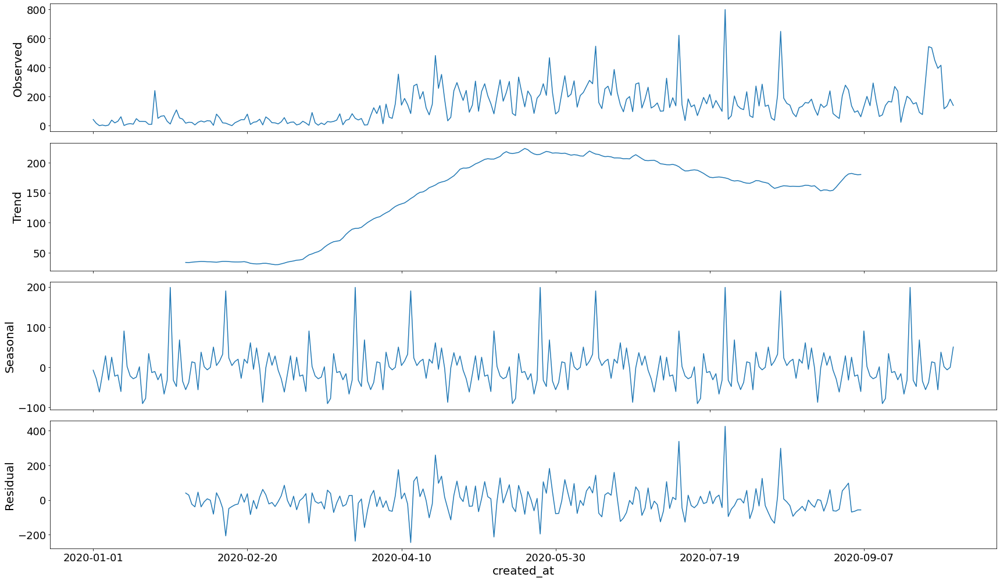

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

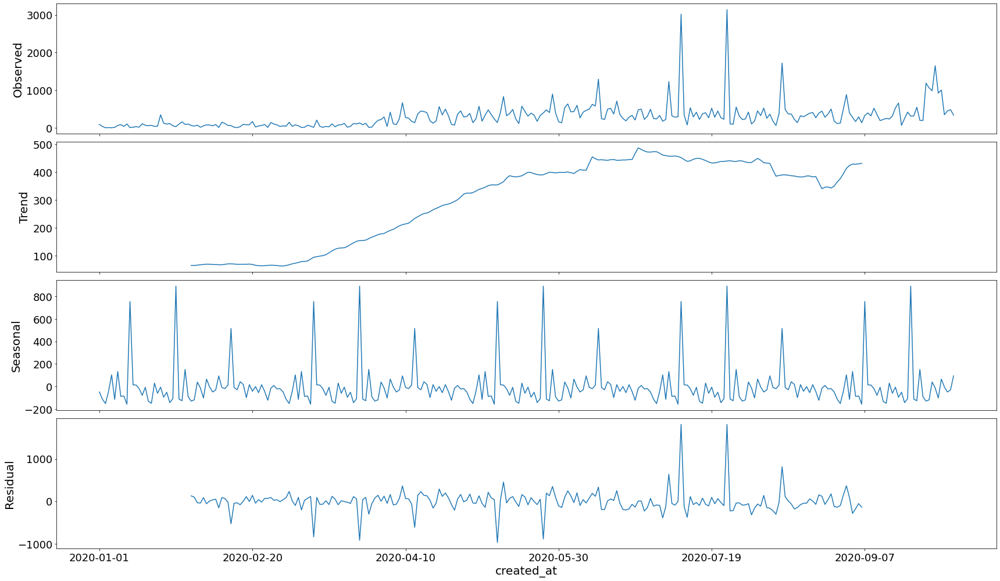

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

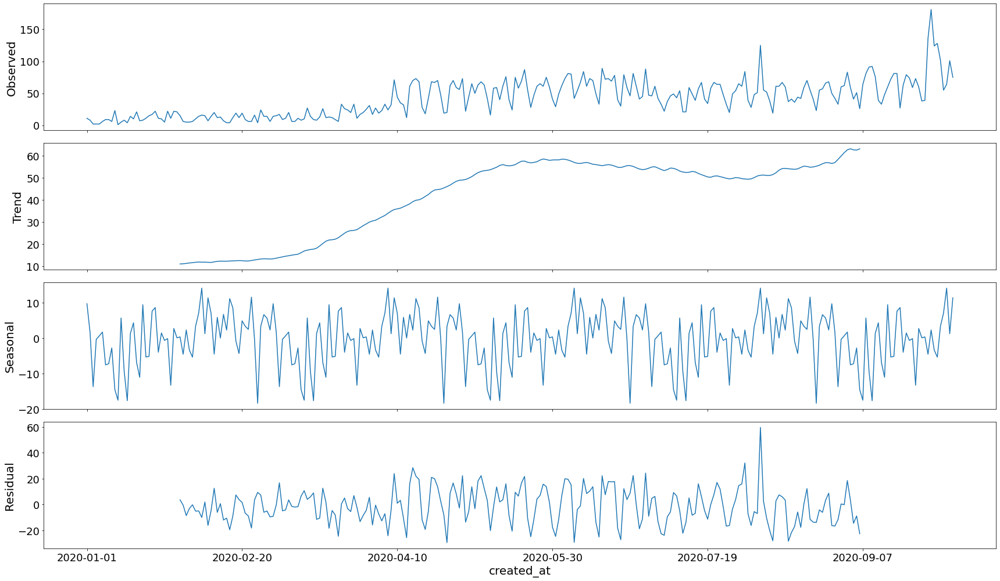

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Kenyan_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

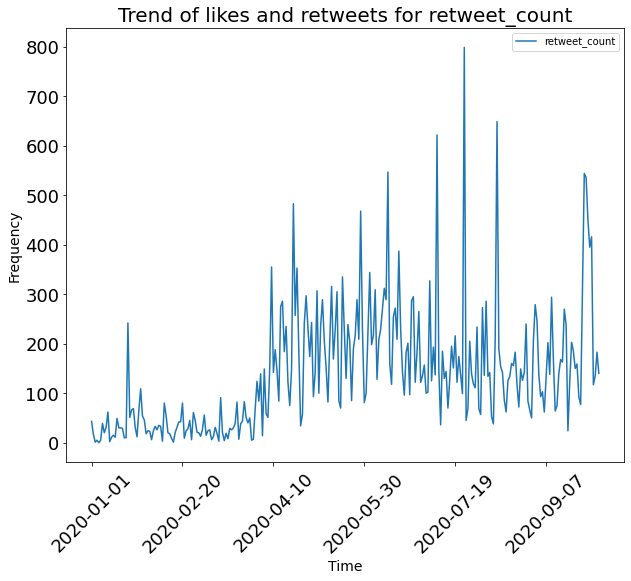

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'retweet_count')

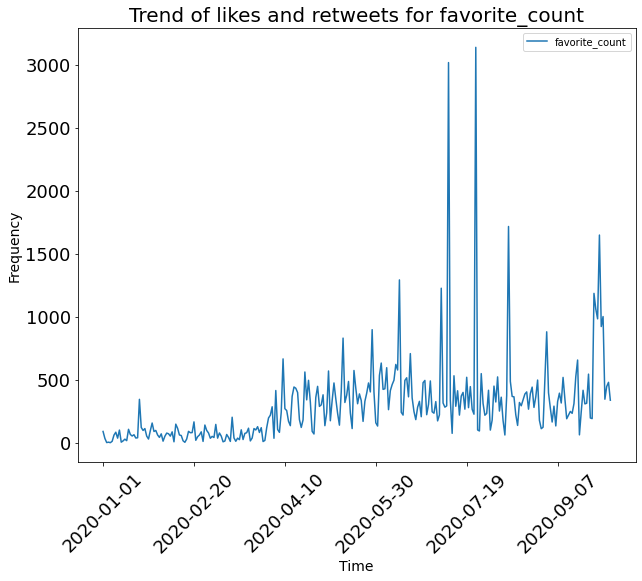

In [ ]:
Auto.Time_Trend(Covid_Kenyan_Food_Tweets_Trend, 'favorite_count')

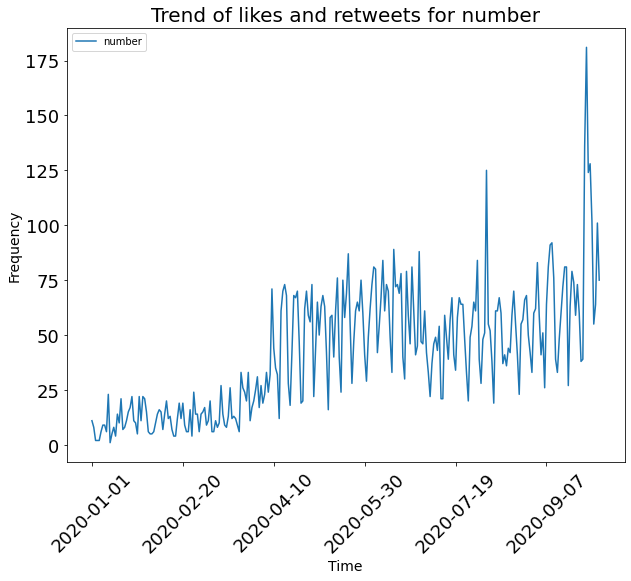

In [ ]:
Auto.Time_Trend(Covid_Number_Kenyan_Food_Tweets_Trend, 'number')

## **Nigeria**

### **General**

In [ ]:
Nigerian_Food_Tweets = Nigerian_Category_Users[Nigerian_Category_Users['group'] >= 'general' ]

## Trend before covid in nigeria

In [ ]:
Pre_Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

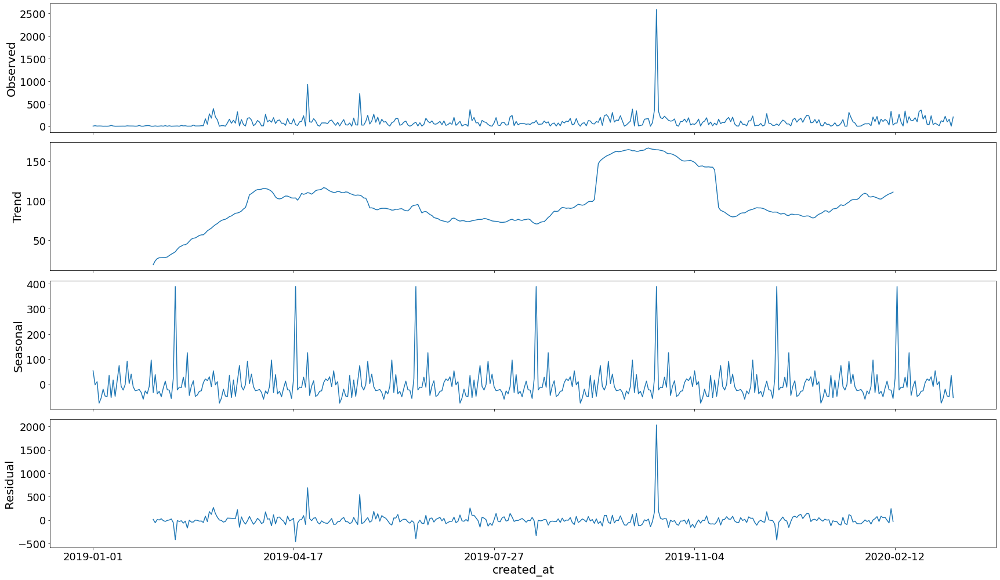

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5675.256135891653
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:5490.256999516585
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5628.8474990274735
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5270.540553505933
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:5484.96199039265
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:5422.776825275524
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:5398.5585750054615
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5271.111377619949
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5617.009443700032
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:5444.629639607583
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5606.372594907508
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5249.504111629978
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:5459.201610254934
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:5401.779050555615
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:5392.446490993771
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5249.895023351433
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5745.315392655524
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:5591.2781341905775
ARIMA(0,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1453      0.078      1.868      0.062      -0.007       0.298
ma.L1         -1.0000      0.018    -55.074      0.000      -1.036      -0.964
ar.S.L12      -0.4515      0.009    -52.588      0.000      -0.468      -0.435
sigma2      3.395e+04   5.34e-07   6.36e+10      0.000     3.4e+04     3.4e+04


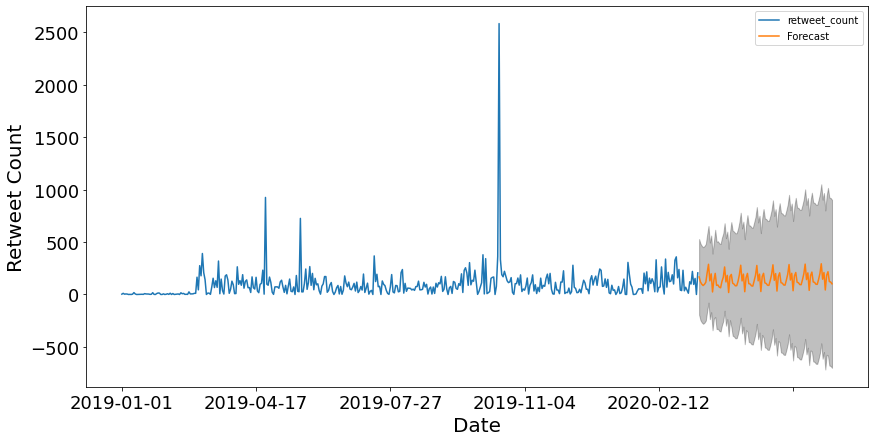

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

This is our forecast of what should happen without covid

## Favourites


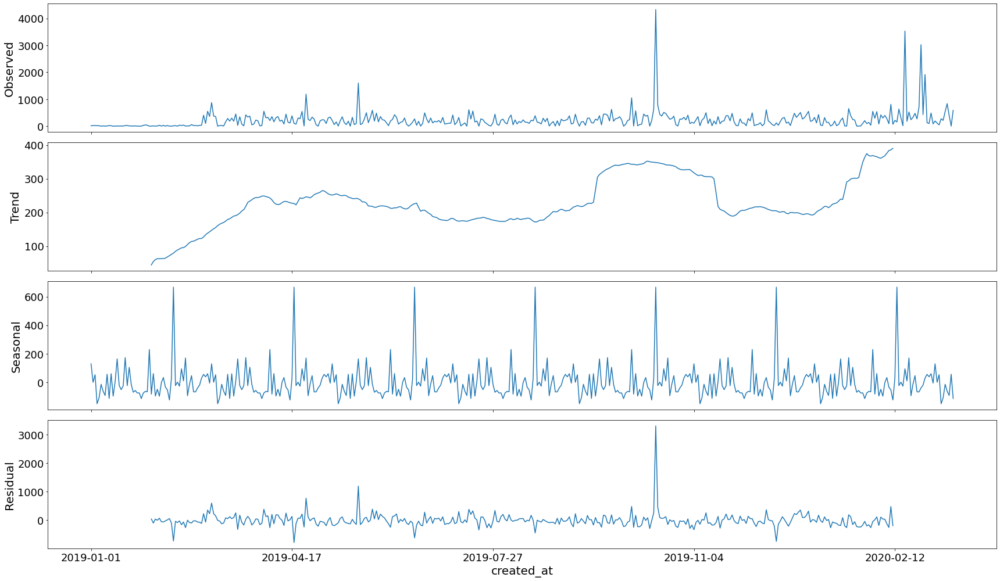

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:6413.89368862538
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:6201.948281900139
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:6324.375702242275
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5937.26162097943
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:6193.490036046263
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:6107.39557189243
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:6055.6379996715805
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5939.252352061809
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:6359.074795082574
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:6164.1512390005755
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:6309.415006634745
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5919.564900493446
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:6178.419054116324
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:6086.778062358402
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:6054.0607022988825
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5921.562354605568
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:6481.704470709523
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:6311.00499193377
ARIMA(0, 1,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1033      0.061      1.695      0.090      -0.016       0.223
ma.L1         -1.0000      0.019    -53.217      0.000      -1.037      -0.963
ar.S.L12      -0.5290      0.012    -43.009      0.000      -0.553      -0.505
sigma2      1.729e+05   1.09e-07   1.59e+12      0.000    1.73e+05    1.73e+05


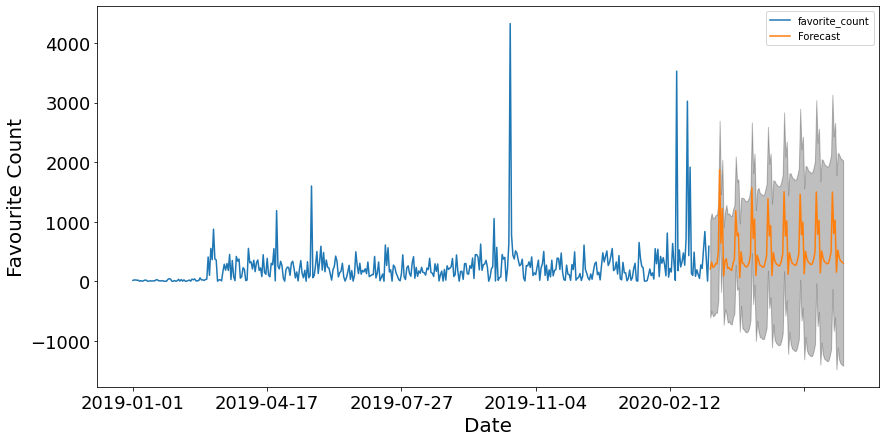

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets


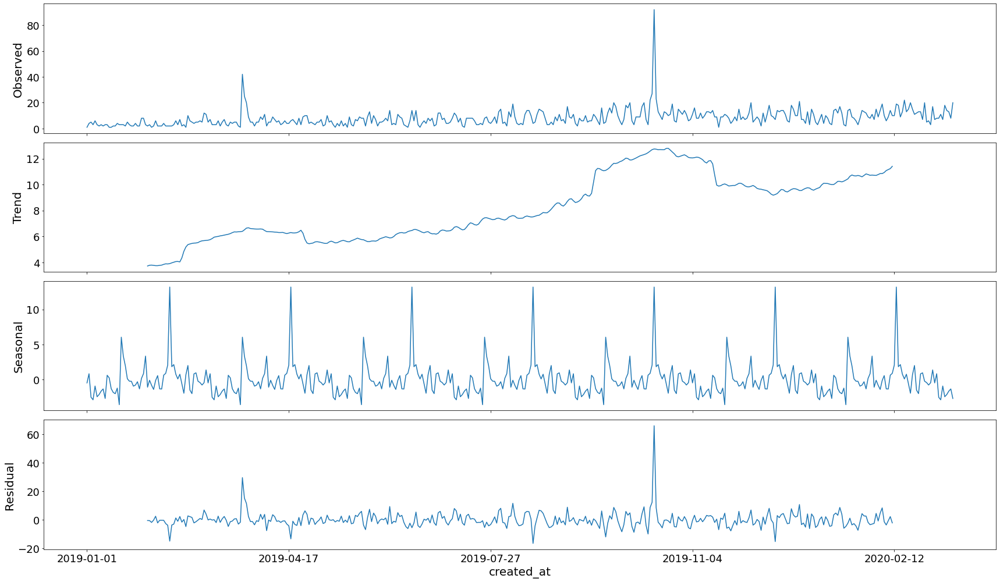

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3232.587609114499
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3026.0893681173948
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2977.0156679682
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2691.525565695346
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2916.2091892482595
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2746.6915996828734
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2813.6632725912973
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2693.5255610147465
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3031.869043959783
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2897.017382810178
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2935.9037446078473
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2640.404194711695
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2852.9775997098614
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2700.5103534925493
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2770.6001749419056
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2642.403556854868
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2897.3492608738047
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2829.3877565874755
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3415      0.035      9.726      0.000       0.273       0.410
ma.L1         -1.0000     12.671     -0.079      0.937     -25.836      23.836
ar.S.L12      -0.4924      0.013    -36.534      0.000      -0.519      -0.466
sigma2        52.6042    667.118      0.079      0.937   -1254.923    1360.131


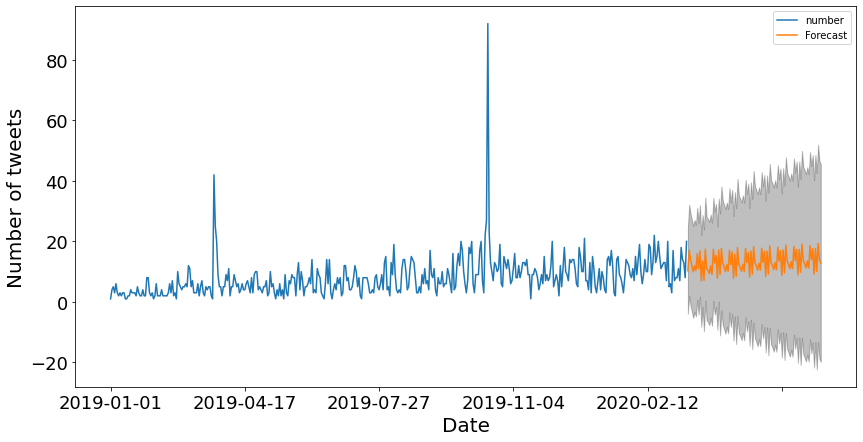

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## What happened?

In [ ]:
Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

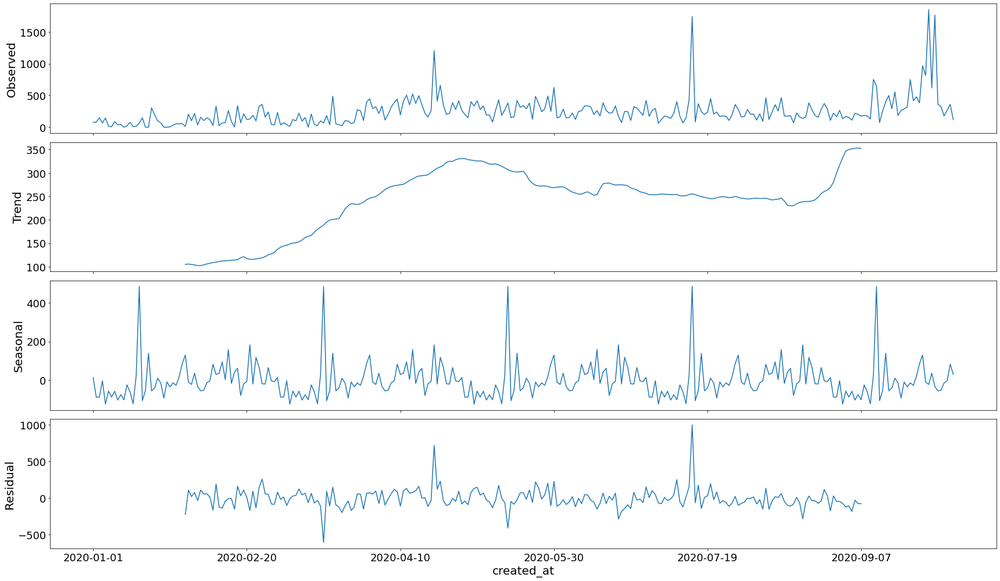

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


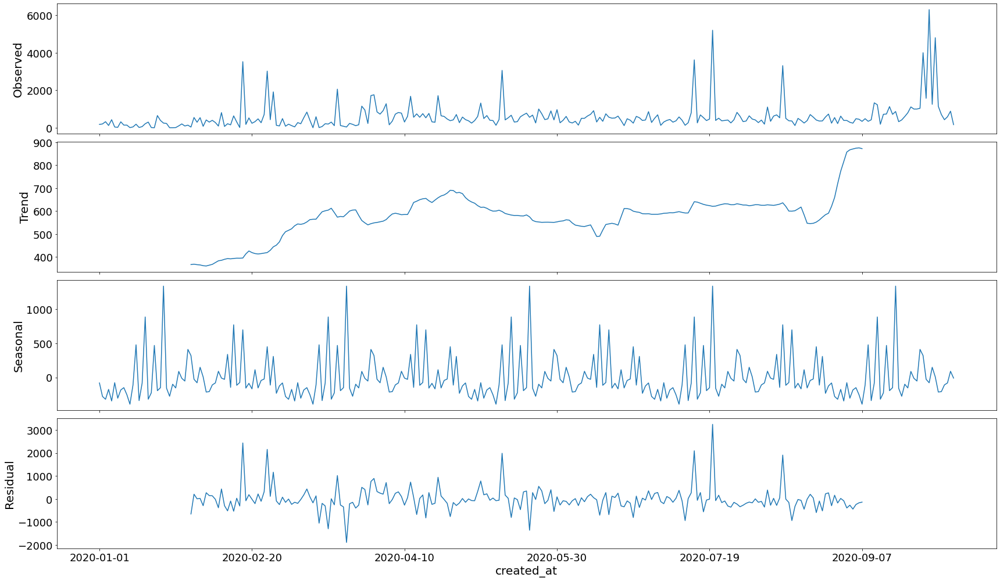

In [ ]:
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of Tweets


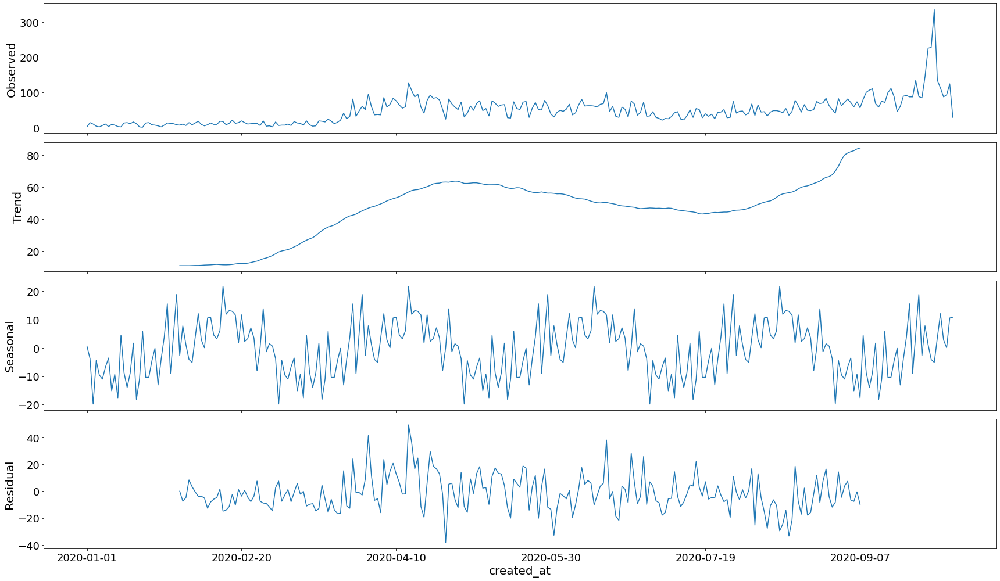

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

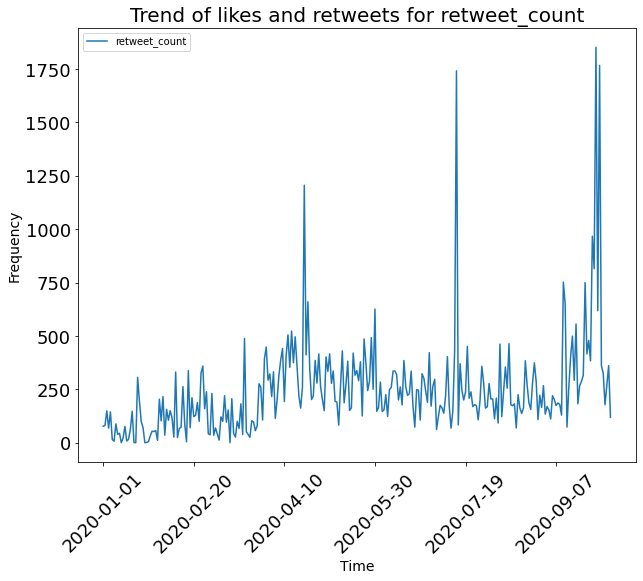

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'retweet_count')

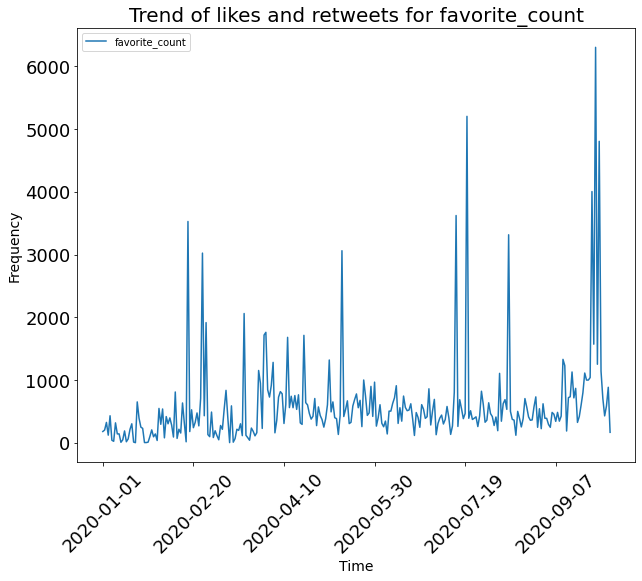

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'favorite_count')

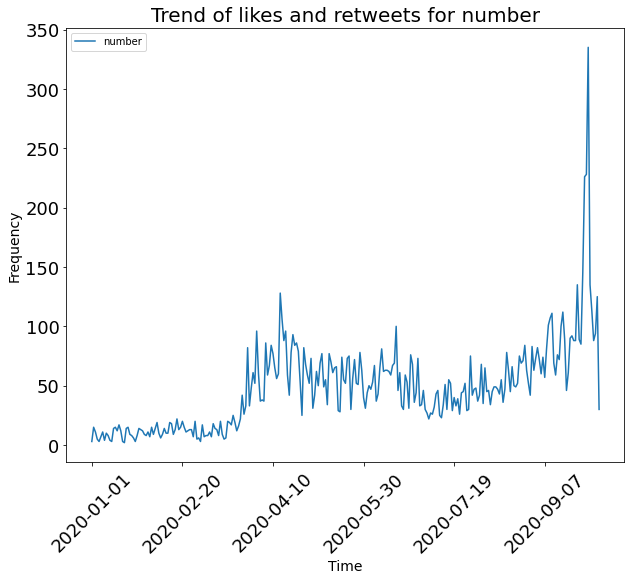

In [ ]:
Auto.Time_Trend(Covid_Number_Nigerian_Food_Tweets_Trend, 'number')

### **Private**

In [ ]:
Nigerian_Food_Tweets = Nigerian_Category_Users[Nigerian_Category_Users['group'] >= 'private' ]

## Trend before covid in nigeria

In [ ]:
Pre_Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

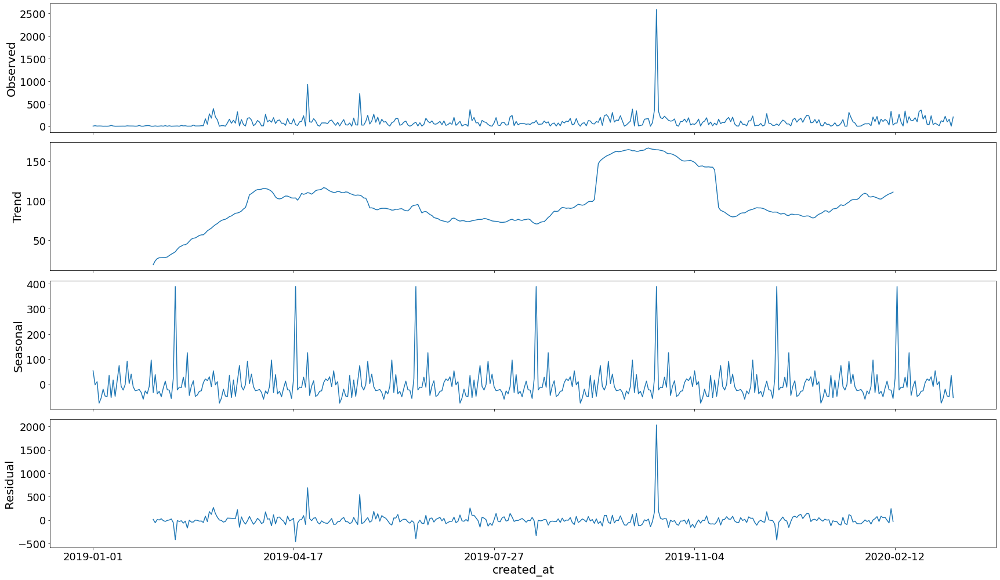

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5675.256135891653
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:5490.256999516585
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5628.8474990274735
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5270.540553505933
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:5484.96199039265
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:5422.776825275524
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:5398.5585750054615
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5271.111377619949
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5617.009443700032
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:5444.629639607583
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5606.372594907508
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5249.504111629978
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:5459.201610254934
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:5401.779050555615
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:5392.446490993771
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5249.895023351433
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5745.315392655524
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:5591.2781341905775
ARIMA(0,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1453      0.078      1.868      0.062      -0.007       0.298
ma.L1         -1.0000      0.018    -55.074      0.000      -1.036      -0.964
ar.S.L12      -0.4515      0.009    -52.588      0.000      -0.468      -0.435
sigma2      3.395e+04   5.34e-07   6.36e+10      0.000     3.4e+04     3.4e+04


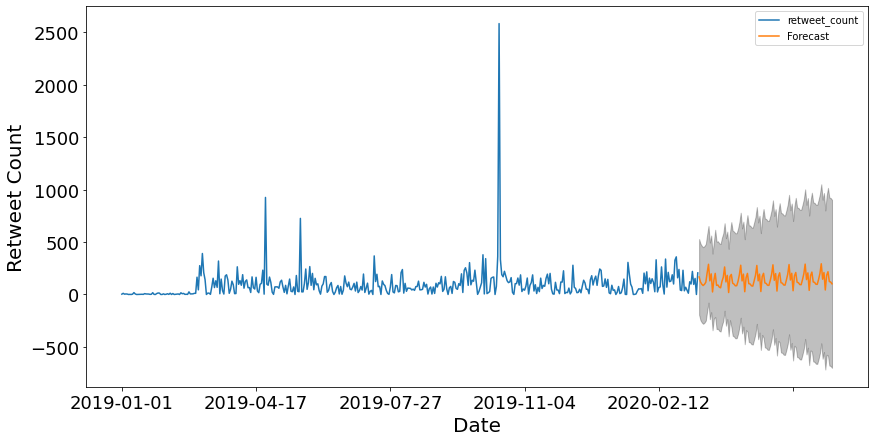

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

This is our forecast of what should happen without covid

## Favourites


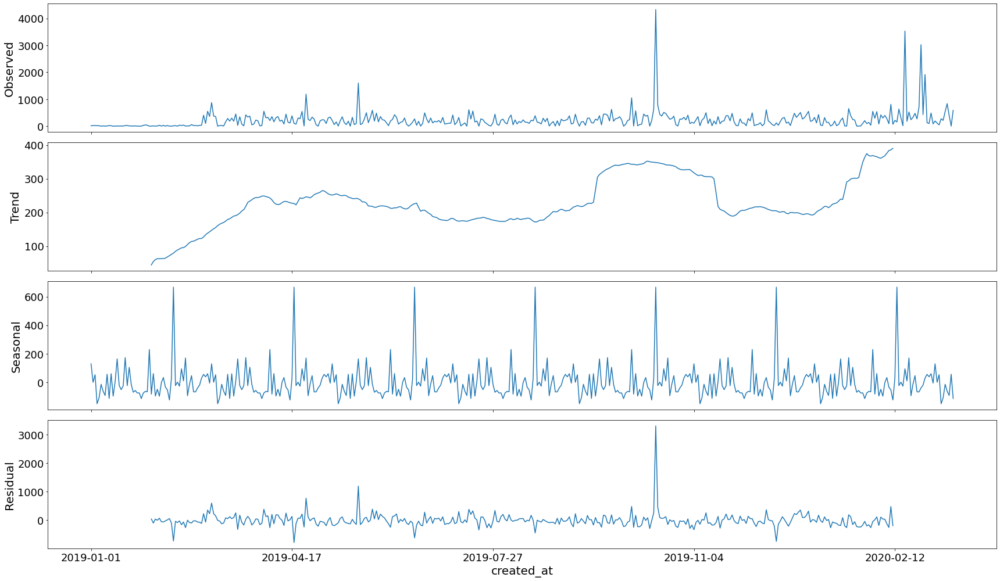

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:6413.89368862538
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:6201.948281900139
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:6324.375702242275
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5937.26162097943
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:6193.490036046263
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:6107.39557189243
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:6055.6379996715805
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5939.252352061809
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:6359.074795082574
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:6164.1512390005755
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:6309.415006634745
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5919.564900493446
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:6178.419054116324
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:6086.778062358402
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:6054.0607022988825
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5921.562354605568
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:6481.704470709523
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:6311.00499193377
ARIMA(0, 1,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1033      0.061      1.695      0.090      -0.016       0.223
ma.L1         -1.0000      0.019    -53.217      0.000      -1.037      -0.963
ar.S.L12      -0.5290      0.012    -43.009      0.000      -0.553      -0.505
sigma2      1.729e+05   1.09e-07   1.59e+12      0.000    1.73e+05    1.73e+05


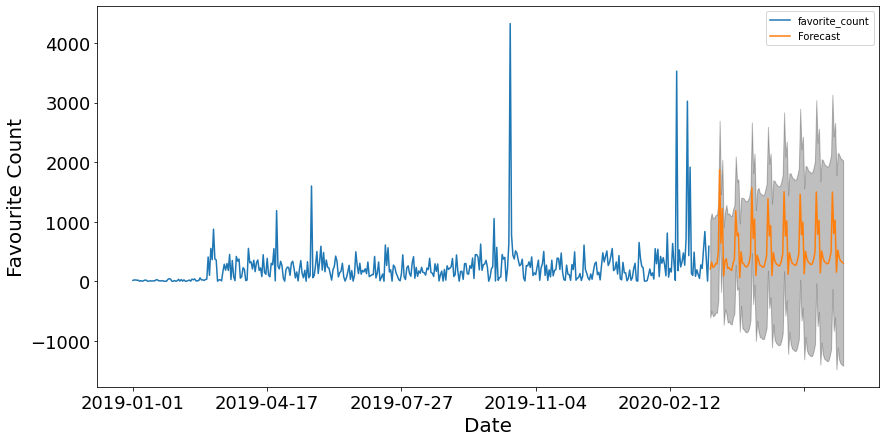

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets


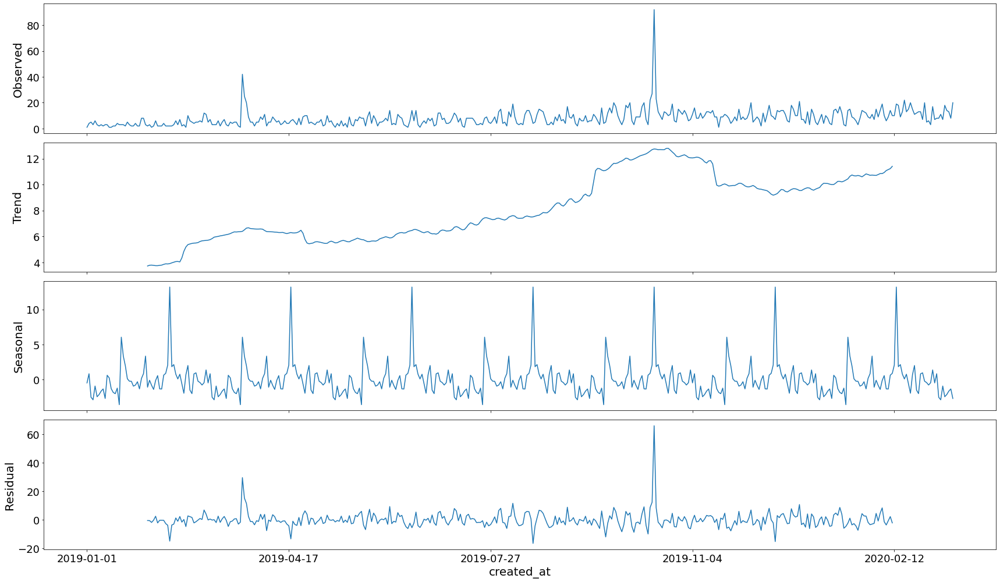

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3232.587609114499
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3026.0893681173948
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2977.0156679682
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2691.525565695346
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2916.2091892482595
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2746.6915996828734
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2813.6632725912973
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2693.5255610147465
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3031.869043959783
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2897.017382810178
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2935.9037446078473
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2640.404194711695
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2852.9775997098614
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2700.5103534925493
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2770.6001749419056
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2642.403556854868
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2897.3492608738047
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2829.3877565874755
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3415      0.035      9.726      0.000       0.273       0.410
ma.L1         -1.0000     12.671     -0.079      0.937     -25.836      23.836
ar.S.L12      -0.4924      0.013    -36.534      0.000      -0.519      -0.466
sigma2        52.6042    667.118      0.079      0.937   -1254.923    1360.131


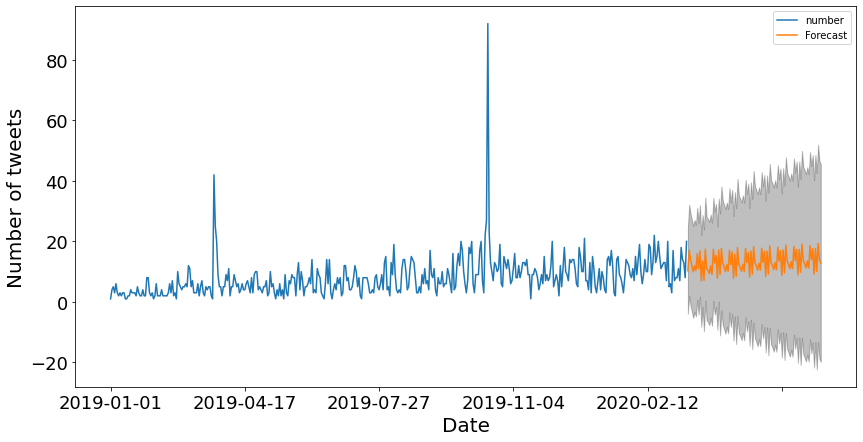

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## What happened?

In [ ]:
Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

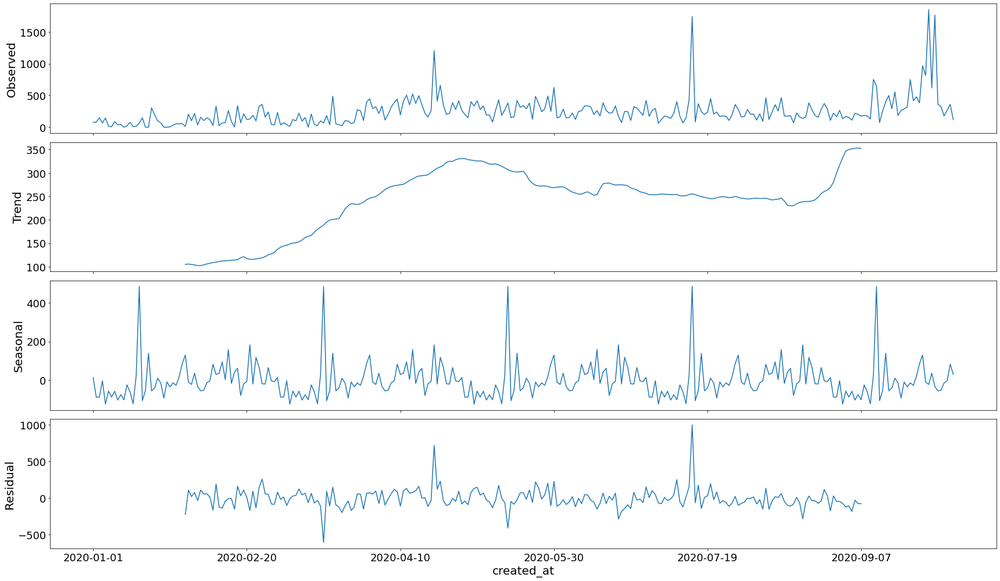

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


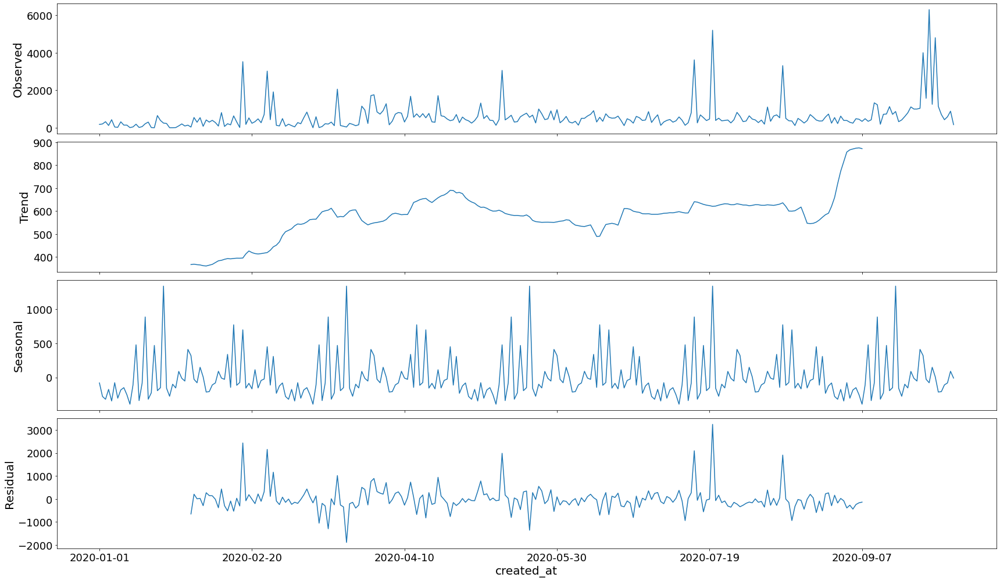

In [ ]:
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of Tweets


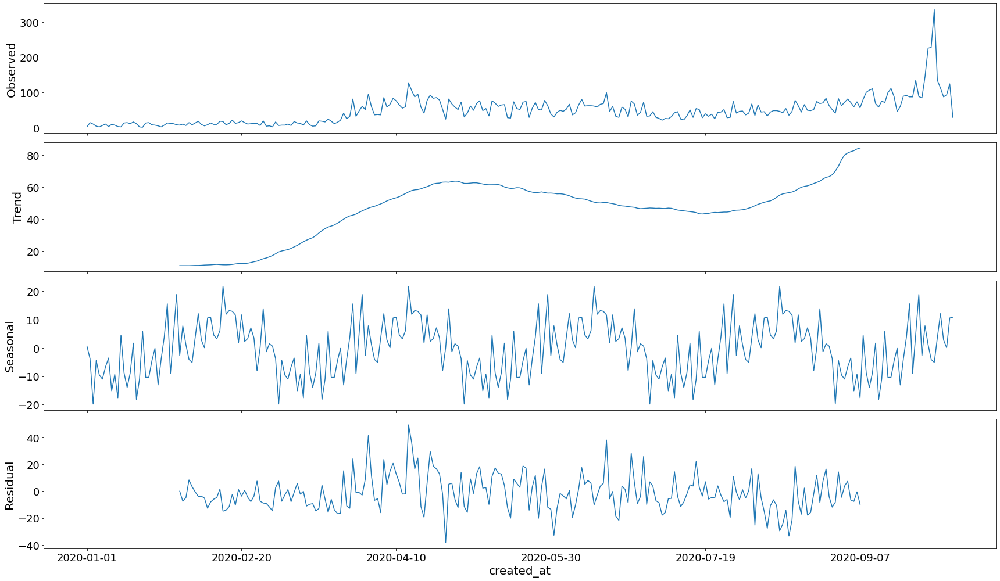

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

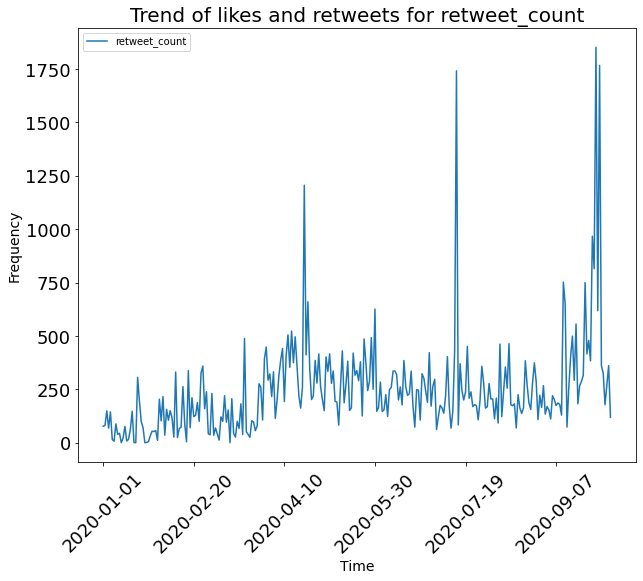

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'retweet_count')

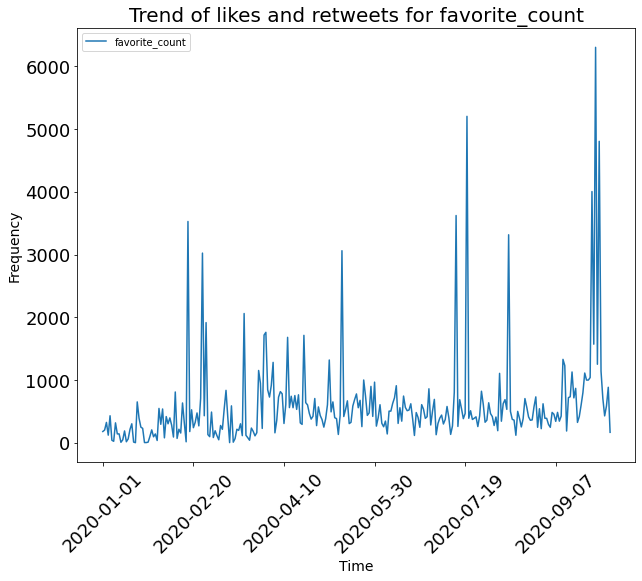

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'favorite_count')

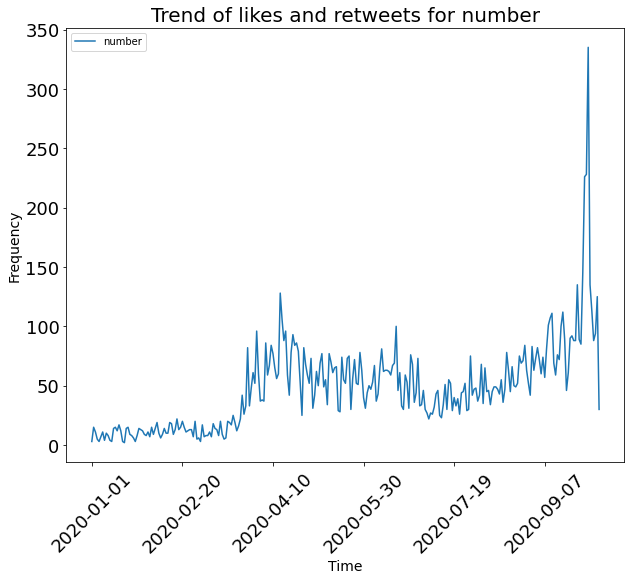

In [ ]:
Auto.Time_Trend(Covid_Number_Nigerian_Food_Tweets_Trend, 'number')

### **NGO**

In [ ]:
Nigerian_Food_Tweets = Nigerian_Category_Users[Nigerian_Category_Users['group'] >= 'NGO' ]

## Trend before covid in nigeria

In [ ]:
Pre_Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

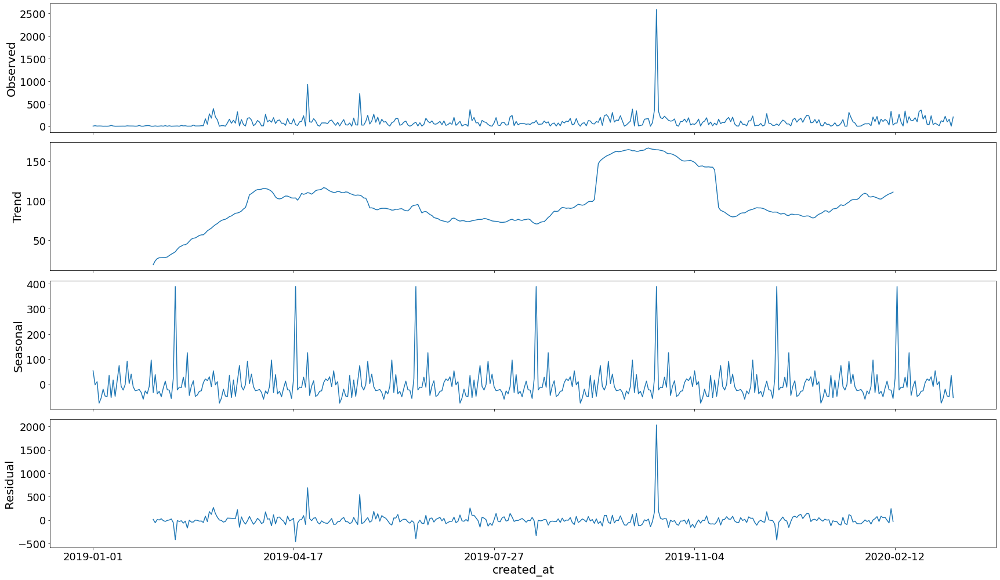

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5675.256135891653
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:5490.256999516585
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5628.8474990274735
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5270.540553505933
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:5484.96199039265
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:5422.776825275524
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:5398.5585750054615
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5271.111377619949
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5617.009443700032
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:5444.629639607583
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5606.372594907508
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5249.504111629978
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:5459.201610254934
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:5401.779050555615
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:5392.446490993771
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5249.895023351433
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5745.315392655524
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:5591.2781341905775
ARIMA(0,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1453      0.078      1.868      0.062      -0.007       0.298
ma.L1         -1.0000      0.018    -55.074      0.000      -1.036      -0.964
ar.S.L12      -0.4515      0.009    -52.588      0.000      -0.468      -0.435
sigma2      3.395e+04   5.34e-07   6.36e+10      0.000     3.4e+04     3.4e+04


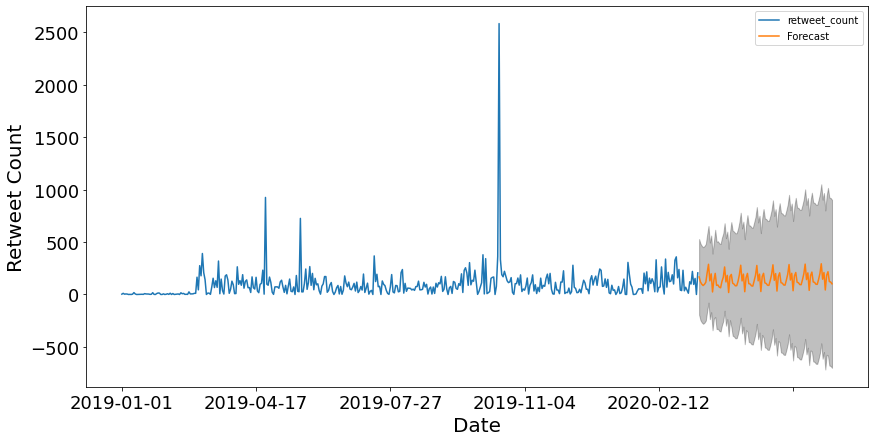

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

This is our forecast of what should happen without covid

## Favourites


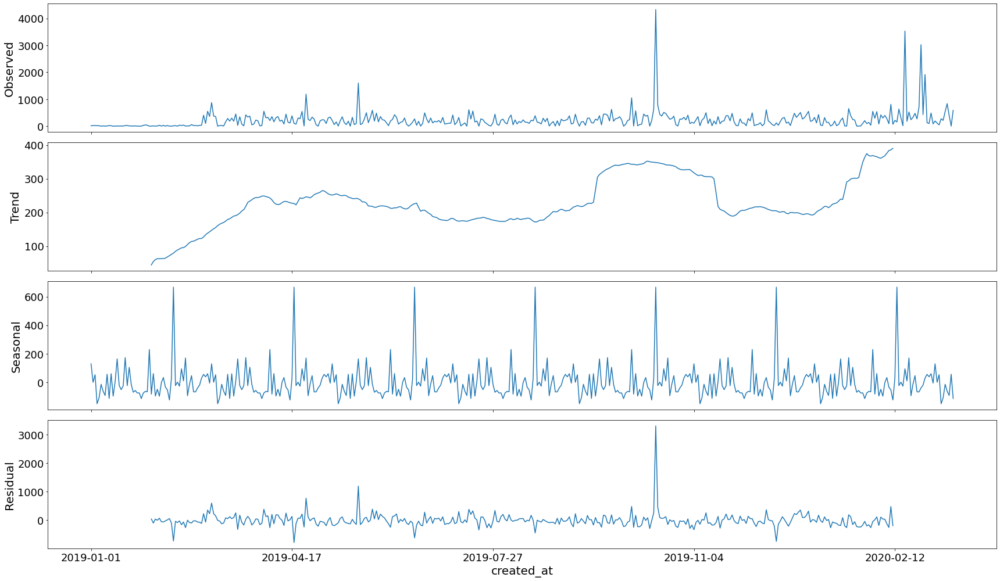

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:6413.89368862538
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:6201.948281900139
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:6324.375702242275
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5937.26162097943
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:6193.490036046263
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:6107.39557189243
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:6055.6379996715805
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5939.252352061809
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:6359.074795082574
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:6164.1512390005755
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:6309.415006634745
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5919.564900493446
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:6178.419054116324
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:6086.778062358402
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:6054.0607022988825
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5921.562354605568
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:6481.704470709523
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:6311.00499193377
ARIMA(0, 1,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1033      0.061      1.695      0.090      -0.016       0.223
ma.L1         -1.0000      0.019    -53.217      0.000      -1.037      -0.963
ar.S.L12      -0.5290      0.012    -43.009      0.000      -0.553      -0.505
sigma2      1.729e+05   1.09e-07   1.59e+12      0.000    1.73e+05    1.73e+05


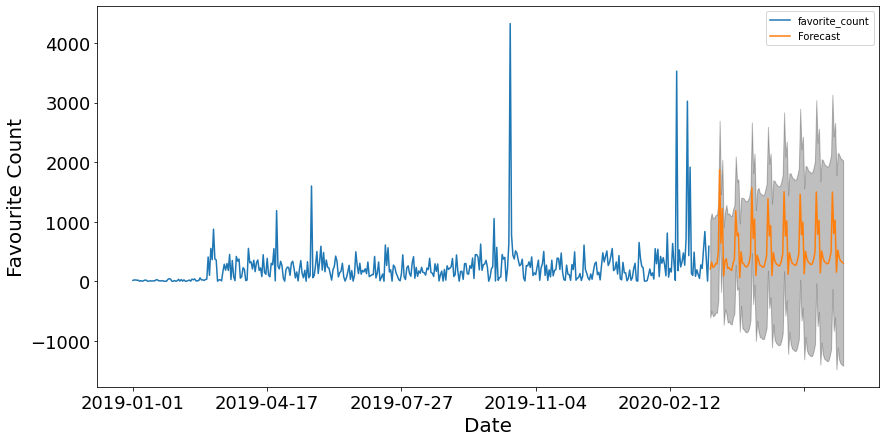

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets


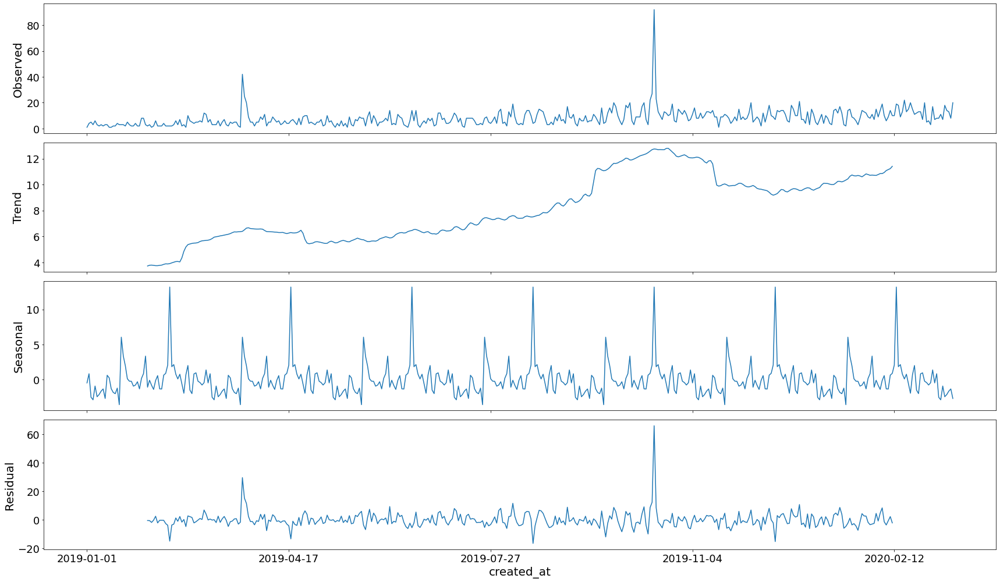

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3232.587609114499
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3026.0893681173948
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2977.0156679682
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2691.525565695346
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2916.2091892482595
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2746.6915996828734
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2813.6632725912973
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2693.5255610147465
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3031.869043959783
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2897.017382810178
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2935.9037446078473
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2640.404194711695
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2852.9775997098614
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2700.5103534925493
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2770.6001749419056
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2642.403556854868
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2897.3492608738047
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2829.3877565874755
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3415      0.035      9.726      0.000       0.273       0.410
ma.L1         -1.0000     12.671     -0.079      0.937     -25.836      23.836
ar.S.L12      -0.4924      0.013    -36.534      0.000      -0.519      -0.466
sigma2        52.6042    667.118      0.079      0.937   -1254.923    1360.131


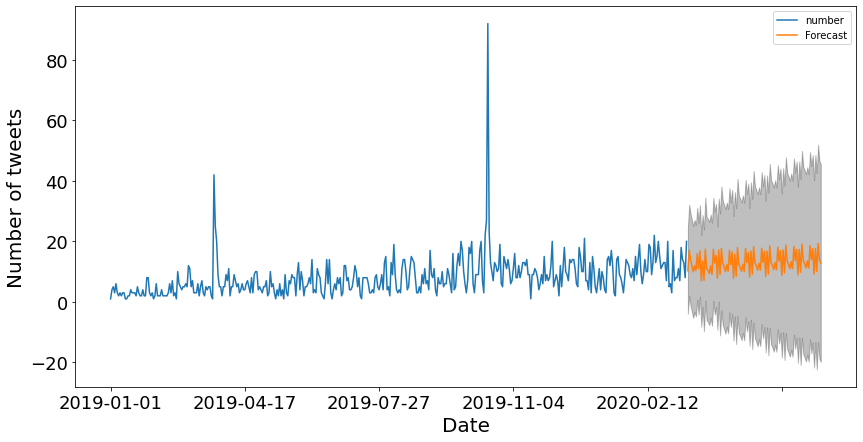

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## What happened?

In [ ]:
Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

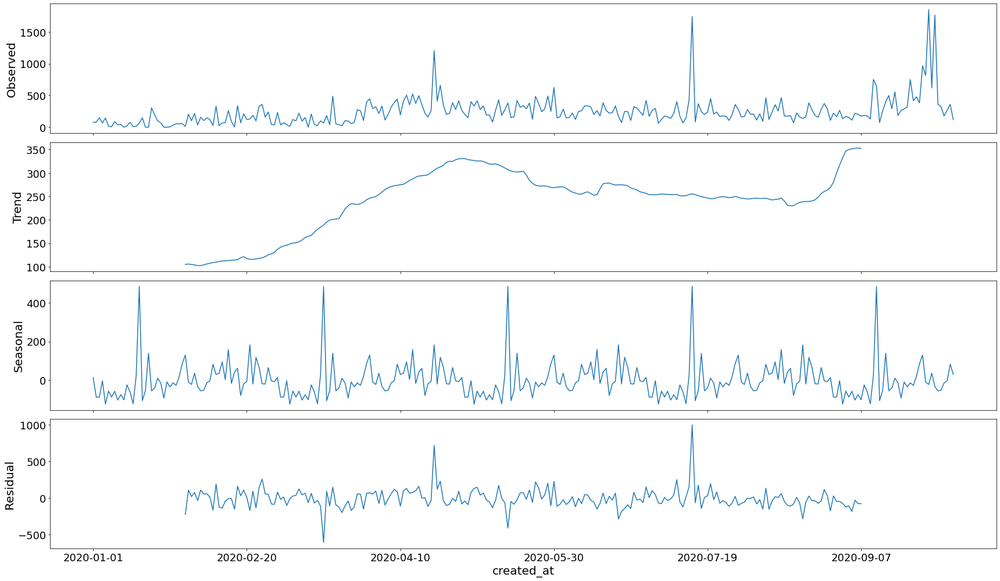

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


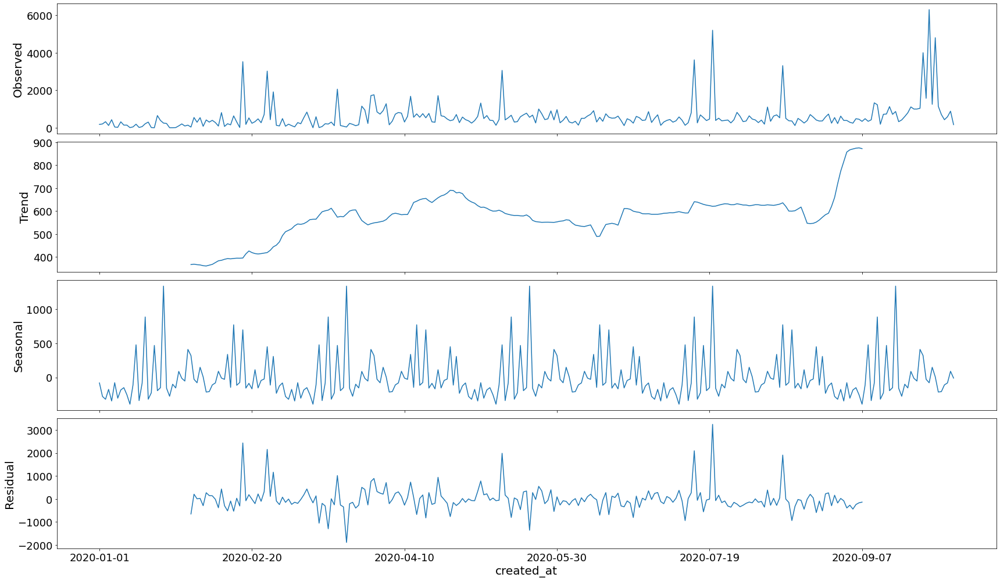

In [ ]:
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of Tweets


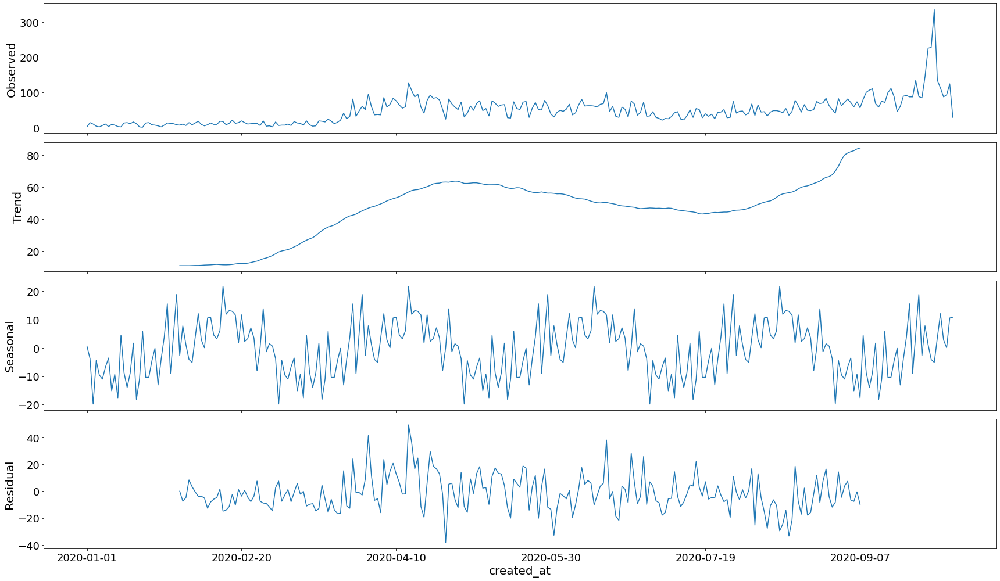

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

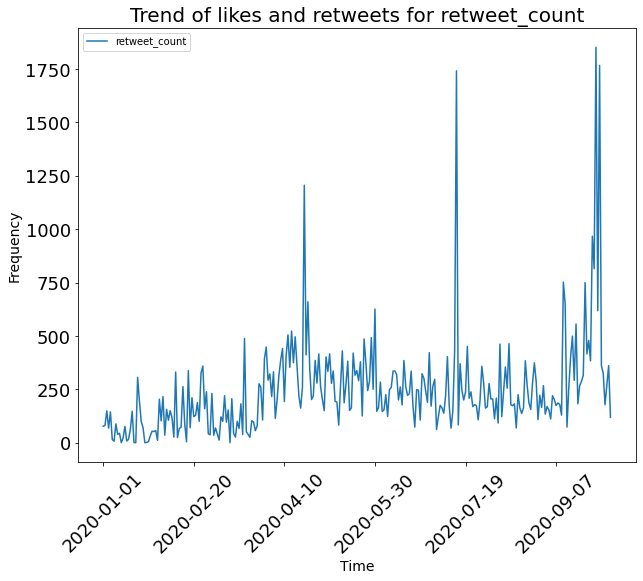

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'retweet_count')

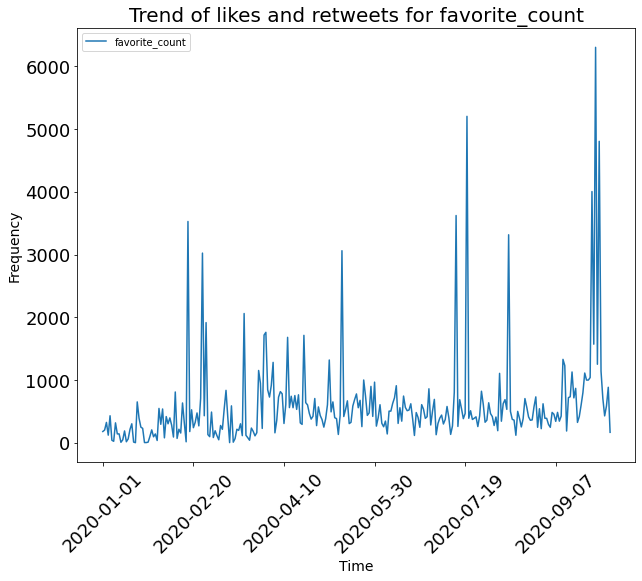

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'favorite_count')

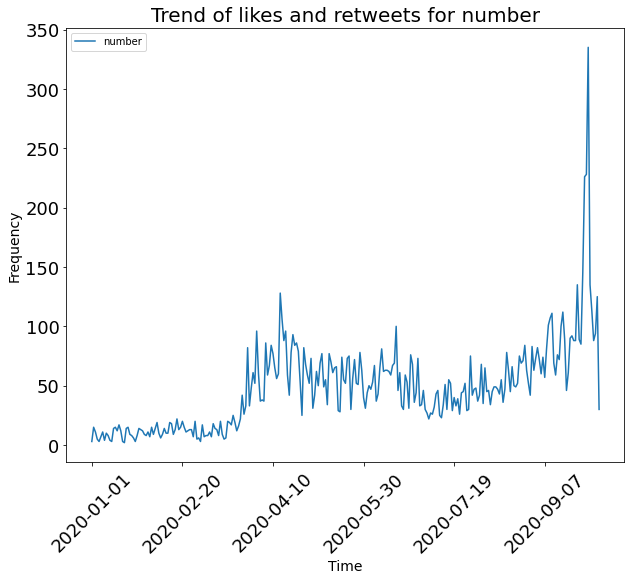

In [ ]:
Auto.Time_Trend(Covid_Number_Nigerian_Food_Tweets_Trend, 'number')

### **Government**

In [ ]:
Nigerian_Food_Tweets = Nigerian_Category_Users[Nigerian_Category_Users['group'] >= 'government' ]

## Trend before covid in nigeria

In [ ]:
Pre_Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_Nigerian_Food_Tweets_Trend = Pre_Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

In [ ]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

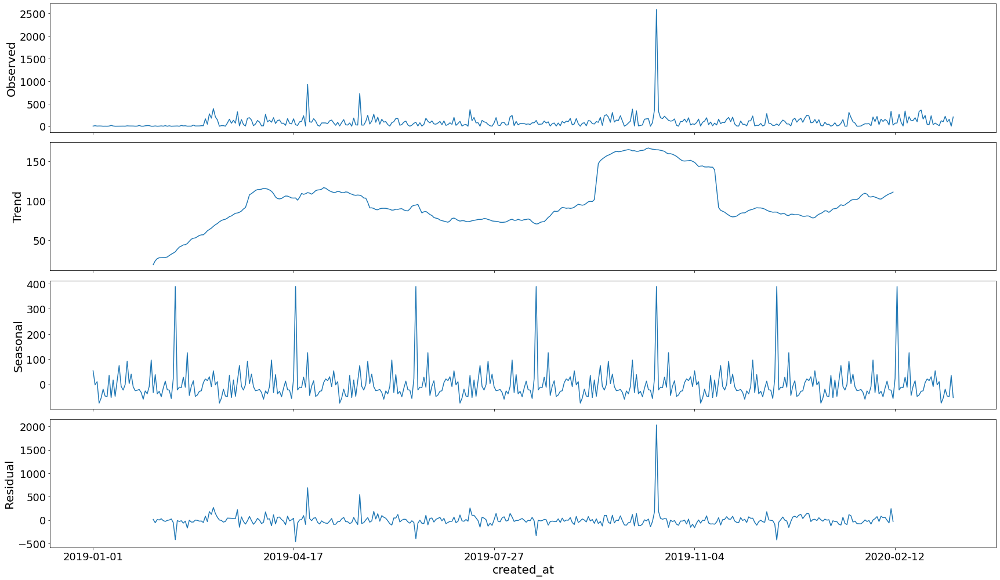

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:5675.256135891653
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:5490.256999516585
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:5628.8474990274735
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5270.540553505933
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:5484.96199039265
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:5422.776825275524
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:5398.5585750054615
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5271.111377619949
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:5617.009443700032
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:5444.629639607583
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:5606.372594907508
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5249.504111629978
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:5459.201610254934
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:5401.779050555615
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:5392.446490993771
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5249.895023351433
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:5745.315392655524
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:5591.2781341905775
ARIMA(0,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1453      0.078      1.868      0.062      -0.007       0.298
ma.L1         -1.0000      0.018    -55.074      0.000      -1.036      -0.964
ar.S.L12      -0.4515      0.009    -52.588      0.000      -0.468      -0.435
sigma2      3.395e+04   5.34e-07   6.36e+10      0.000     3.4e+04     3.4e+04


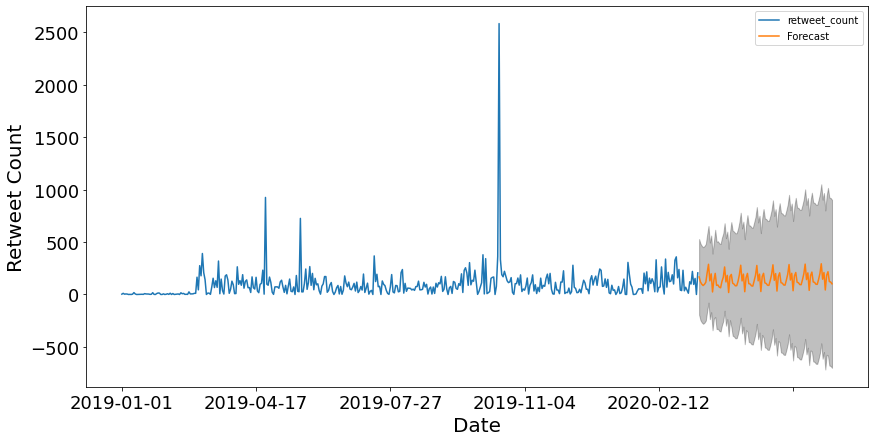

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

This is our forecast of what should happen without covid

## Favourites


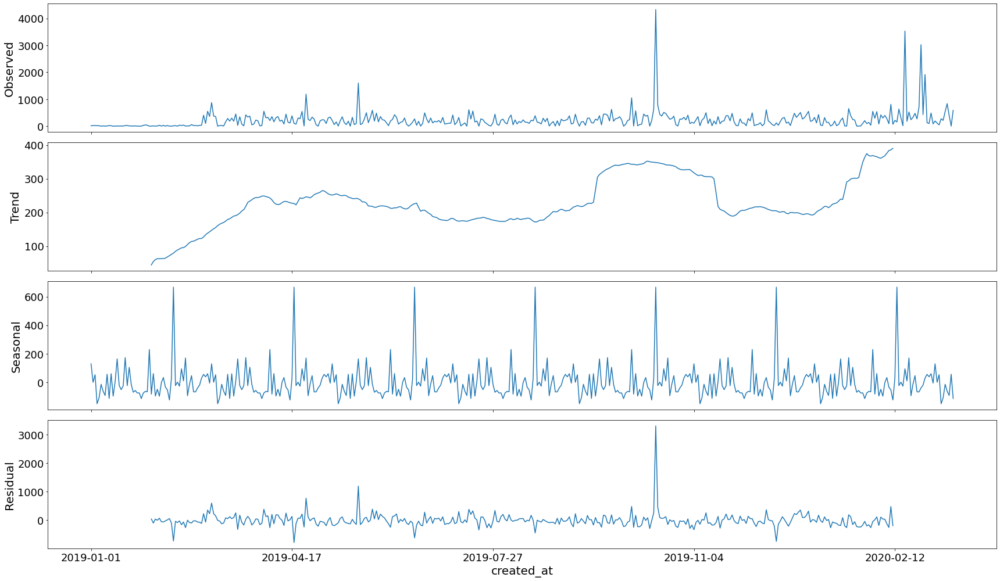

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:6413.89368862538
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:6201.948281900139
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:6324.375702242275
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:5937.26162097943
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:6193.490036046263
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:6107.39557189243
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:6055.6379996715805
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:5939.252352061809
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:6359.074795082574
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:6164.1512390005755
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:6309.415006634745
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:5919.564900493446
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:6178.419054116324
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:6086.778062358402
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:6054.0607022988825
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:5921.562354605568
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:6481.704470709523
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:6311.00499193377
ARIMA(0, 1,

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1033      0.061      1.695      0.090      -0.016       0.223
ma.L1         -1.0000      0.019    -53.217      0.000      -1.037      -0.963
ar.S.L12      -0.5290      0.012    -43.009      0.000      -0.553      -0.505
sigma2      1.729e+05   1.09e-07   1.59e+12      0.000    1.73e+05    1.73e+05


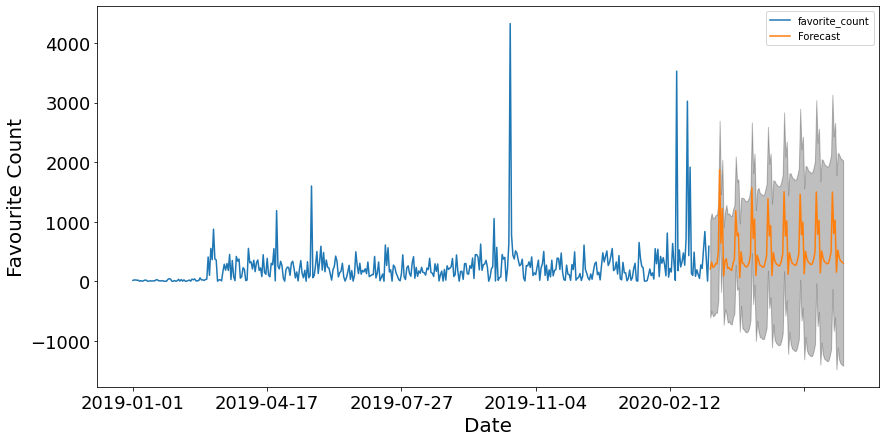

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets


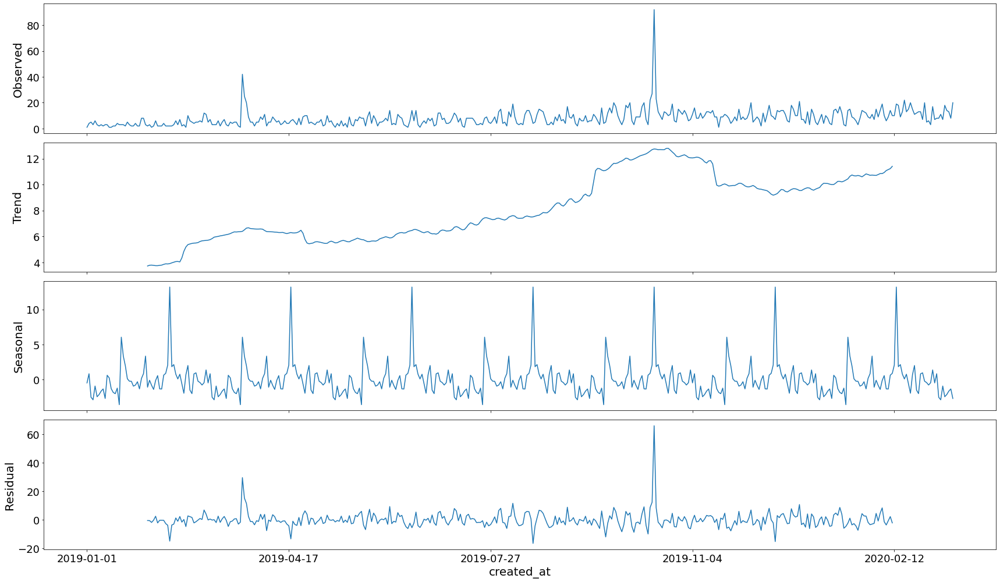

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3232.587609114499
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:3026.0893681173948
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2977.0156679682
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2691.525565695346
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2916.2091892482595
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2746.6915996828734
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2813.6632725912973
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2693.5255610147465
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:3031.869043959783
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2897.017382810178
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2935.9037446078473
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2640.404194711695
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2852.9775997098614
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2700.5103534925493
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2770.6001749419056
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2642.403556854868
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2897.3492608738047
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2829.3877565874755
A

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_Nigerian_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3415      0.035      9.726      0.000       0.273       0.410
ma.L1         -1.0000     12.671     -0.079      0.937     -25.836      23.836
ar.S.L12      -0.4924      0.013    -36.534      0.000      -0.519      -0.466
sigma2        52.6042    667.118      0.079      0.937   -1254.923    1360.131


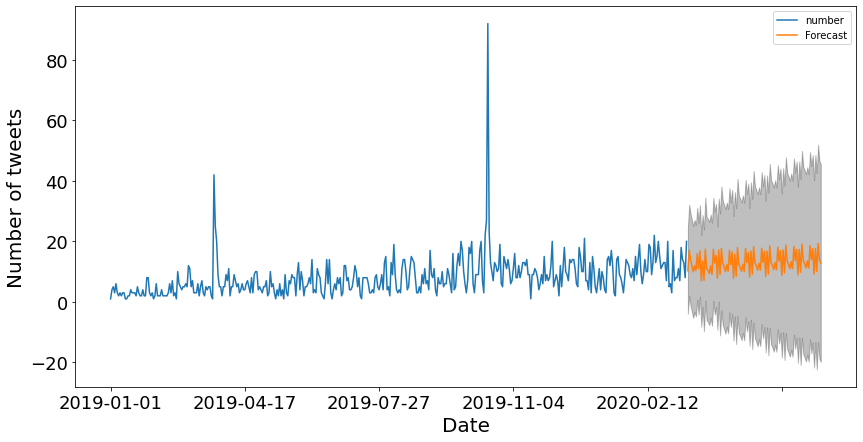

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_Nigerian_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## What happened?

In [ ]:
Covid_Nigerian_Food_Tweets_Trend = Nigerian_Food_Tweets[Nigerian_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_Nigerian_Food_Tweets_Trend['number'] = 1

Covid_Retweet_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_Nigerian_Food_Tweets_Trend = Covid_Nigerian_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

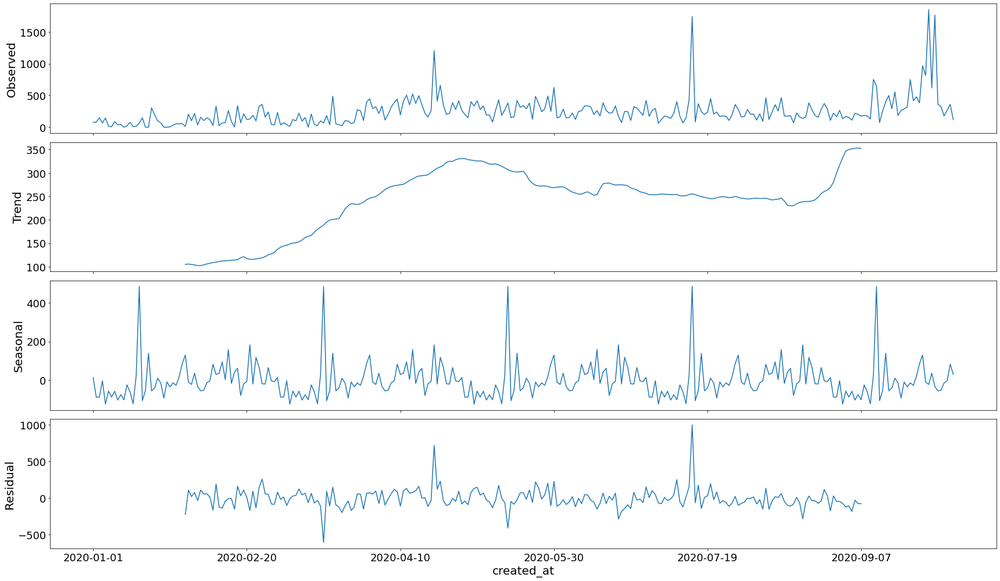

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


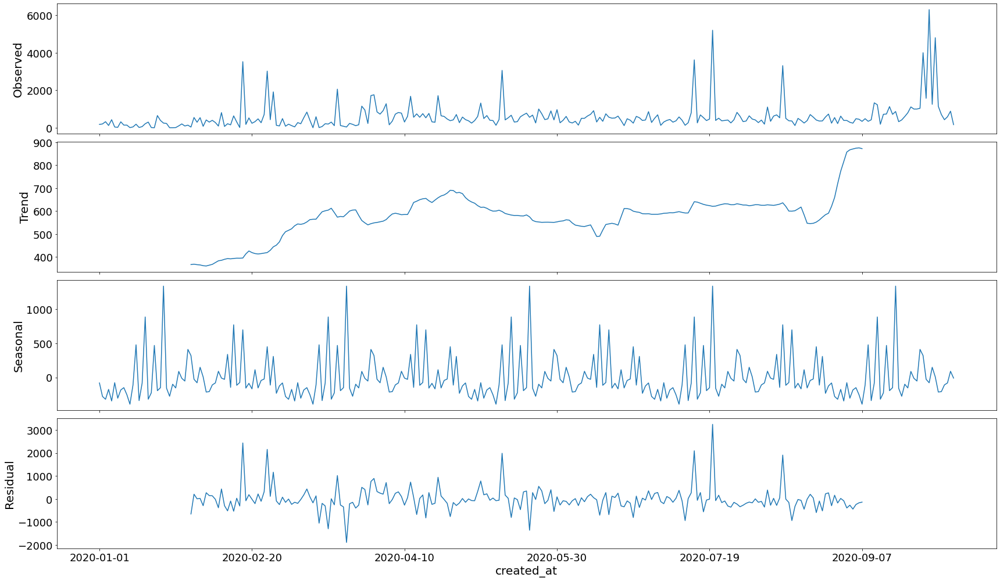

In [ ]:
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of Tweets


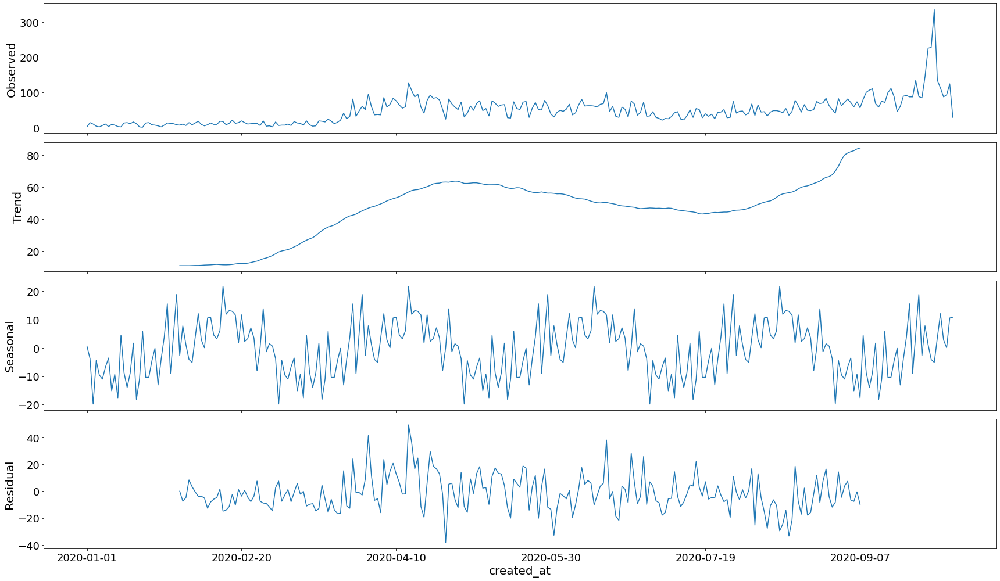

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_Nigerian_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

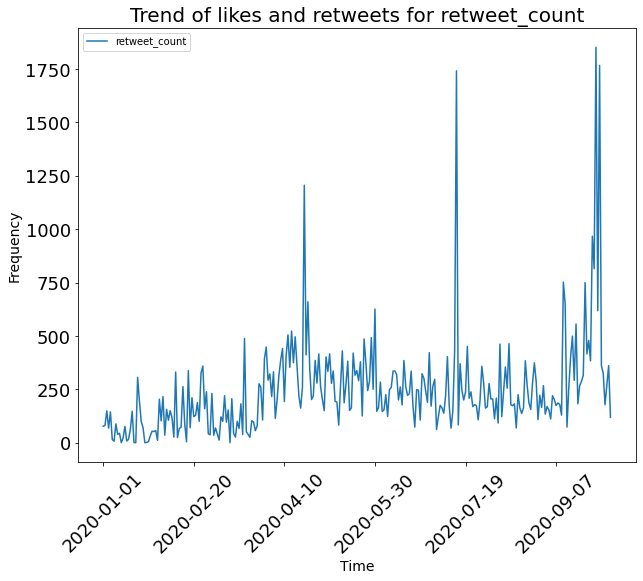

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'retweet_count')

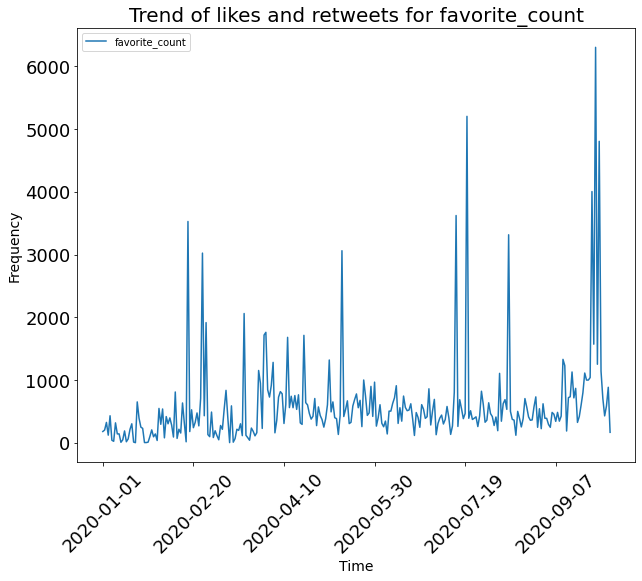

In [ ]:
Auto.Time_Trend(Covid_Nigerian_Food_Tweets_Trend, 'favorite_count')

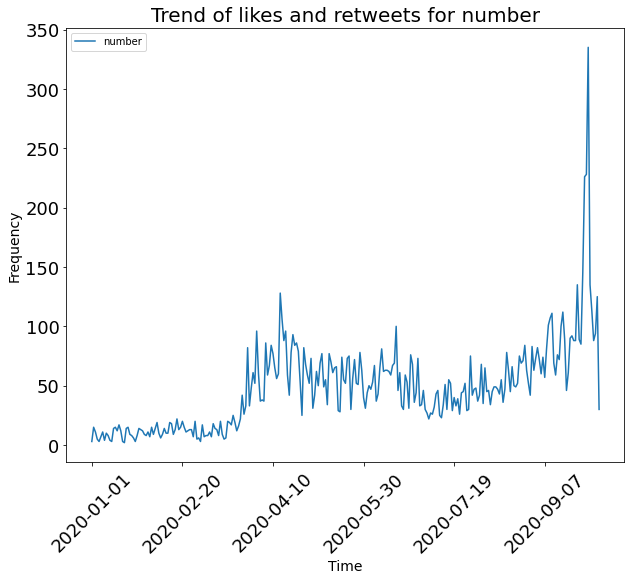

In [ ]:
Auto.Time_Trend(Covid_Number_Nigerian_Food_Tweets_Trend, 'number')

## **South Africa**

### **General**

In [ ]:
South_African_Food_Tweets = South_African_Category_Users[South_African_Category_Users['group'] >= 'general' ]

## Trend before Covid


In [ ]:
Pre_Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_South_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## retweets

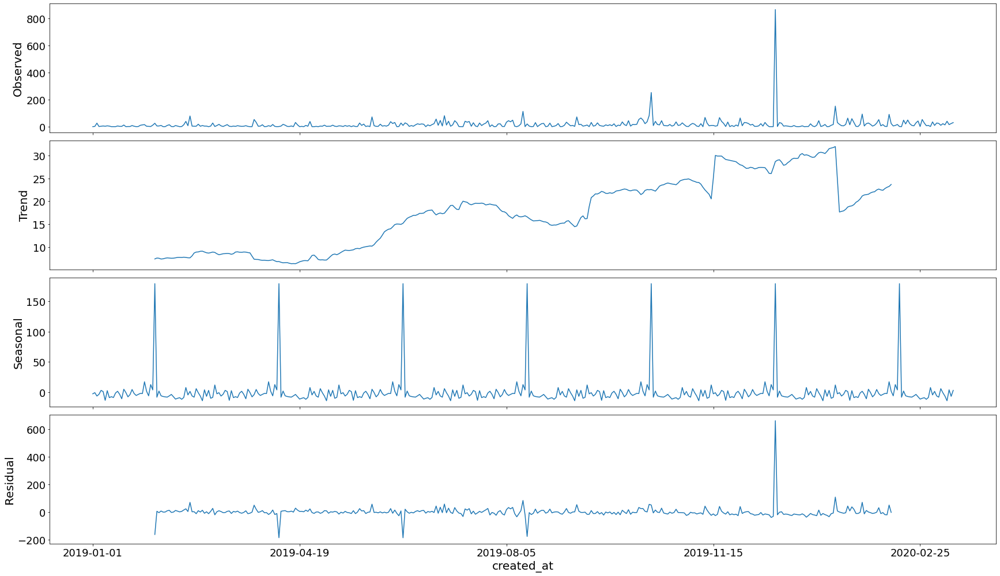

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_South_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4439.804404430596
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4321.610320694489
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4557.7962169447
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4182.126056729081
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4330.597481183428
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4306.821491053336
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4335.38920859188
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4183.707981256526
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4427.494903183039
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4310.558801183247
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4549.514086963411
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4174.409420603185
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4329.475069875314
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4299.185532910629
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4337.370648359914
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4175.951620068847
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4665.71072978095
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4544.271721793793
ARIMA(0, 1, 0)

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0081      0.092      0.088      0.930      -0.173       0.189
ma.L1         -1.0000     19.181     -0.052      0.958     -38.595      36.595
ar.S.L12      -0.4966      0.011    -46.604      0.000      -0.518      -0.476
sigma2      3598.7457   6.91e+04      0.052      0.958   -1.32e+05    1.39e+05


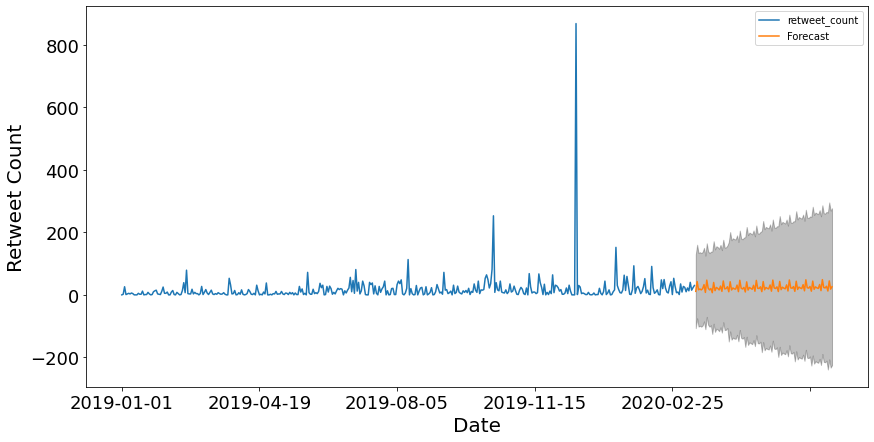

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

## Favorites

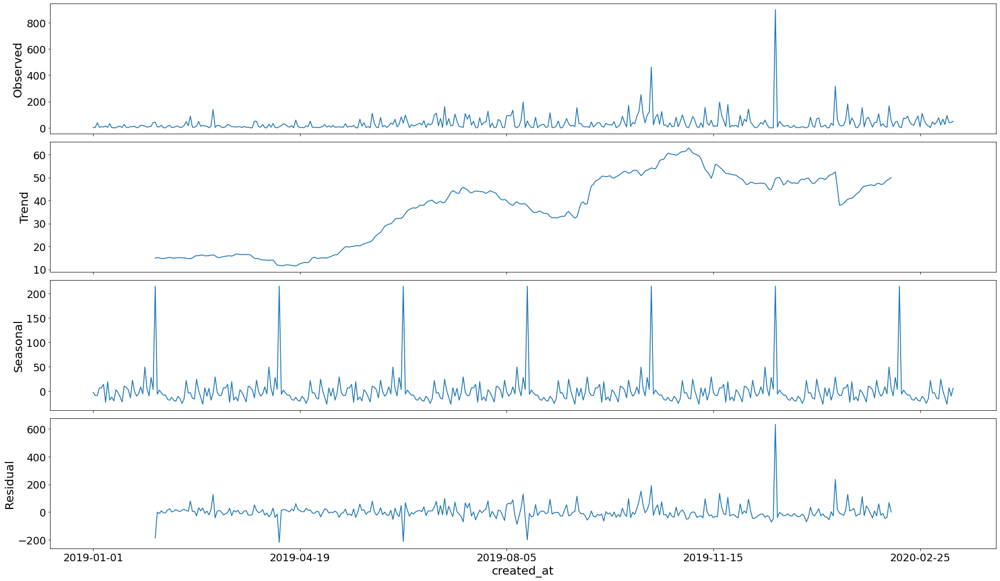

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4740.82215263666
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4597.859866946124
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4777.017896991392
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4405.285336068621
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4601.854347816103
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4534.485897423601
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4558.943134987072
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4406.79869081618
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4710.073378453183
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4577.376969173958
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4767.871436022384
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4396.774679798291
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4595.103262455968
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4526.152133359183
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4560.927070577987
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4398.229229962419
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4884.321094616542
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4754.697258962988
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0074      0.052      0.143      0.886      -0.094       0.109
ma.L1         -1.0000     19.033     -0.053      0.958     -38.304      36.304
ar.S.L12      -0.4766      0.012    -39.630      0.000      -0.500      -0.453
sigma2      6354.9269   1.21e+05      0.053      0.958   -2.31e+05    2.43e+05


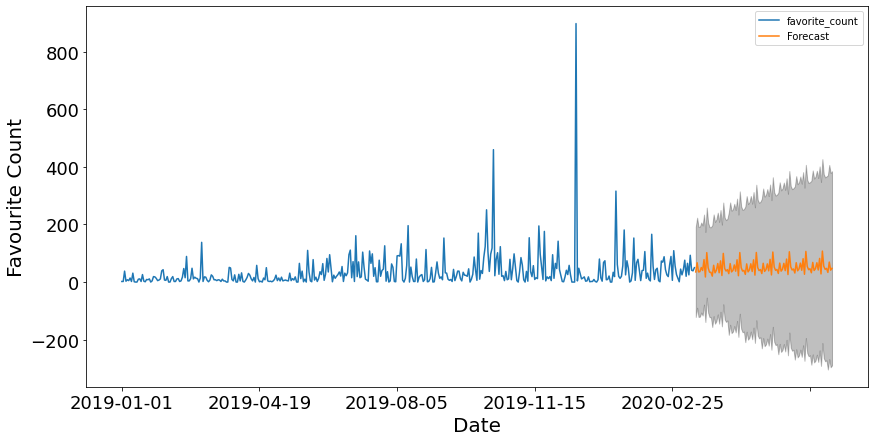

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets

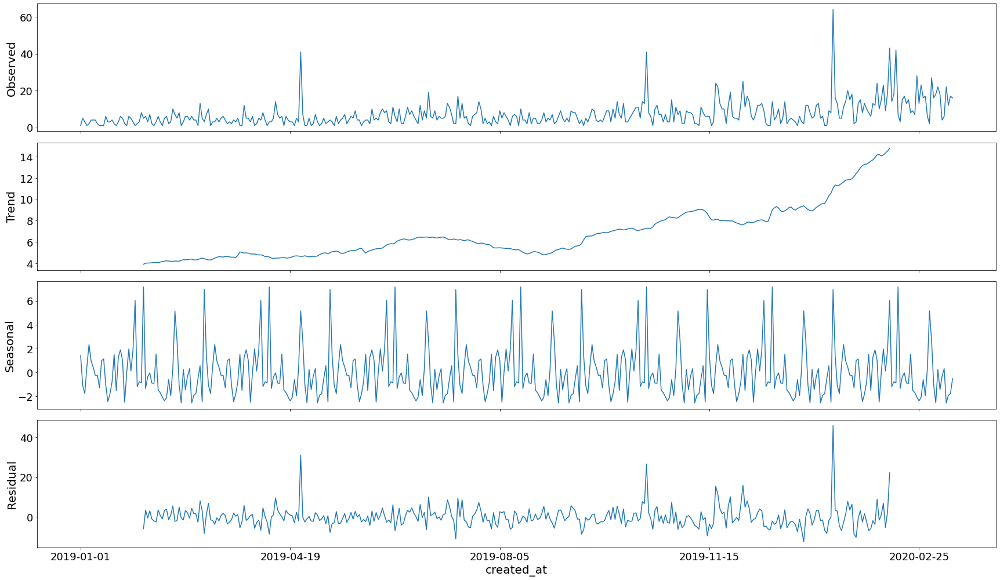

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3079.6138569882946
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:2886.59752948852
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2851.0897968911095
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2601.4076324366515
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2795.702967617962
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2657.996182236874
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2696.813044272002
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2603.407632808029
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2929.3822262557487
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2803.228919805516
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2841.0343868370946
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2583.3288666578346
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2770.463510812965
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2645.5003978751447
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2686.372337169759
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2585.3284982947944
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2881.976997668902
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2811.61984426517
ARIM

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1807      0.047      3.873      0.000       0.089       0.272
ma.L1         -1.0000      6.485     -0.154      0.877     -13.711      11.711
ar.S.L12      -0.4849      0.025    -19.763      0.000      -0.533      -0.437
sigma2        53.6239    347.973      0.154      0.878    -628.391     735.638


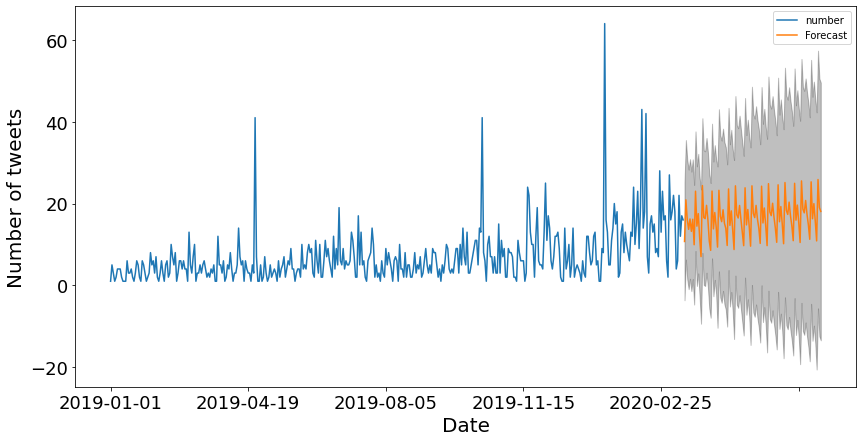

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## what happened

In [ ]:
Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_South_Food_Tweets_Trend['number'] = 1

Covid_Retweet_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

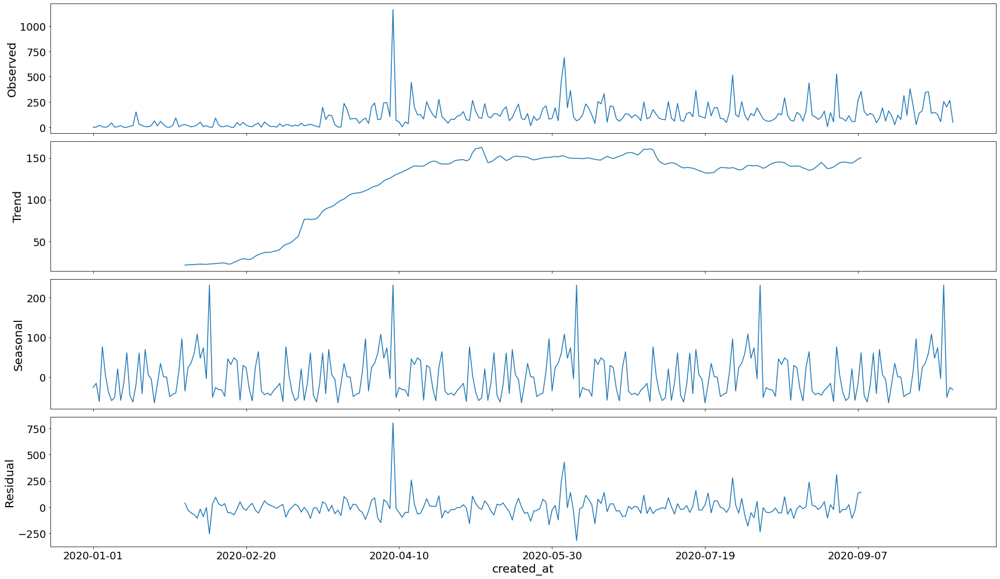

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


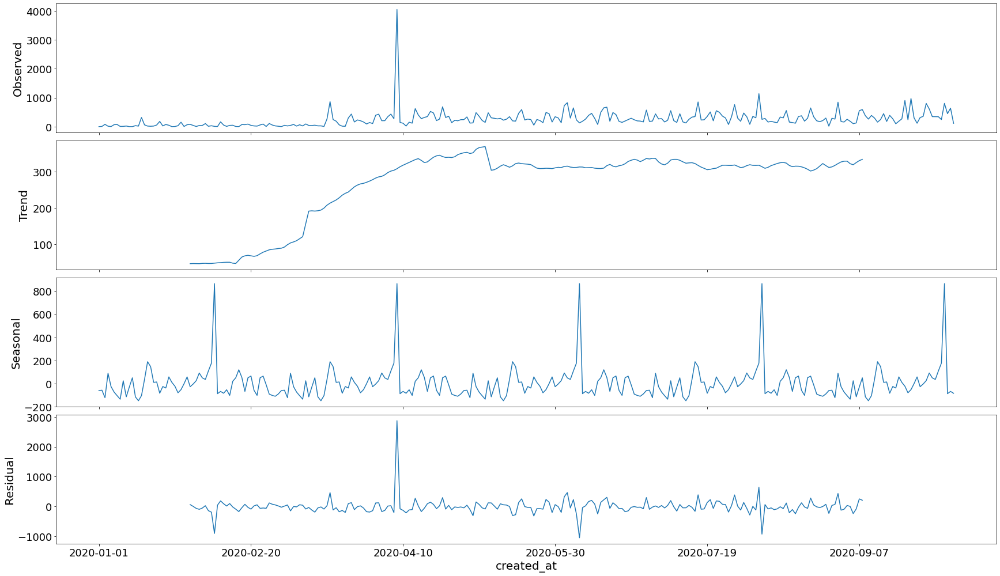

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of tweets

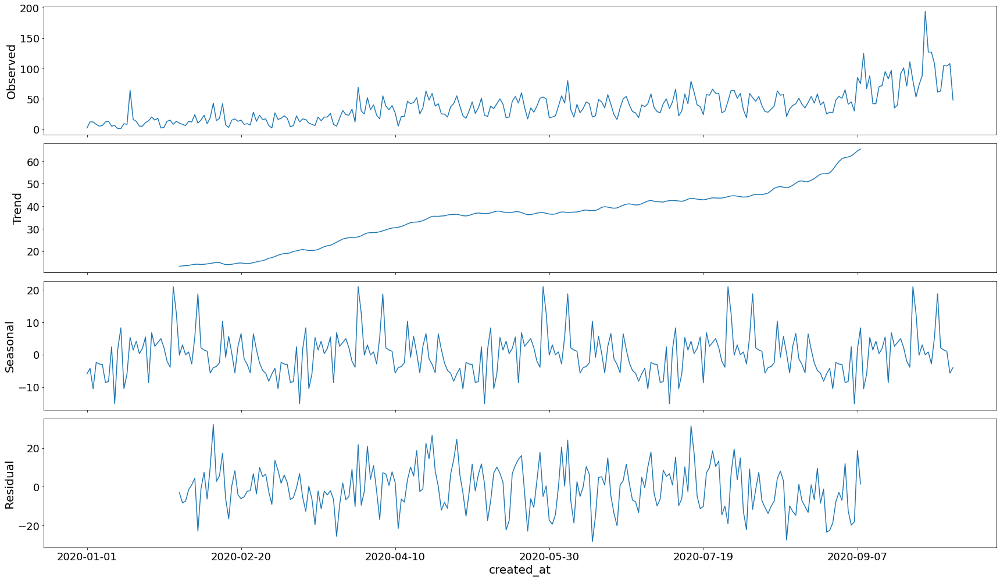

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

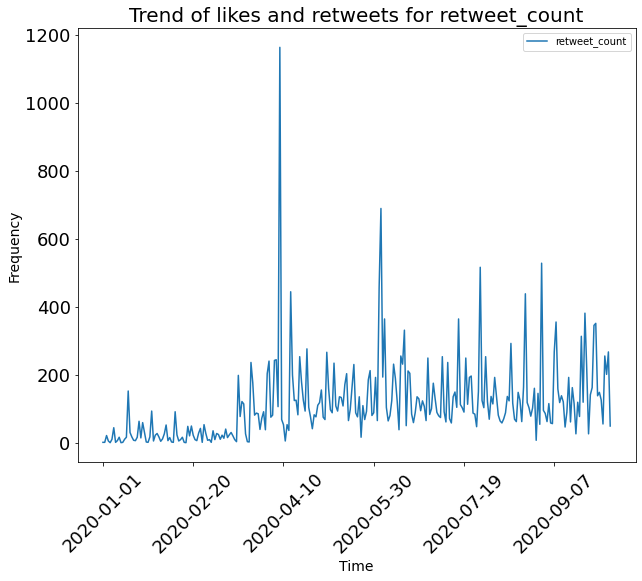

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'retweet_count')

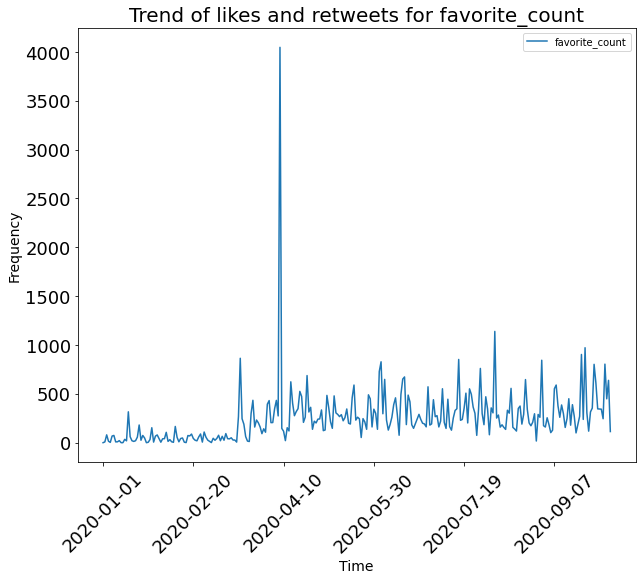

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'favorite_count')

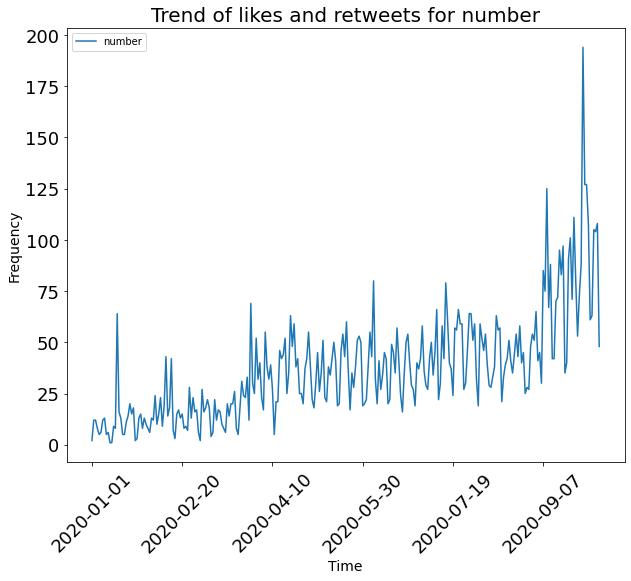

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'number')

### **Private**

In [ ]:
South_African_Food_Tweets = South_African_Category_Users[South_African_Category_Users['group'] >= 'private' ]

## Trend before Covid


In [ ]:
Pre_Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_South_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## retweets

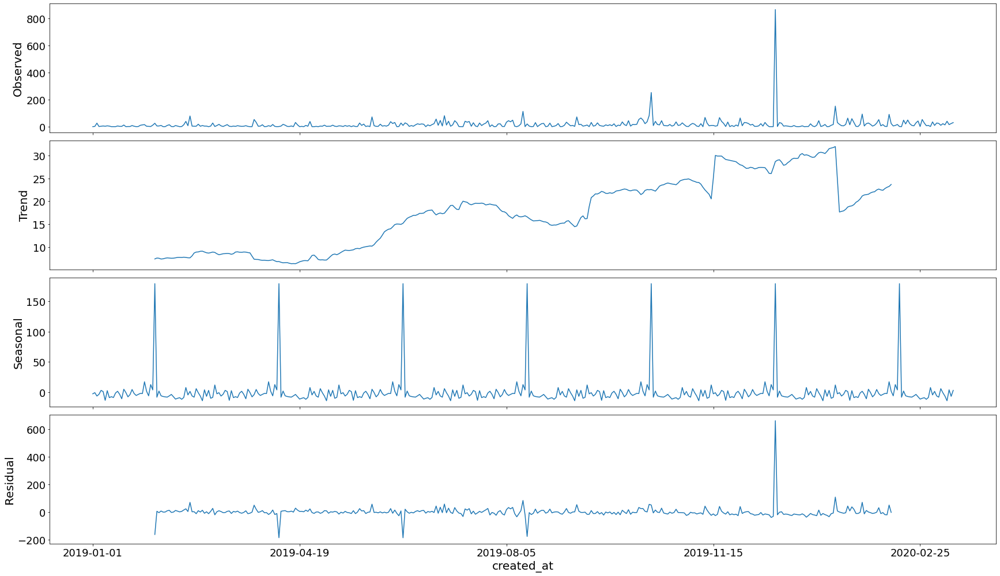

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_South_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4439.804404430596
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4321.610320694489
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4557.7962169447
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4182.126056729081
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4330.597481183428
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4306.821491053336
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4335.38920859188
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4183.707981256526
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4427.494903183039
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4310.558801183247
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4549.514086963411
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4174.409420603185
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4329.475069875314
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4299.185532910629
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4337.370648359914
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4175.951620068847
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4665.71072978095
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4544.271721793793
ARIMA(0, 1, 0)

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0081      0.092      0.088      0.930      -0.173       0.189
ma.L1         -1.0000     19.181     -0.052      0.958     -38.595      36.595
ar.S.L12      -0.4966      0.011    -46.604      0.000      -0.518      -0.476
sigma2      3598.7457   6.91e+04      0.052      0.958   -1.32e+05    1.39e+05


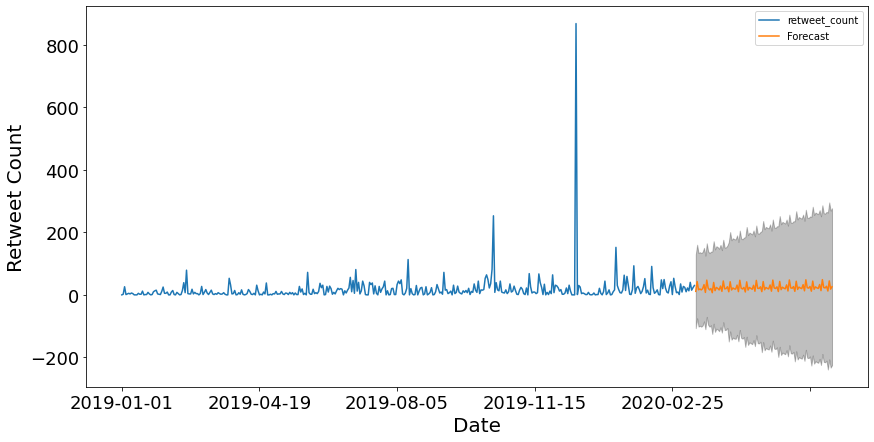

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

## Favorites

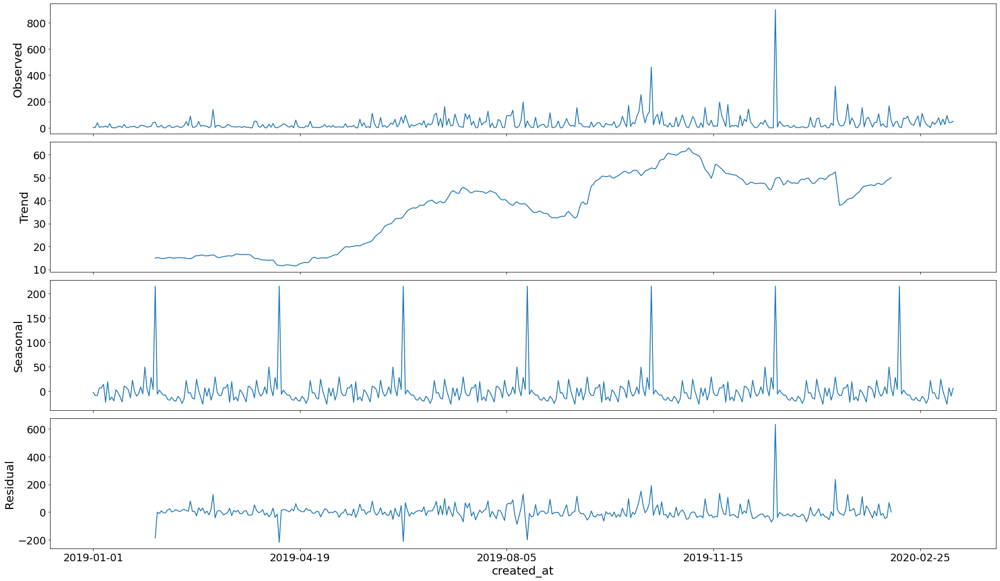

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4740.82215263666
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4597.859866946124
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4777.017896991392
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4405.285336068621
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4601.854347816103
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4534.485897423601
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4558.943134987072
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4406.79869081618
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4710.073378453183
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4577.376969173958
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4767.871436022384
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4396.774679798291
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4595.103262455968
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4526.152133359183
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4560.927070577987
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4398.229229962419
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4884.321094616542
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4754.697258962988
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0074      0.052      0.143      0.886      -0.094       0.109
ma.L1         -1.0000     19.033     -0.053      0.958     -38.304      36.304
ar.S.L12      -0.4766      0.012    -39.630      0.000      -0.500      -0.453
sigma2      6354.9269   1.21e+05      0.053      0.958   -2.31e+05    2.43e+05


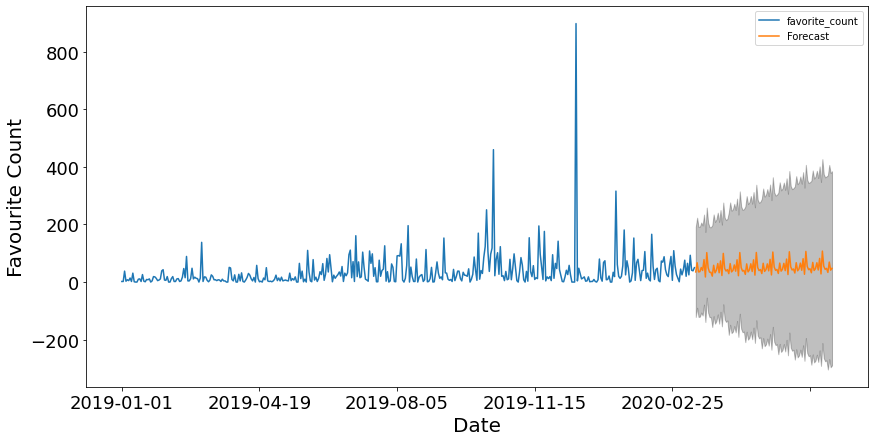

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets

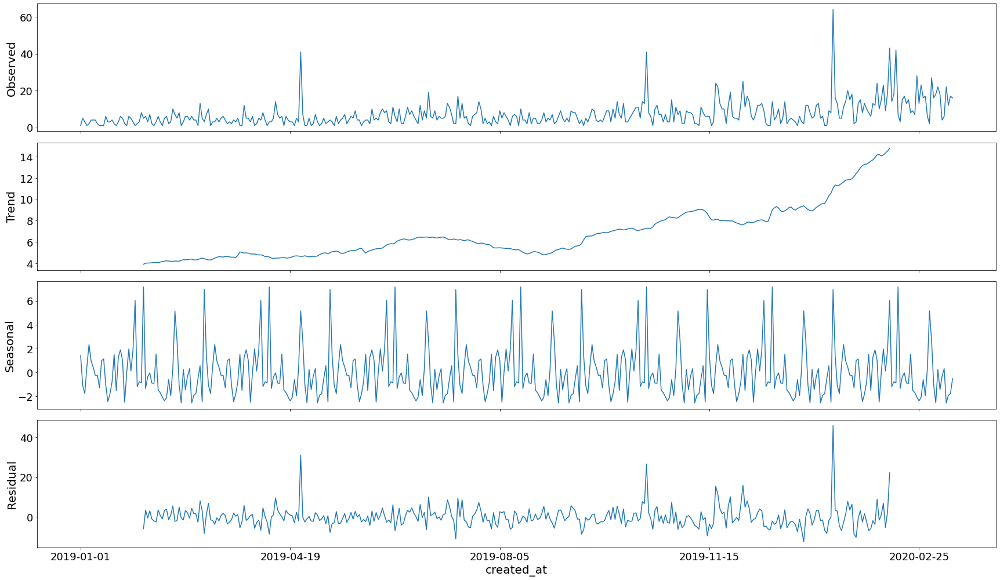

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3079.6138569882946
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:2886.59752948852
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2851.0897968911095
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2601.4076324366515
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2795.702967617962
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2657.996182236874
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2696.813044272002
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2603.407632808029
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2929.3822262557487
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2803.228919805516
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2841.0343868370946
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2583.3288666578346
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2770.463510812965
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2645.5003978751447
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2686.372337169759
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2585.3284982947944
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2881.976997668902
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2811.61984426517
ARIM

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1807      0.047      3.873      0.000       0.089       0.272
ma.L1         -1.0000      6.485     -0.154      0.877     -13.711      11.711
ar.S.L12      -0.4849      0.025    -19.763      0.000      -0.533      -0.437
sigma2        53.6239    347.973      0.154      0.878    -628.391     735.638


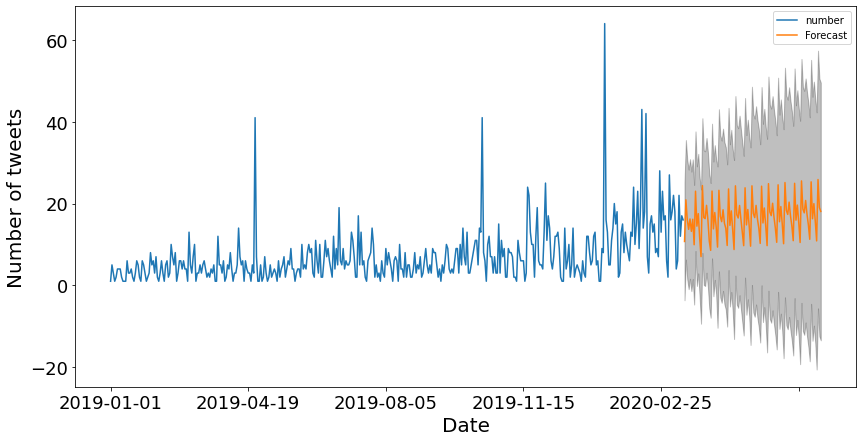

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## what happened

In [ ]:
Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_South_Food_Tweets_Trend['number'] = 1

Covid_Retweet_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

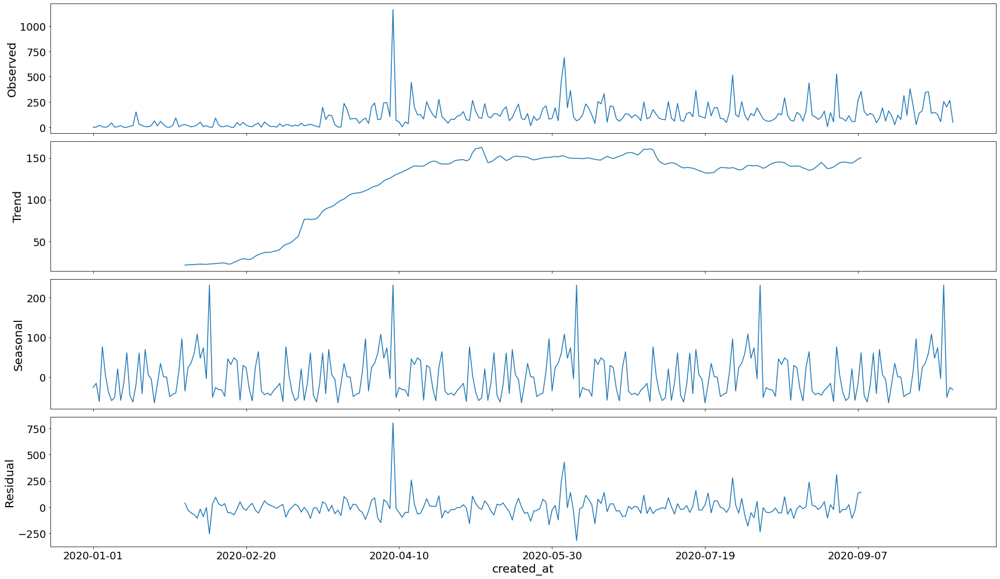

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


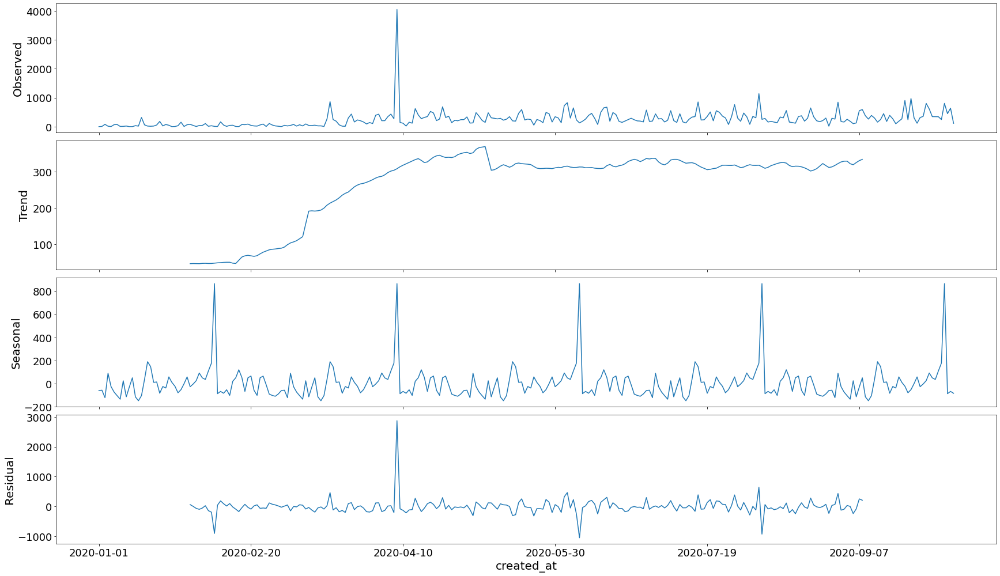

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of tweets

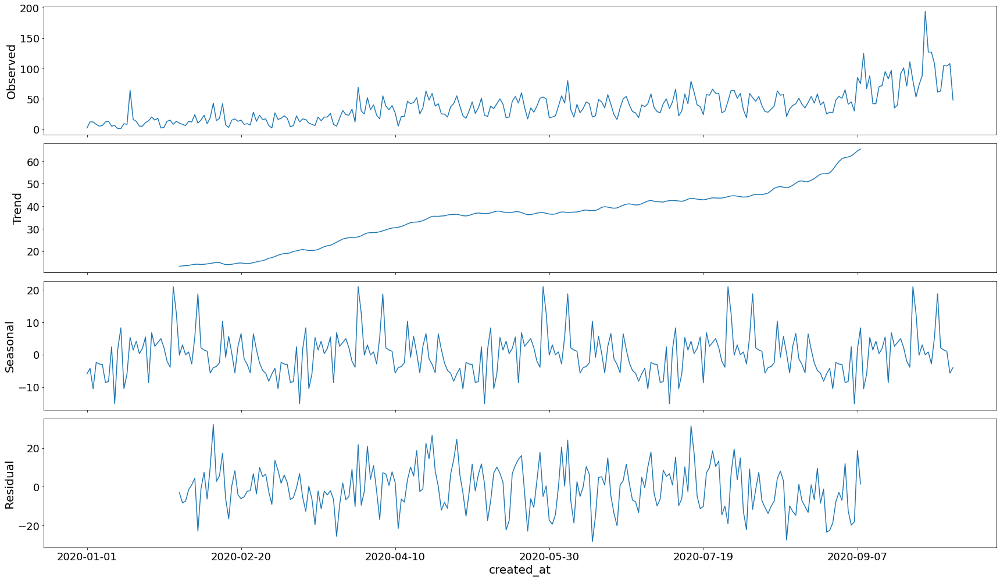

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

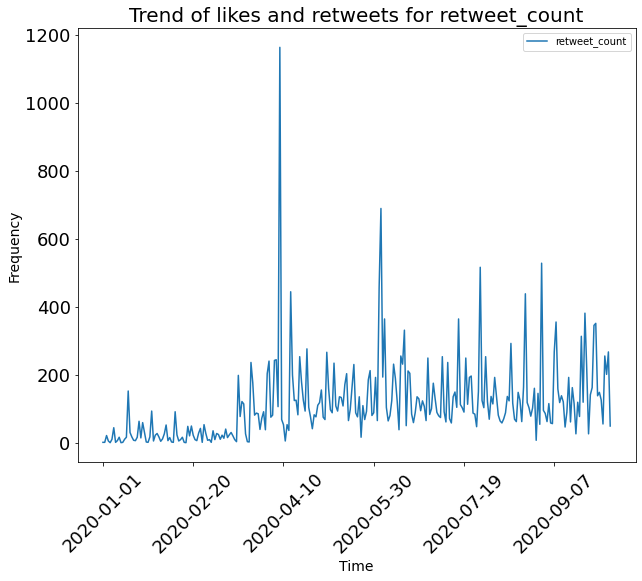

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'retweet_count')

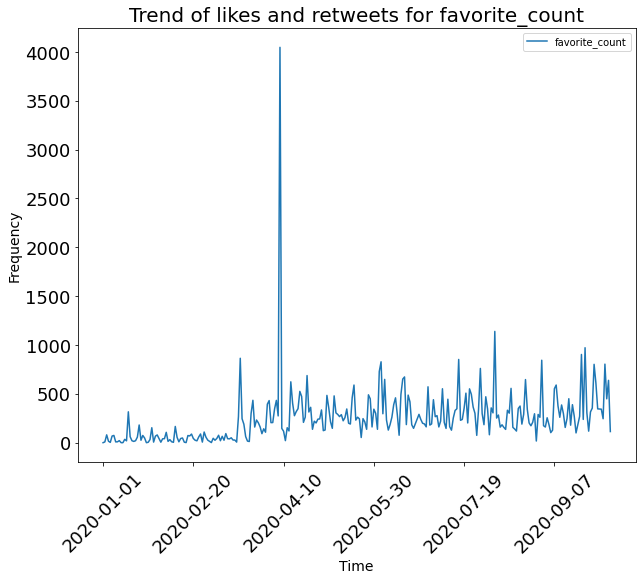

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'favorite_count')

### **NGOs**

In [ ]:
South_African_Food_Tweets = South_African_Category_Users[South_African_Category_Users['group'] >= 'NGO' ]

## Trend before Covid


In [ ]:
Pre_Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_South_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## retweets

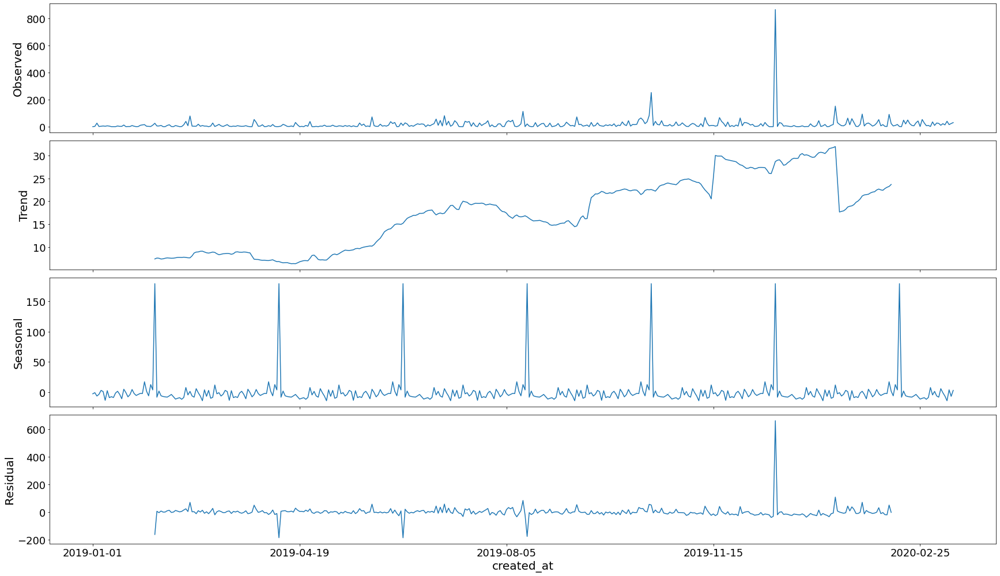

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_South_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4439.804404430596
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4321.610320694489
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4557.7962169447
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4182.126056729081
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4330.597481183428
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4306.821491053336
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4335.38920859188
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4183.707981256526
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4427.494903183039
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4310.558801183247
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4549.514086963411
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4174.409420603185
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4329.475069875314
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4299.185532910629
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4337.370648359914
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4175.951620068847
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4665.71072978095
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4544.271721793793
ARIMA(0, 1, 0)

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0081      0.092      0.088      0.930      -0.173       0.189
ma.L1         -1.0000     19.181     -0.052      0.958     -38.595      36.595
ar.S.L12      -0.4966      0.011    -46.604      0.000      -0.518      -0.476
sigma2      3598.7457   6.91e+04      0.052      0.958   -1.32e+05    1.39e+05


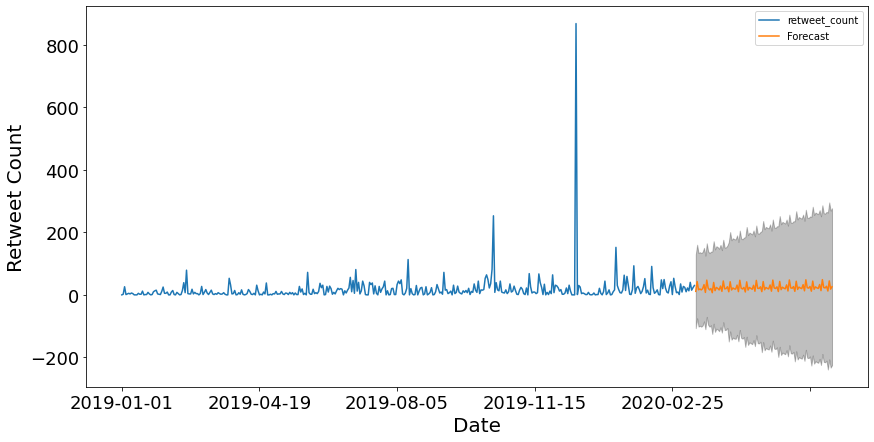

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

## Favorites

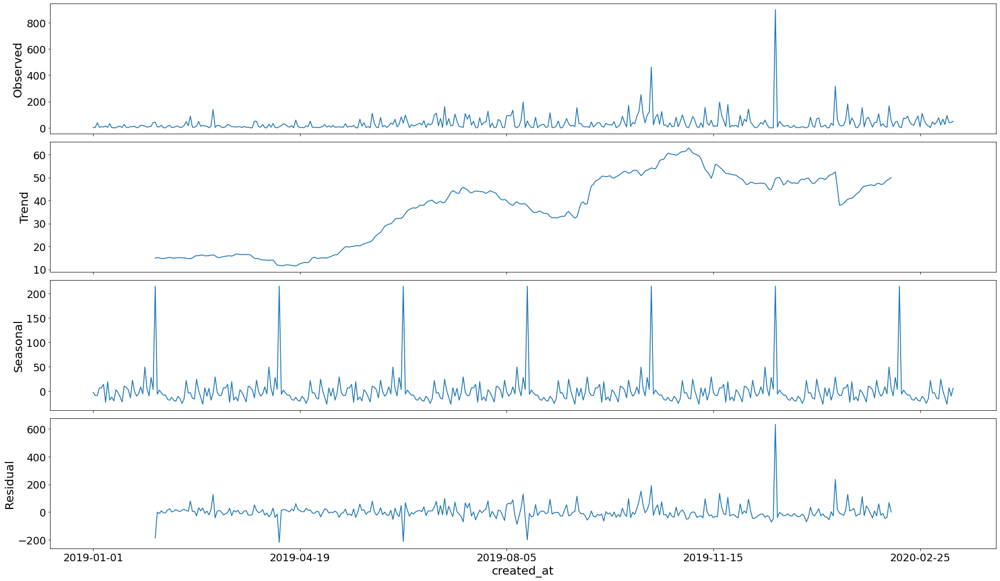

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4740.82215263666
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4597.859866946124
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4777.017896991392
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4405.285336068621
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4601.854347816103
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4534.485897423601
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4558.943134987072
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4406.79869081618
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4710.073378453183
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4577.376969173958
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4767.871436022384
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4396.774679798291
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4595.103262455968
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4526.152133359183
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4560.927070577987
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4398.229229962419
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4884.321094616542
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4754.697258962988
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0074      0.052      0.143      0.886      -0.094       0.109
ma.L1         -1.0000     19.033     -0.053      0.958     -38.304      36.304
ar.S.L12      -0.4766      0.012    -39.630      0.000      -0.500      -0.453
sigma2      6354.9269   1.21e+05      0.053      0.958   -2.31e+05    2.43e+05


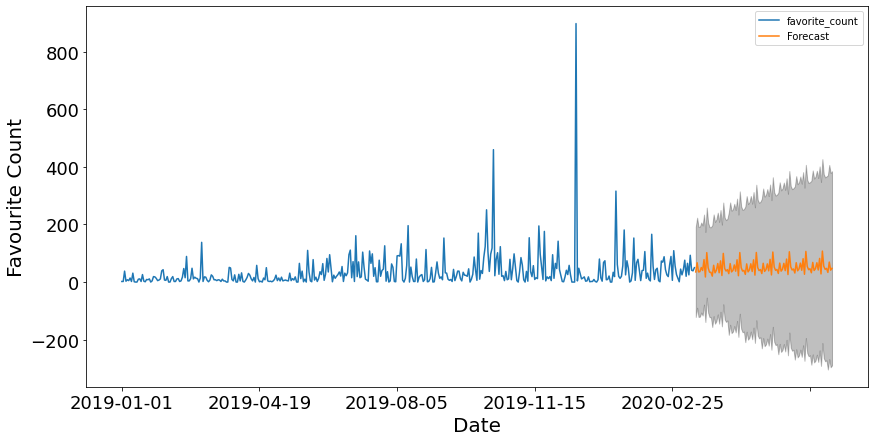

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets

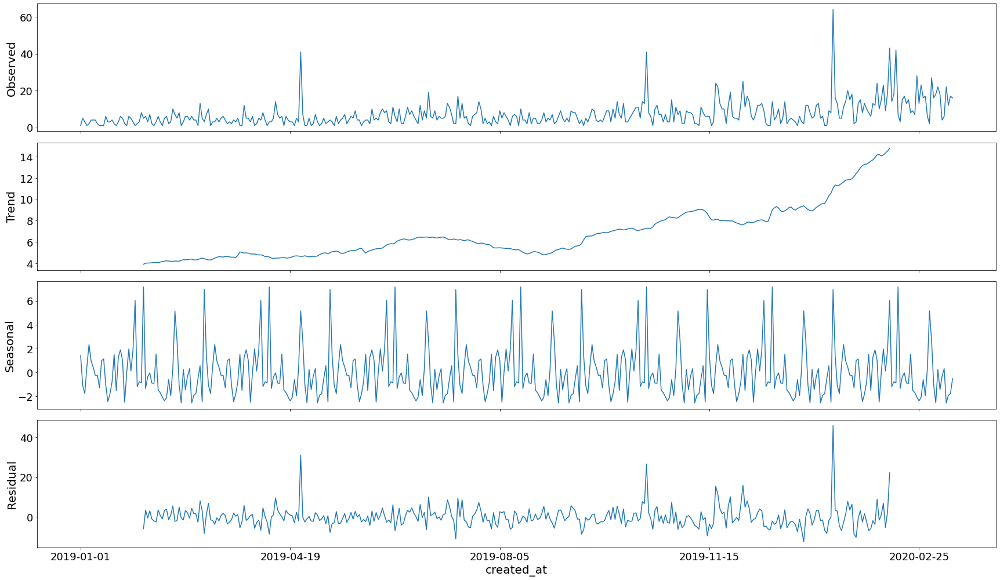

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3079.6138569882946
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:2886.59752948852
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2851.0897968911095
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2601.4076324366515
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2795.702967617962
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2657.996182236874
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2696.813044272002
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2603.407632808029
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2929.3822262557487
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2803.228919805516
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2841.0343868370946
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2583.3288666578346
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2770.463510812965
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2645.5003978751447
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2686.372337169759
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2585.3284982947944
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2881.976997668902
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2811.61984426517
ARIM

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1807      0.047      3.873      0.000       0.089       0.272
ma.L1         -1.0000      6.485     -0.154      0.877     -13.711      11.711
ar.S.L12      -0.4849      0.025    -19.763      0.000      -0.533      -0.437
sigma2        53.6239    347.973      0.154      0.878    -628.391     735.638


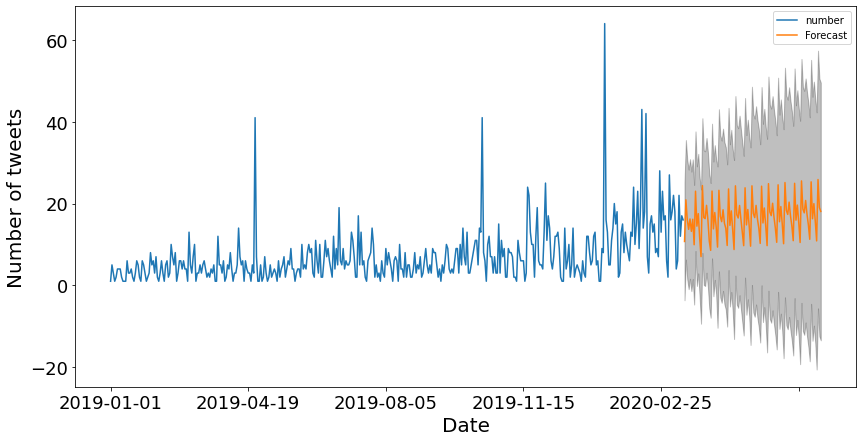

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## what happened

In [ ]:
Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_South_Food_Tweets_Trend['number'] = 1

Covid_Retweet_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

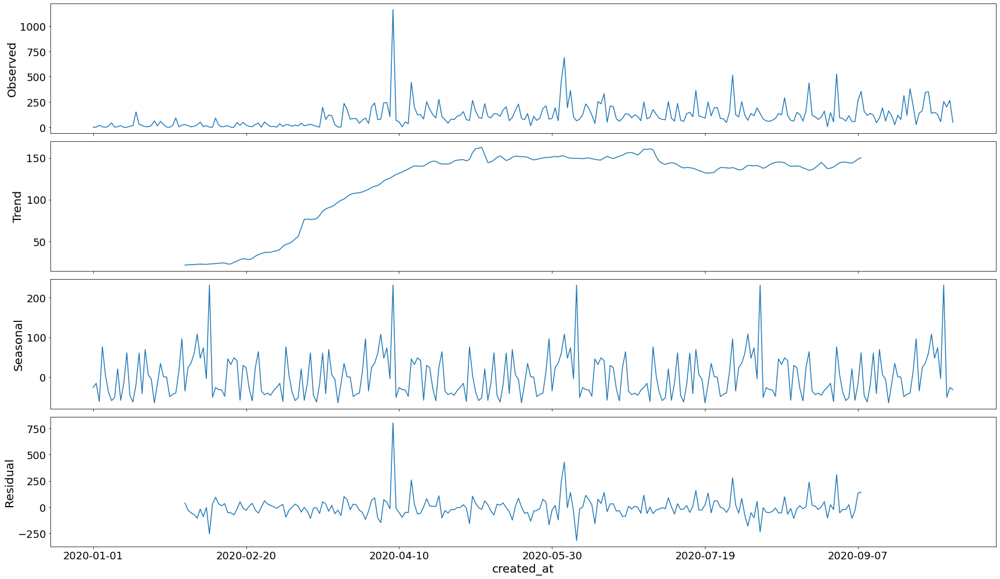

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


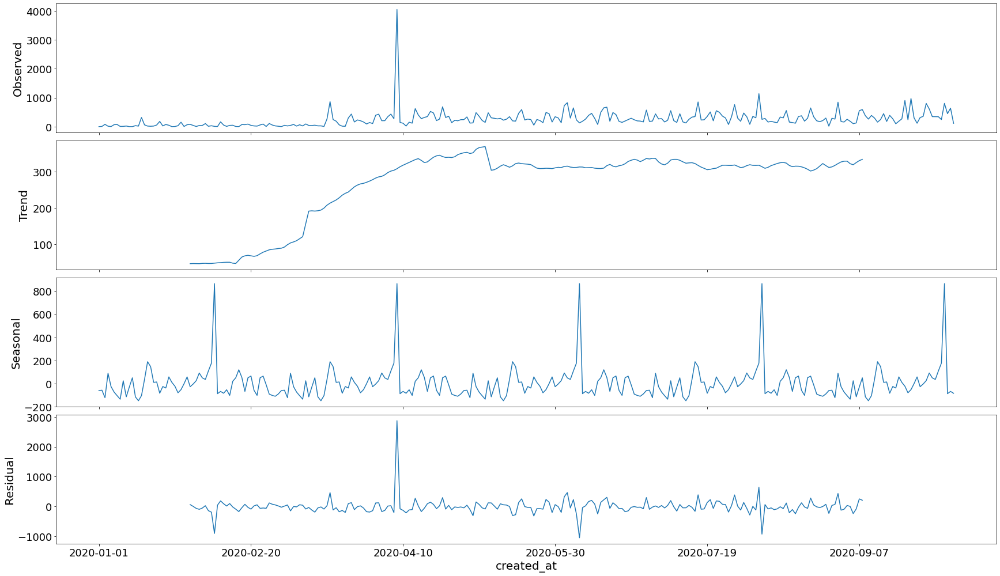

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of tweets

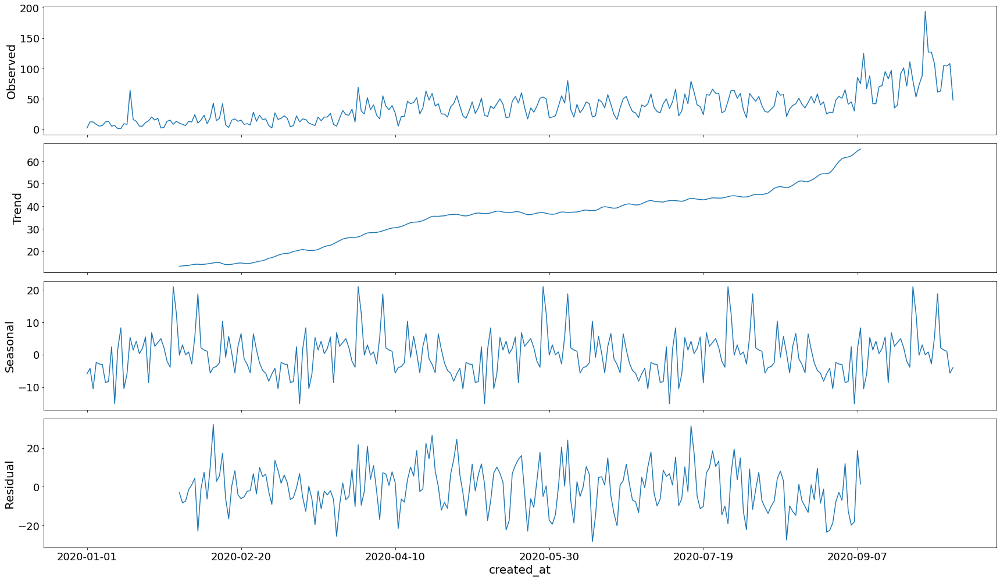

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

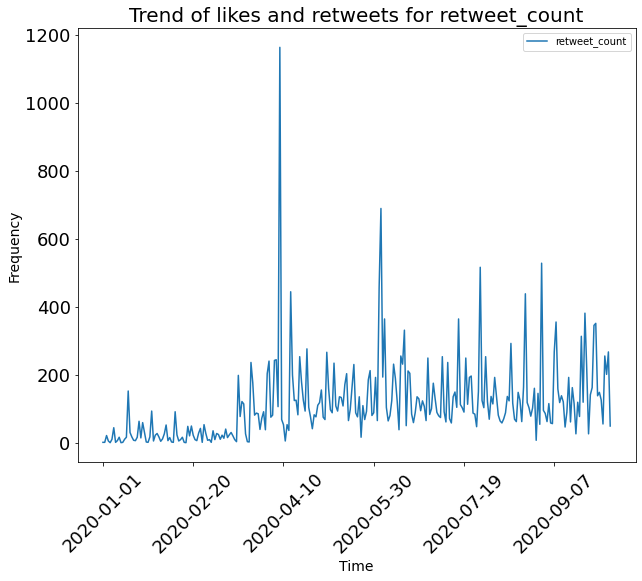

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'retweet_count')

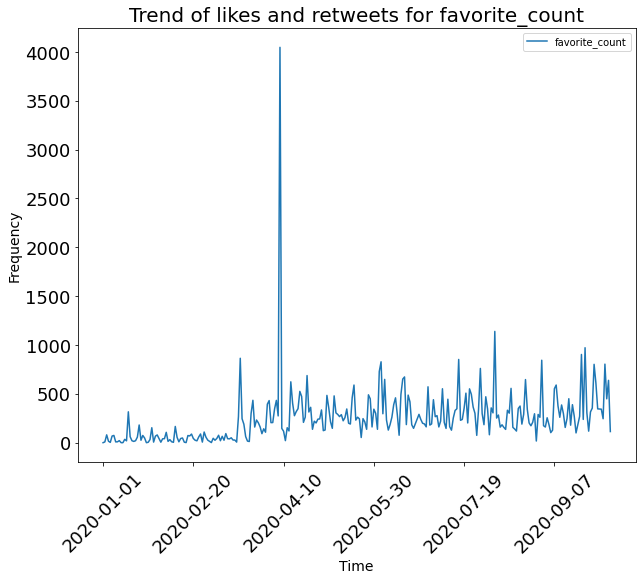

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'favorite_count')

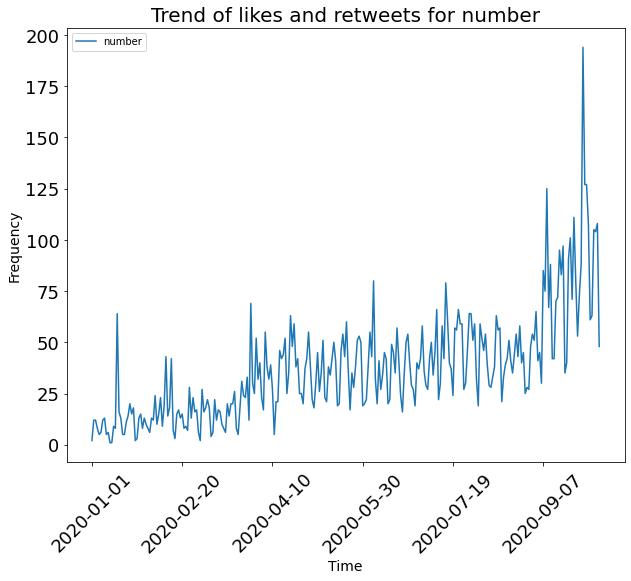

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'number')

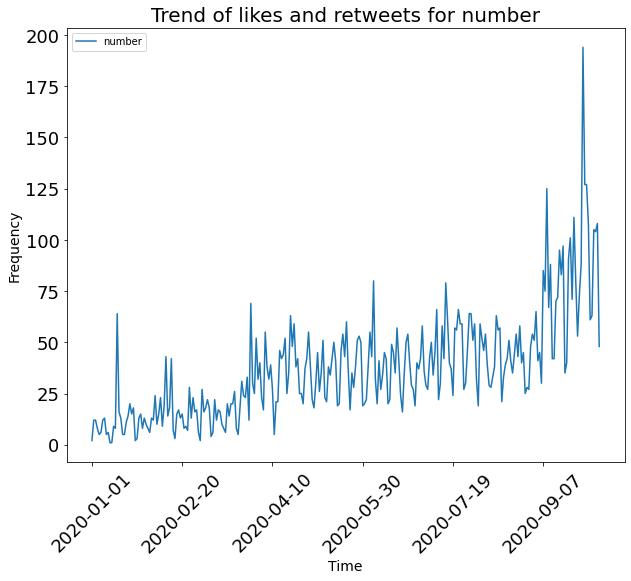

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'number')

### **Government**

In [ ]:
South_African_Food_Tweets = South_African_Category_Users[South_African_Category_Users['group'] >= 'government' ]

## Trend before Covid


In [ ]:
Pre_Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] <= '2020-03-12' ]
Pre_Covid_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Pre_Covid_South_Food_Tweets_Trend['number'] = 1

Pre_Covid_Retweet_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Pre_Covid_Favourite_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Pre_Covid_Number_South_Food_Tweets_Trend = Pre_Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## retweets

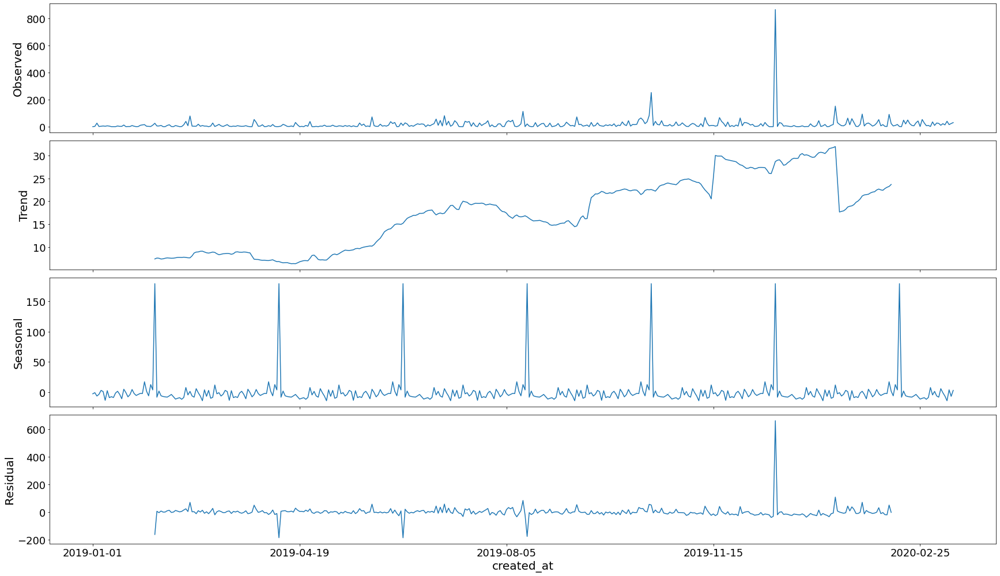

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Retweet_South_Food_Tweets_Trend, model='additive', freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4439.804404430596
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4321.610320694489
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4557.7962169447
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4182.126056729081
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4330.597481183428
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4306.821491053336
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4335.38920859188
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4183.707981256526
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4427.494903183039
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4310.558801183247
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4549.514086963411
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4174.409420603185
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4329.475069875314
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4299.185532910629
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4337.370648359914
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4175.951620068847
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4665.71072978095
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4544.271721793793
ARIMA(0, 1, 0)

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Retweet_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0081      0.092      0.088      0.930      -0.173       0.189
ma.L1         -1.0000     19.181     -0.052      0.958     -38.595      36.595
ar.S.L12      -0.4966      0.011    -46.604      0.000      -0.518      -0.476
sigma2      3598.7457   6.91e+04      0.052      0.958   -1.32e+05    1.39e+05


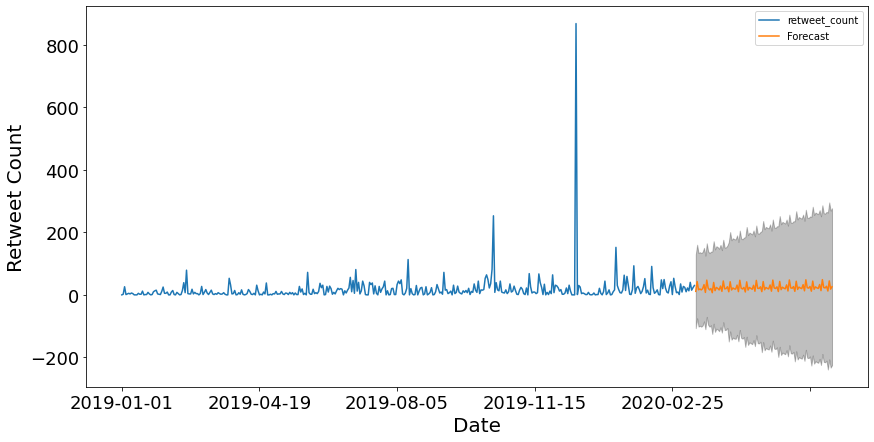

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Retweet_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Retweet Count')

plt.legend()
plt.show()

## Favorites

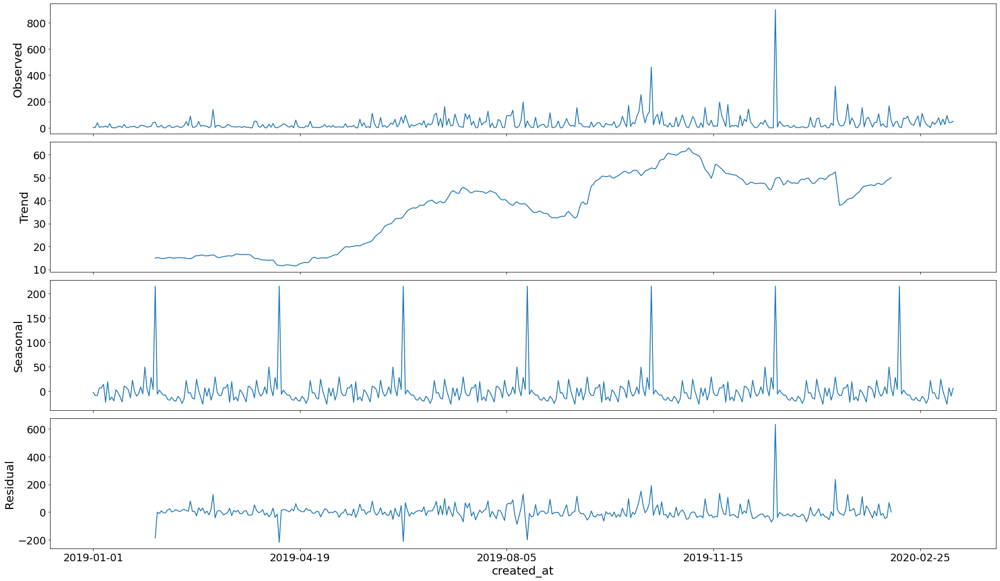

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:4740.82215263666
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:4597.859866946124
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:4777.017896991392
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:4405.285336068621
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:4601.854347816103
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:4534.485897423601
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:4558.943134987072
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:4406.79869081618
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:4710.073378453183
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4577.376969173958
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:4767.871436022384
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:4396.774679798291
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:4595.103262455968
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4526.152133359183
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:4560.927070577987
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:4398.229229962419
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:4884.321094616542
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:4754.697258962988
ARIMA(0, 1, 

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Favourite_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0074      0.052      0.143      0.886      -0.094       0.109
ma.L1         -1.0000     19.033     -0.053      0.958     -38.304      36.304
ar.S.L12      -0.4766      0.012    -39.630      0.000      -0.500      -0.453
sigma2      6354.9269   1.21e+05      0.053      0.958   -2.31e+05    2.43e+05


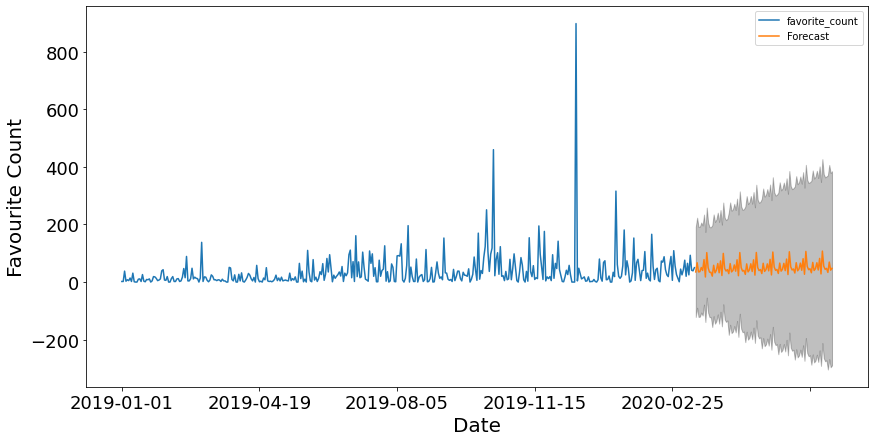

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Favourite_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Favourite Count')

plt.legend()
plt.show()

## Frequency of tweets

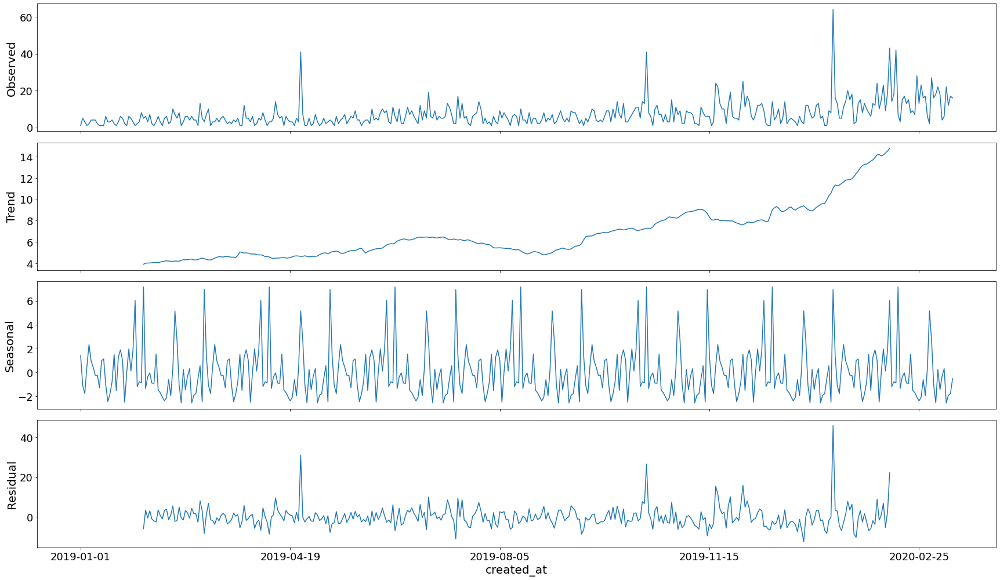

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Pre_Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:3079.6138569882946
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:2886.59752948852
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:2851.0897968911095
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:2601.4076324366515
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:2795.702967617962
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:2657.996182236874
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:2696.813044272002
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:2603.407632808029
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2929.3822262557487
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2803.228919805516
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:2841.0343868370946
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2583.3288666578346
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:2770.463510812965
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:2645.5003978751447
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:2686.372337169759
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:2585.3284982947944
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:2881.976997668902
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:2811.61984426517
ARIM

In [ ]:
mod = sm.tsa.statespace.SARIMAX(Pre_Covid_Number_South_Food_Tweets_Trend,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1807      0.047      3.873      0.000       0.089       0.272
ma.L1         -1.0000      6.485     -0.154      0.877     -13.711      11.711
ar.S.L12      -0.4849      0.025    -19.763      0.000      -0.533      -0.437
sigma2        53.6239    347.973      0.154      0.878    -628.391     735.638


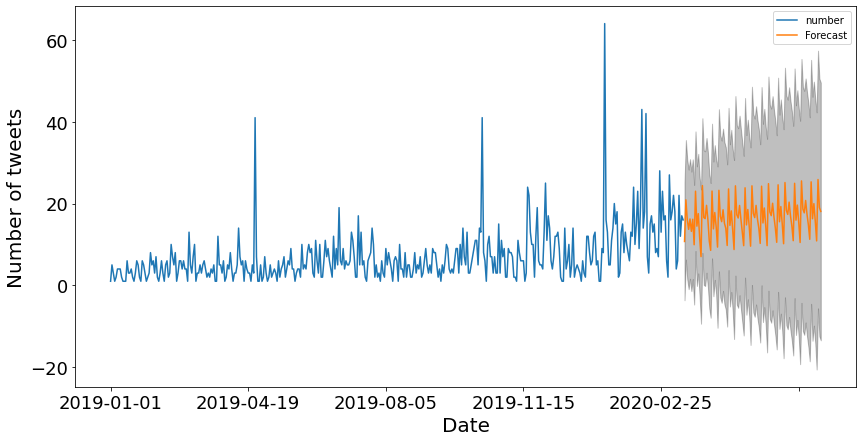

In [ ]:
pred_uc = results.get_forecast(steps=100)
pred_ci = pred_uc.conf_int()

ax = Pre_Covid_Number_South_Food_Tweets_Trend.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Date')
ax.set_ylabel('Number of tweets')

plt.legend()
plt.show()

## what happened

In [ ]:
Covid_South_Food_Tweets_Trend = South_Food_Tweets[South_Food_Tweets['created_at'] >= '2020-01-01' ]
Covid_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.set_index('created_at').sort_values(by=['created_at'], ascending=False)
Covid_South_Food_Tweets_Trend['number'] = 1

Covid_Retweet_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['retweet_count']].sum()
Covid_Favourite_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['favorite_count']].sum()
Covid_Number_South_Food_Tweets_Trend = Covid_South_Food_Tweets_Trend.groupby('created_at')[['number']].sum()

## Retweets

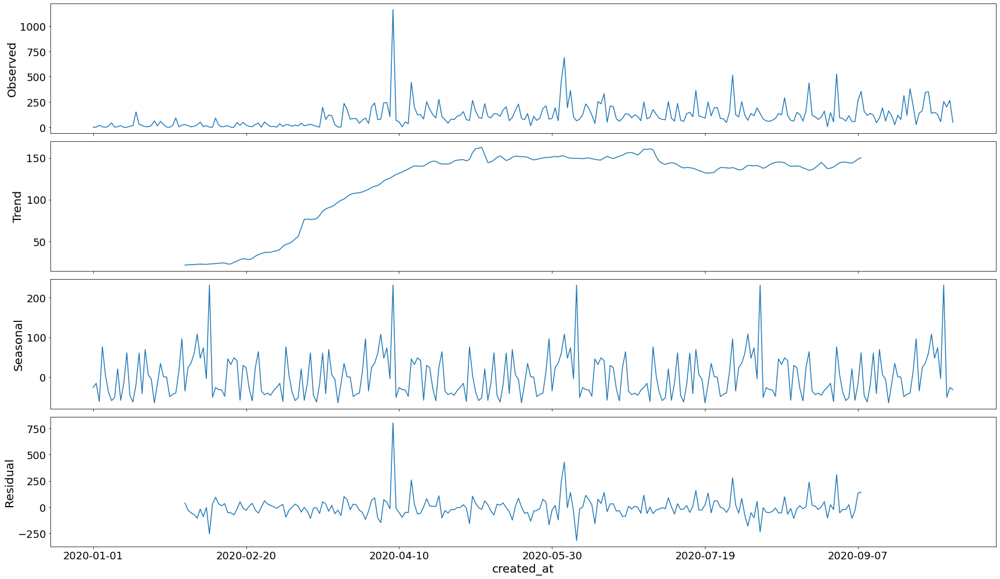

In [ ]:
#Retweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Retweet_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Favorites


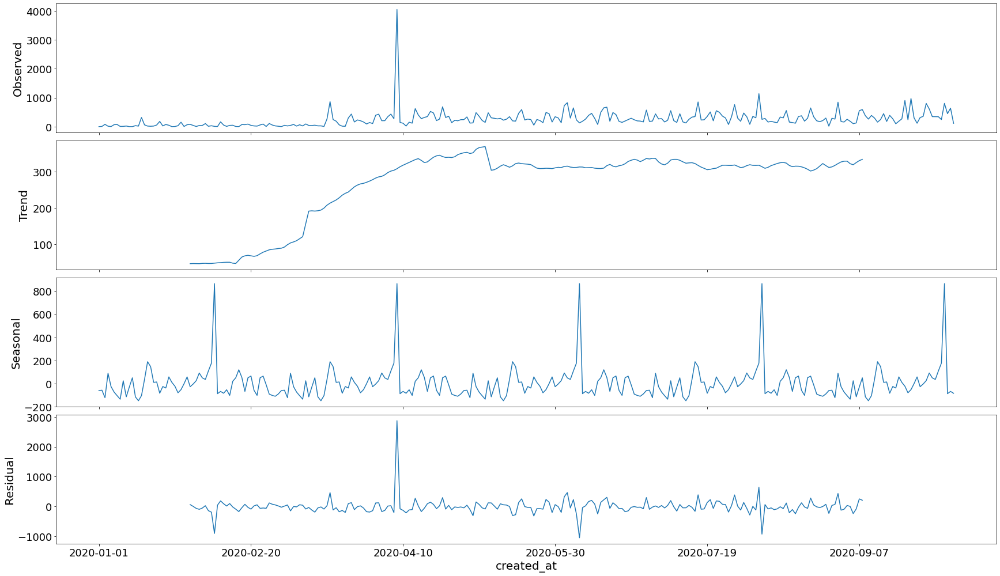

In [ ]:
#Favourites
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Favourite_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

## Frequency of tweets

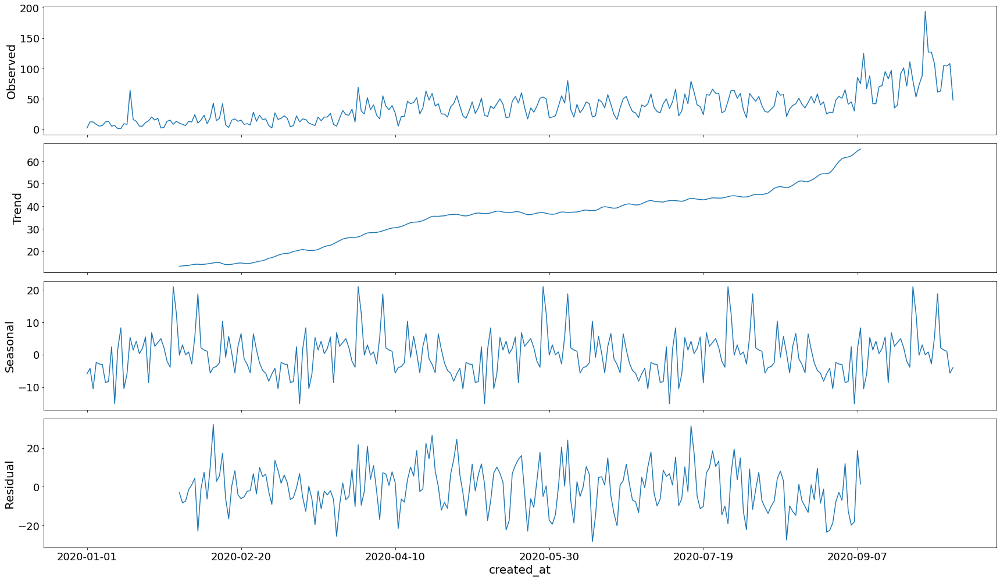

In [ ]:
#Frequency of Tweets
rcParams['figure.figsize'] = 24, 14

decomposition = sm.tsa.seasonal_decompose(Covid_Number_South_Food_Tweets_Trend, model='additive',freq = 60)
fig = decomposition.plot()
plt.show()

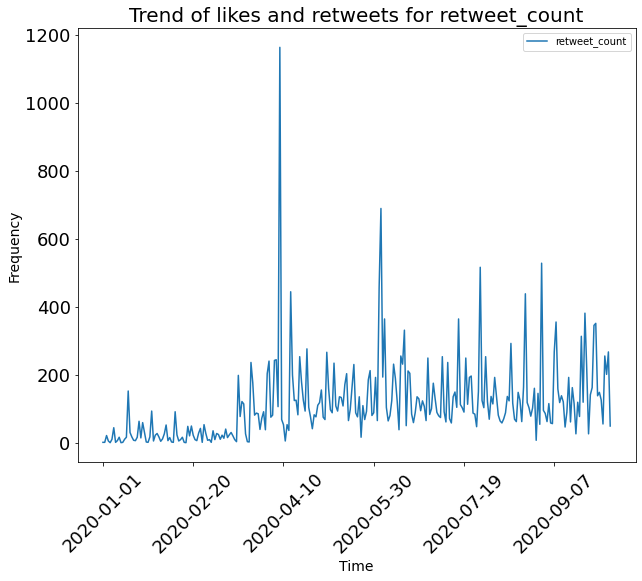

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'retweet_count')

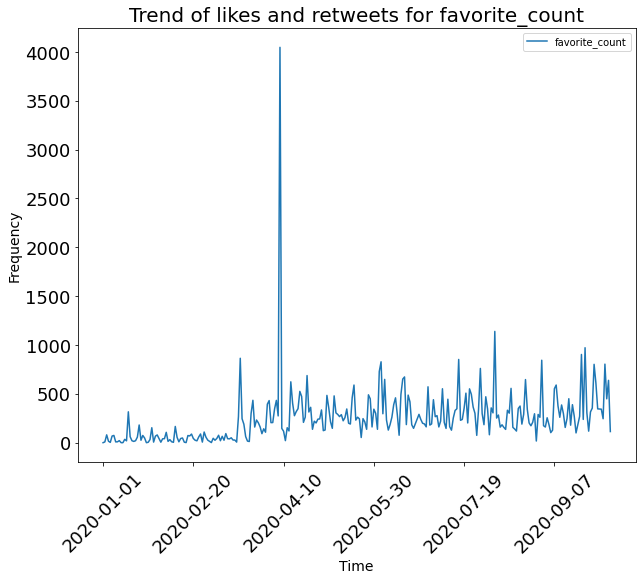

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'favorite_count')

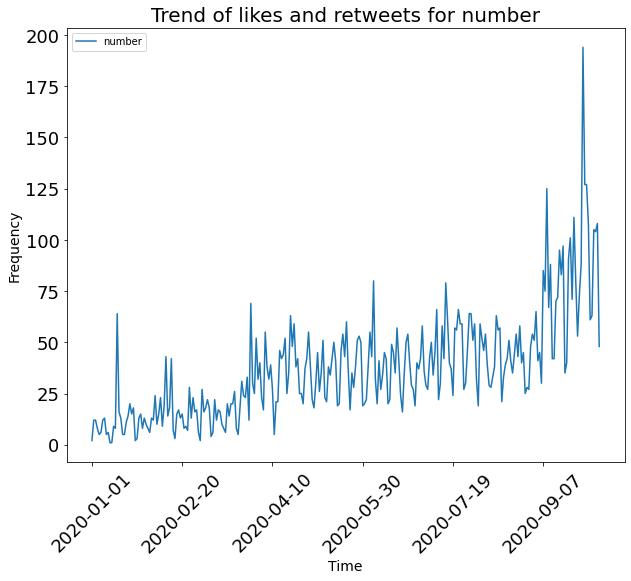

In [ ]:
Auto.Time_Trend(Covid_South_Food_Tweets_Trend, 'number')

### Kenya User Sentiment Analysis

In [ ]:
Kenyan_Users.head()

,Unnamed: 0,original_author,group
0,0,Kul_kay,general
1,1,Kul_kay,general
2,2,Kul_kay,general
3,3,Kul_kay,general
4,4,Kul_kay,general


In [ ]:
Kenyan_Users = Kenyan_Users.drop('Unnamed: 0', axis=1)

In [ ]:
kenyan_food = pd.read_csv('/content/drive/My Drive/Copy of Kenyan Food Tweets.csv')
kenyan_food.head(1)

,Unnamed: 0,timestamp,created_at,source,original_text,clean_text,sentiment,polarity,subjectivity,lang,favorite_count,retweet_count,original_author,possibly_sensitive,hashtags,user_mentions,place,place_coord_boundaries,number
0,659,2020-07-08 11:46:39+00:00,2020-07-08,"<a href=""http://twitter.com/download/android"" ...",@niiteevanso Whatever puts food on your table....,Whatever puts food table Do,"Sentiment(polarity=0.0, subjectivity=0.0)",0.0,0.0,en,0,0,Kenrezzy,NaN,NaN,niiteevanso,NaN,NaN,1


In [ ]:
Kenyan_Users['original_author'].value_counts()

_Health_Recipes                                    6222
orutwasam                                          5928
Thapelo_mothae                                     5620
NJotwoma                                           4482
BeauxArtsprives                                    3646
                                                   ... 
eqpaho                                                1
KarituKingori                                         1
timonjagi, tegemeoorg                                 1
Nichonasri, lellowneemo, nyakena, JuliohWachira       1
ELCAPI67000974                                        1
Name: original_author, Length: 631, dtype: int64

In [ ]:
kenyan_food['original_author'].value_counts()

CovidFoodFuture    2630
_Health_Recipes     931
SIANIAgri           551
TimothyAWise        398
GlobalFarmerNet     397
                   ... 
iamloabowa            1
King_Ndegwa           1
its_brianKE           1
ValentineWatrin       1
Rono_Kenya            1
Name: original_author, Length: 463, dtype: int64

In [ ]:
len(Kenyan_Users['original_author'].isin(kenyan_food['original_author']))

634936

In [ ]:
merged = Kenyan_Users.merge(kenyan_food, how='right', on='original_author')
merged.shape

(32541128, 20)

In [ ]:
merged['group'].value_counts()

general       16393948
NGO            8299407
private        6489788
government     1349839
Name: group, dtype: int64

In [ ]:
# merged_general = merged[merged['group'] ==  'government']
merged_general.shape

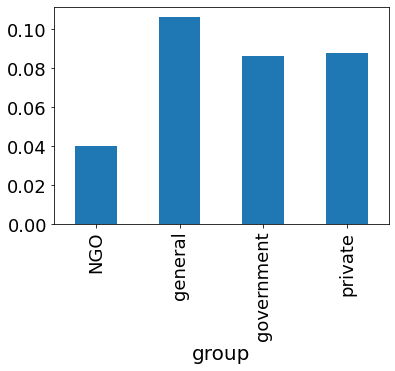

In [ ]:
merged.groupby('group')['polarity'].mean().plot(kind='bar')

In [ ]:
merged['created_at'] = pd.to_datetime(merged['created_at'], errors='coerce')

In [ ]:
by_day_sentiment = merged.groupby([pd.Grouper(key='created_at', freq='D')]).mean()['polarity']

# by_day_sentiment.head()
by_day_sentiment.plot(figsize=(10, 7))
plt.title('Trend of Tweets Sentiments by Day')